#**ThinkDSP labs**
---
Непомнящий Матвей - группа 3530901/10101
---

# **lab 1 - Сигналы и звуки**
---

In [1]:
# Get thinkdsp.py

import os
import urllib.request

import spectro

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

In [2]:
# imports
import matplotlib.pyplot as plt
import thinkdsp
from thinkdsp import decorate, read_wave

In [12]:
lab1_path = os.path.join(os.getcwd(), 'lab 1')

if not os.path.exists(lab1_path):
    os.makedirs(lab1_path)

In [18]:
# Путь к файлу в папке lab1
file_path = os.path.join(lab1_path, '170255__dublie__trumpet.wav')

# URL для скачивания
url = 'https://github.com/AllenDowney/ThinkDSP/blob/master/code/170255__dublie__trumpet.wav'

# Скачайте файл, если он не существует
if not os.path.exists(file_path):
    urllib.request.urlretrieve(url, file_path)


## lab 1.2
---

Скачаем с [сайта](https://freesound.org/) образец звука и различными способами исследуем его.
Для удобной работы с сигналами здесь, и в дальнейших работах будем использовать
библиотеку thinkdsp.


Откроем [скаченный файл](https://freesound.org/people/violinsimma/sounds/429671/), нормализуем и выведем его на экран. Код, выполняющий эти действия представлен ниже (при его запуске будет выведена спектрограмма загруженного звукового файла):

In [20]:
wave = read_wave(file_path)
wave.make_audio()

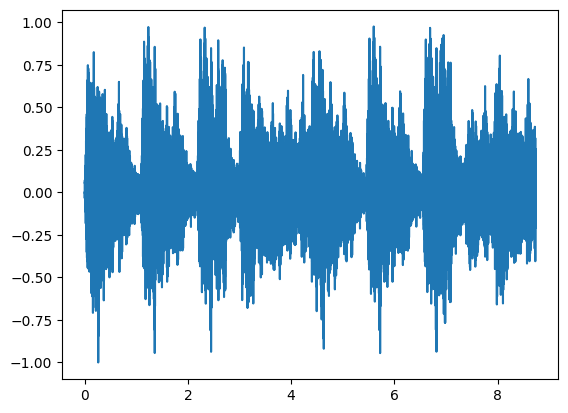

In [21]:
wave.plot()

Данный файл слишком большой, поэтому выделим из него отрезок длинной в пол секунды так, чтобы высота была примерно одинаковой на всём этом промежутке. Таким образом, рассмотрим сегмент от 40 до 40.5 секунд и распечатаем его спектрограмму с помощью кода ниже:

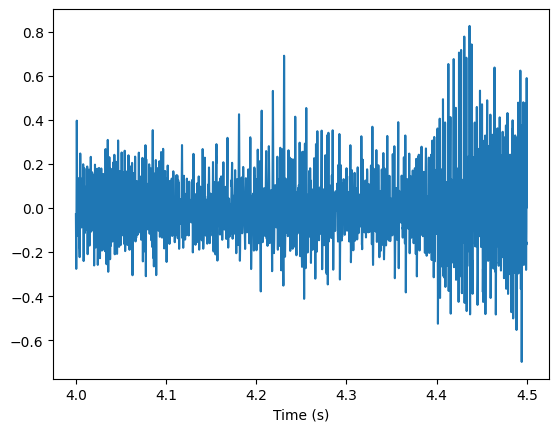

In [ ]:
segment = wave.segment(start=4.0, duration=0.5)
segment.plot()
plt.xlabel('Time (s)');

Разлоожим полученный сегмент в спектр и выведем на экран:

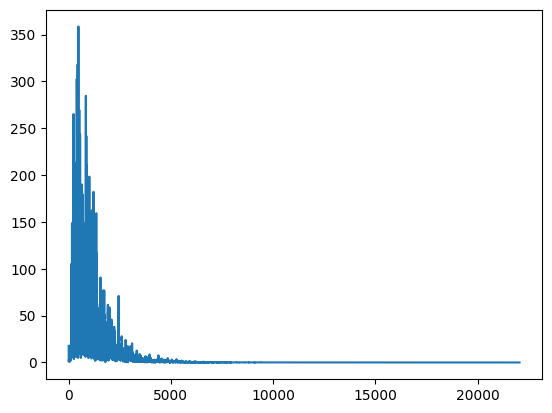

In [ ]:
spectrum = segment.make_spectrum()
spectrum.plot()

Заметим, что видимые изменения в спектрограмме можно наблюдать примерно до 10 кГц. После этого никаких скачков не возникает. Разложим сегмент в спектр повторно, ограничив частоту до 10 кГц

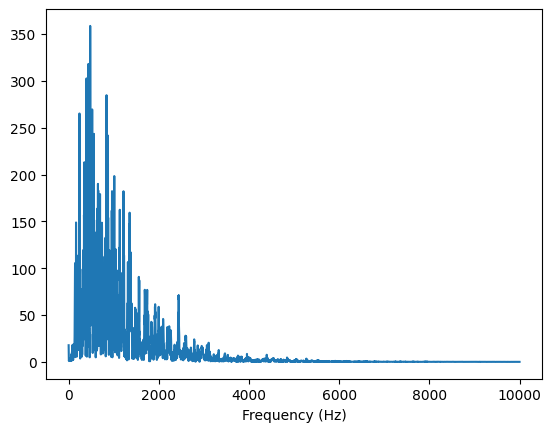

In [ ]:
spectrum.plot(high=10000)
plt.xlabel('Frequency (Hz)');
spectrum.make_wave().make_audio()

Чтобы найти частоту, встречающуюся на протяжении всего файла чаще всего, воспользуемся функцией peaks(), позволяющей вывести отсортированный список пиков частот. Таким образом, наиболее часто встречающейся частотой окажется та, которая будет находиться в вершине списка, т.е. 662.0 Гц

In [ ]:
spectrum.peaks()

[(358.6638802469622, 478.0),
 (318.0895243302988, 438.0),
 (302.6251238126289, 396.0),
 (284.708561936527, 840.0),
 (269.50249603518125, 522.0),
 (265.19165466438164, 240.0),
 (256.7396390867947, 398.0),
 (245.46411392923213, 842.0),
 (243.46371963608115, 560.0),
 (242.90520393611598, 476.0),
 (241.80254783288493, 866.0),
 (236.64204602158708, 506.0),
 (226.3249249265425, 480.0),
 (218.39275427562598, 482.0),
 (213.6766465332345, 400.0),
 (213.13716206527334, 348.0),
 (212.09826434812513, 354.0),
 (211.26591444083618, 872.0),
 (208.52770453201785, 350.0),
 (205.17498198876913, 356.0),
 (205.06876863076712, 490.0),
 (201.30912455566514, 484.0),
 (200.01622376174353, 838.0),
 (198.4877790249013, 346.0),
 (198.39979315824337, 1012.0),
 (194.19291343136004, 436.0),
 (192.68824825708856, 850.0),
 (191.98367374388656, 868.0),
 (191.1163182826737, 492.0),
 (190.0515000288296, 650.0),
 (188.31535974004652, 488.0),
 (187.40757921797427, 394.0),
 (183.49317063026967, 648.0),
 (183.20524431732397

Воспользуемся функциями ***low_pass***, ***high_pass*** и ***band_stop***, чтобы отфильтровать гармоники:
* low_pass - убрать частоты ***выше*** границы среза (задаётся в Гц);
* high_pass - убрать частоты ***ниже*** границы среза (задаётся в Гц);
* band_stop - убрать частоты ***между*** срезами

1) Воспользуемся функцией low_pass (фильтр низких частот), чтобы убрать частоты выше 2 кГц:

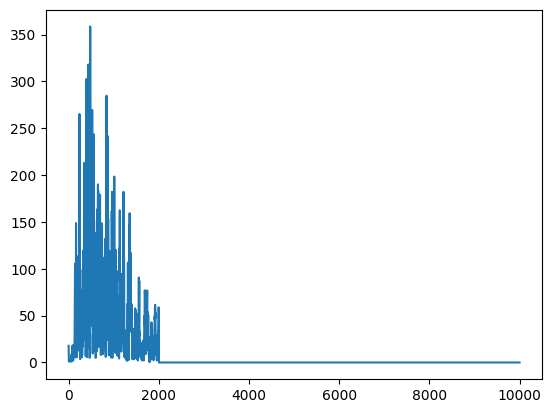

In [ ]:
spectrum = segment.make_spectrum()
spectrum.low_pass(2000)
spectrum.plot(high=10000)
spectrum.make_wave().make_audio()

Заметим, что при удалении высоких частот звук стал более "глубоким" и "приглушённым"

2) Воспользуемся функцией high_pass (фильтр высоких частот), чтобы убрать частоты ниже 1 кГц:

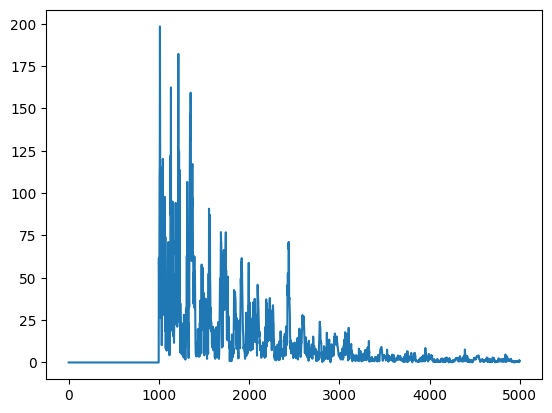

In [ ]:
spectrum = segment.make_spectrum()
spectrum.high_pass(1000)
spectrum.plot(high=5000)
spectrum.make_wave().make_audio()

Заметим, что звук стал "звенящим"


3) Воспользуемся функцией band_stop, чтобы убрать частоты в промежутке от 1 кГц до 2.1 кГц:

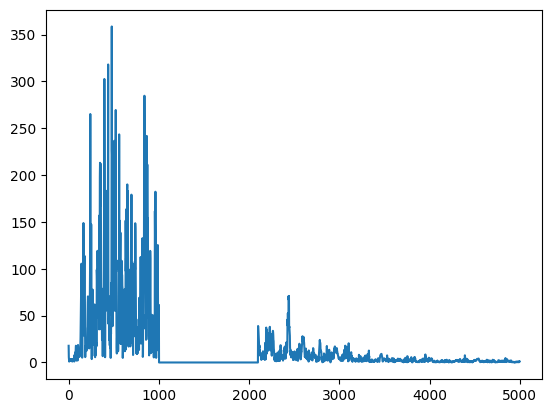

In [ ]:
spectrum = segment.make_spectrum()
spectrum.band_stop(low_cutoff=1000, high_cutoff=2100)
spectrum.plot(high=5000)
spectrum.make_wave().make_audio()

Эта функция позволяет отфильтровать те частототы, которые находятся в некотором промежутке, при ээтом и высокие, и низкие частоты не пострадают. Например, имея запись того, как играет некоторая музыкальная группа, можно выделить частоты соответствующие ударным или струнным инструментам, а остальные удалить.

4) Совместим все три функции описанные выше:

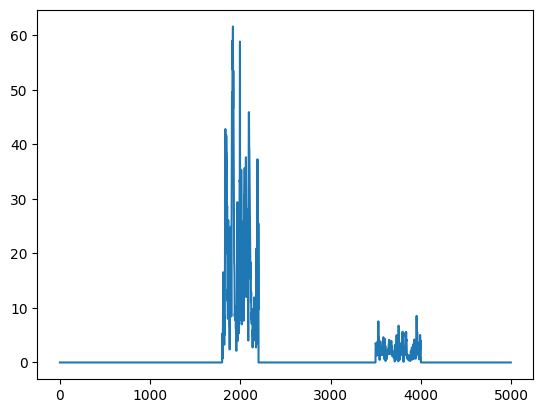

In [ ]:
spectrum = segment.make_spectrum()

# Удалим частоты ниже 1800 Гц
spectrum.high_pass(1800)
# Удалим частоты выше 4000 Гц
spectrum.low_pass(4000)
# Удалим частоты с 2200 по 3500 Гц
spectrum.band_stop(low_cutoff=2200, high_cutoff=3500)

spectrum.plot(high=5000)
spectrum.make_wave().make_audio()

## lab 1.3
---

**Задание**: Создать сложный сигнал из объектов *SinSignal* и *CosSignal*, сумируя их. Обработать сигнал для получения wave и послушать его. Вычислить *Spectrum* и распечатать.

In [ ]:
from thinkdsp import SinSignal, CosSignal

Создадим сложный сигнал, состоящий из синусоидальных и косинусоидальных компонент (будем указывать значения, кратные одному и тому же числу, например, 200). Эти компоненты складываются и интерфирируют между собой, усиливая или уменьшая сигнал:

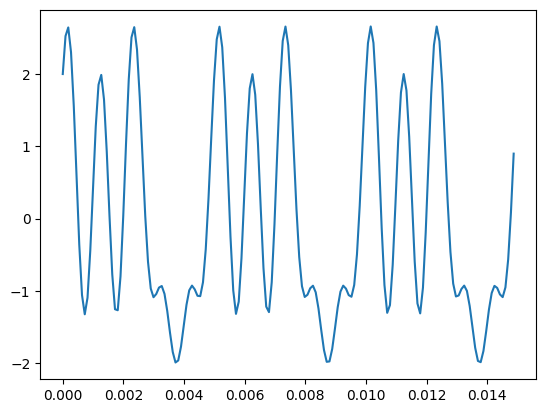

In [ ]:
signal = (SinSignal(freq=200) +
          SinSignal(freq=1000) +
          CosSignal(freq=400) +
          CosSignal(freq=800))
signal.plot()

Чтобы иметь практическое представление о полученном сигнале, воспользуемся функцией make_audio для создания звукового файла. В качестве длины звуковой дорожки укажем значение, равное 2 секукндам.

In [ ]:
wave = signal.make_wave(duration=2)
wave.apodize()
wave.make_audio()

Составим спектрограмму аналогично тому, как делали это в предыдущем пункте:

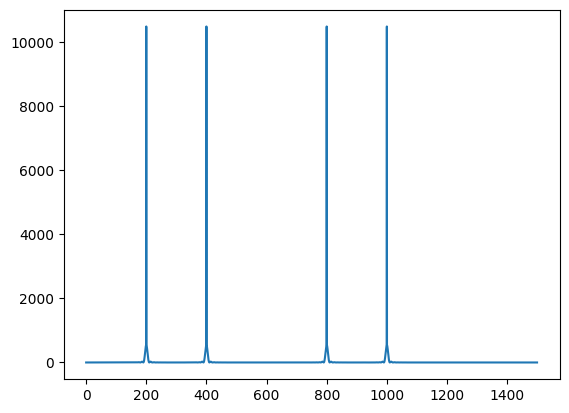

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot(high=1500)

Как видно из получившейся спектрограммы, пики находятся на тех же частотах, что и значения, указанные при создании сигнала.

* Для проверки того как будет вести себя звуковой сигнал, добавим ещё одну частоту, кратную 200. В данном случае в качестве такой было взято 600 Гц. Заметим, что при этом гармоника звука не сильно нарушается, т.к. все частоты кратны одному и тому же значению (200)

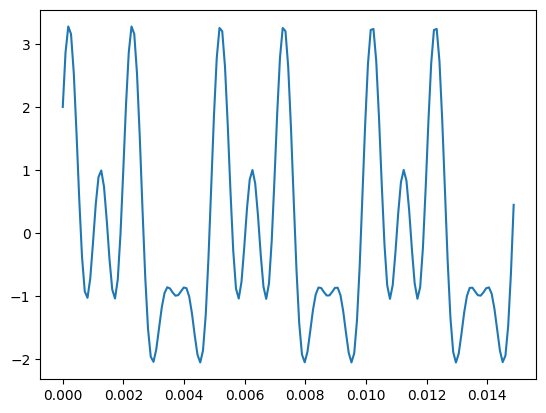

In [ ]:
signal += SinSignal(freq=600)
signal.plot()
signal.make_wave(duration=2).make_audio()

* Теперь добавим ещё одну частоту в исходный сигнал, которая не будет кратна 200 (например, 555 Гц). Заметим, что звук изменился - тональность осталась примерно та же, однако, на фоне слышен посторонний звук, связанный с добавлением новой частоты, не кратной 200.

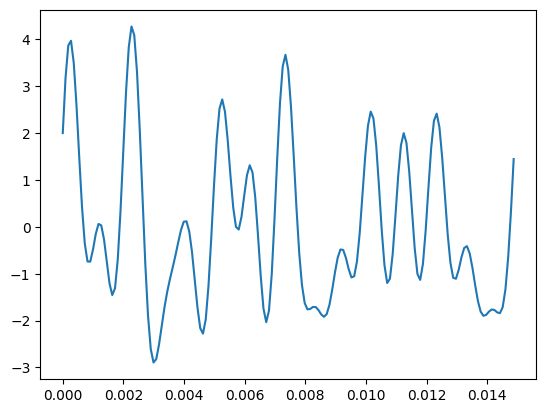

In [ ]:
signal += SinSignal(freq=555)
signal.plot()
signal.make_wave(duration=2).make_audio()

После добавления частот, равных 600 и 555 Гц спектр сигнала будет выглядеть следующим образом:

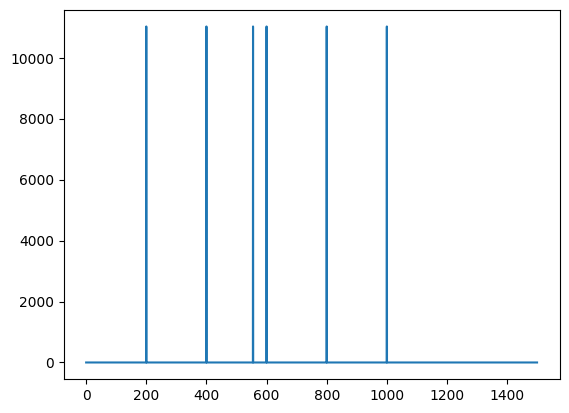

In [ ]:
wave = signal.make_wave(duration=2)
spectrum = wave.make_spectrum()
spectrum.plot(high=1500)

Таким образом, можно сделать вывод о том, что происходит при добавлении частотных компонент, не кратных основным:

1. Появление новых частотных составляющих:

 В спектре сигнала появятся новые частоты, которые не являются кратными основным частотам.

2. Изменение формы сигнала:

 Форма сигнала станет более сложной и нерегулярной. Появятся новые пики и минимумы, обусловленные интерференцией между новыми и основными частотными компонентами.

3. Появление биений:

 Если добавленная частота близка к одной из основных частот, то в сигнале могут появиться биения (периодические изменения амплитуды сигнала, вызванные интерференцией двух близких по частоте колебаний).

4. Расширение спектра сигнала:

 Спектр сигнала (распределение частотных компонент) станет шире.
 Это означает, что сигнал будет занимать более широкий диапазон частот.

5. Влияние на восприятие:

 Например, звук с добавленными некратными частотами может казаться более резким или диссонансным.

## lab 1.4
---

**Задание**: Написать функцию ***stretch***, берущую ***wave*** и коэффициент изменения. Она должна ускорять или замедлять сигнал изменением ***ts*** и ***framerate***.

Откроем [скаченный файл](https://freesound.org/people/FullMetalJedi/sounds/388954/), нормализуем и выведем его на экран. Код, выполняющий эти действия представлен ниже (при его запуске будет выведена спектрограмма загруженного звукового файла):

In [ ]:
wave = read_wave('acousticRiff.wav')
wave.make_audio()

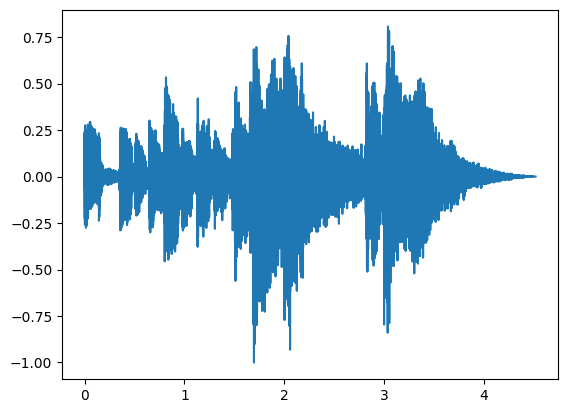

In [ ]:
wave.plot()

Ускорим рассматриваемый файл, воспользовавшись функцией ***stretch***:

In [ ]:
def stretch(wave, factor):
    """Speeding up and slowing down a signal

    wave: Wave
    factor: numerical value of the multiplier
    """
    wave.framerate /= factor
    wave.ts *= factor

* Замедлим рассматриваемый файл в 2 раза. Для этого в функции ***stretch*** укажем значение аргумента ***factor = 2***:

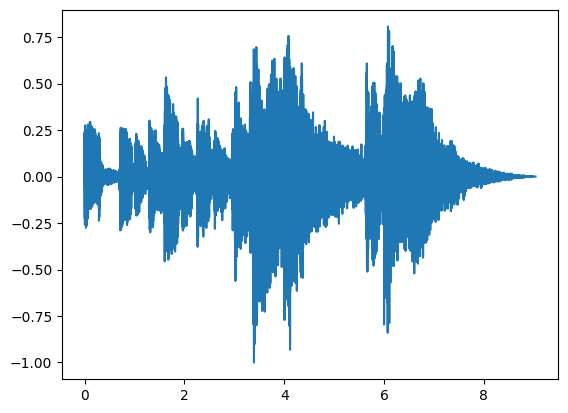

In [ ]:
stretch(wave, 2)
wave.plot()
wave.make_audio()

* Ускорим рассматриваемый файл в 2 раза. Для этого в функции ***stretch*** укажем значение аргумента ***factor = 0.5***:

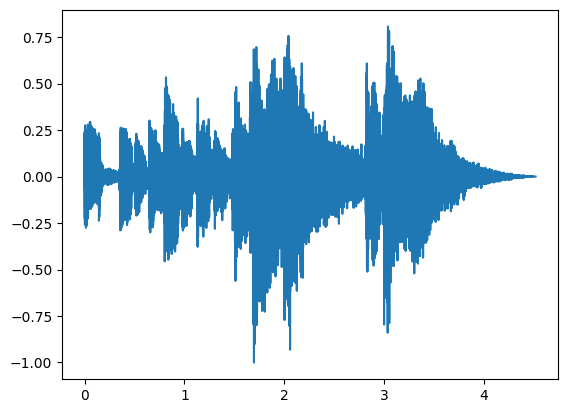

In [ ]:
stretch(wave, 0.5)
wave.plot()
wave.make_audio()

Файл был замедлен в 2 раза, а затем ускорен в 2 раза. Как и ожидалось в первый раз скорость воспроизведения увеличилась, а при последующем ускорении был вновь получен исходный файл. При этом изменялась только длительность аудиофайла (спектрограмма оставалась такой же, какой и была изначально).

# **lab 2 - Гармоники**
---

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

In [ ]:
from thinkdsp import Sinusoid, decorate, unbias, normalize
from thinkdsp import SquareSignal, TriangleSignal
import numpy as np

* ***unbias*** - смещает сигнал так, что он центрируется по 0
* ***normalize*** - масштабирует сигнал до заданной амплитуды amp

## lab 2.2
---

**Задание**: Написать класс, называемый **SawtoothSignal**, расширяющий **signal** и предоставляющий **evaluate** для оценки пилообразного сигнала.

### Пилобразный сигнал

In [ ]:
class SawtoothSignal(Sinusoid):

    def evaluate(self, ts):
        """Оценивает сигнал в заданное время

        ts: последовательность моментов времени, в которые оценивается сигнал
        returns: float wave array
        """
        # freq - частота, ts - временная последовательность, offset - добавочное смещение
        # (freq * ts) - кол-во циклов от начала
        # offset / (2 * pi) - число полных циклов
        # cycles - кол-во циклов
        cycles = self.freq * ts + self.offset / np.pi / 2
        frac, _ = np.modf(cycles)
        ys = normalize(unbias(frac), self.amp)
        return ys

* ***freq*** - частота
* ***ts*** - временная последовательность
* ***offset*** - добавочное смещение
* ***(freq * ts)*** - кол-во циклов от начала
* ***offset / (2 * pi)*** - число полных циклов
* ***cycles*** - кол-во циклов

Воспользовавшись написанным выше классом, создадим фрагмент аудиофайла длиной в 1 секунду с частотой 20 кГц. Также, распечатаем спектр сегмента длиной в 0.05 секунды, чтобы удостовериться в правильности формы сигнала

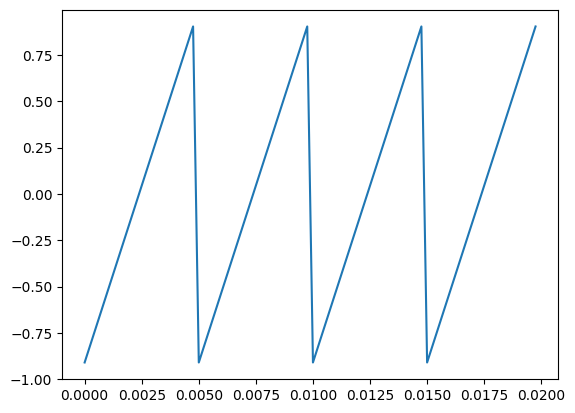

In [ ]:
sawtooth = SawtoothSignal(200).make_wave(duration=0.5, framerate=4000)
sawtooth.segment(duration=0.02).plot()
sawtooth.make_audio()

Составим спектрограмму данного аудиофайла, чтобы увидеть то, как располагаются частоты внутри звукового файла. Можно увидеть, что они уменьшаются пропорционально $1/f$


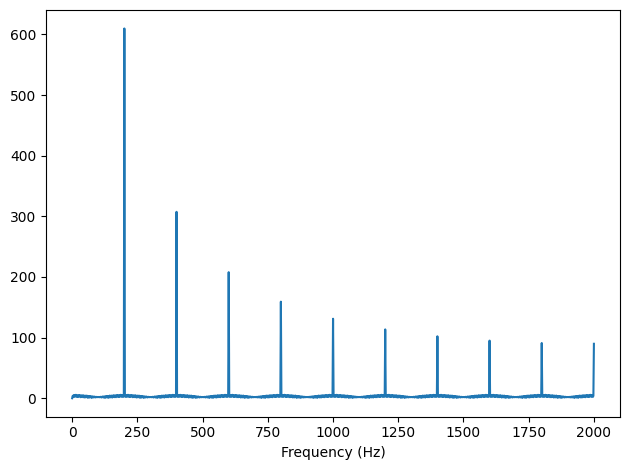

In [ ]:
spectrum = sawtooth.make_spectrum()
spectrum.plot(10000)
decorate(xlabel='Frequency (Hz)')

Рассмотрим 5 пиков спектра, можно заметить, что тут содержутся как чётные, так и нечётные гармоники

In [ ]:
sawtooth.make_spectrum().peaks()[:5]

[(609.6792973091863, 200.0),
 (307.3574911703562, 400.0),
 (207.84208349469822, 600.0),
 (159.19211928880733, 800.0),
 (131.08338845690827, 1000.0)]

Добавим к предыдущей спектрограмме новую, которая будет соответствовать прямоугольному сигналу (на диаграмме ниже выделена красным цветом). Для того, чтобы можно было сравнить и наглядно увидеть разницу между дввумя этими сигналами, при создании прямоугольного сигнала укажем значение $amp=0.5$

### Прямоугольный сигнал

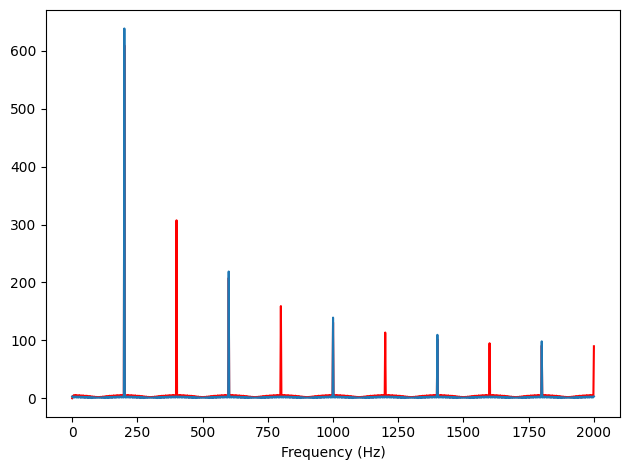

In [ ]:
sawtooth.make_spectrum().plot(color='red')
square = SquareSignal(freq=200, amp=0.5).make_wave(duration=0.5, framerate=4000)
square.make_spectrum().plot()
decorate(xlabel='Frequency (Hz)')

Сравним 5 пиков прямоугольного сигнала и сравним значения с полученными ранее для пилообразного сигнала

In [ ]:
square.make_spectrum().peaks()[:5]

[(638.7828910440652, 200.0),
 (218.9232741468842, 600.0),
 (139.31618714277246, 1000.0),
 (109.56806942182106, 1400.0),
 (98.28456801232416, 1800.0)]

Можно сделать вывод о том, что прямоугольный сигнал, как и пилообразный, уменьшается пропорционально $1/f$. Однако, прямоугольный сигнал имеет только нечётные гармоники, в отличие от пилообразного.

### Треугольный сигнал

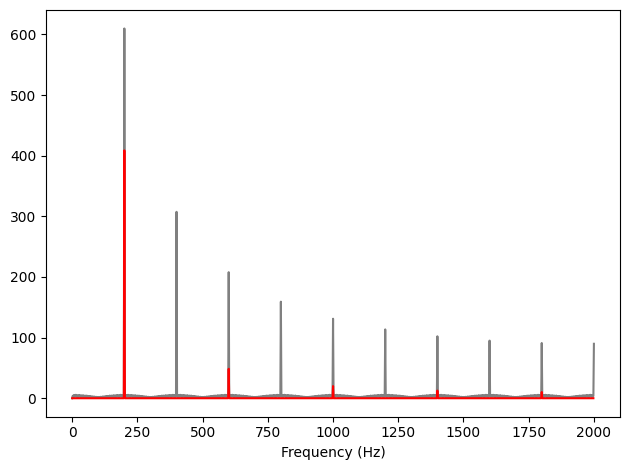

In [ ]:
sawtooth.make_spectrum().plot(high=10000, color='grey')
triangle = TriangleSignal(freq=200, amp=0.5).make_wave(duration=0.5, framerate=4000)
triangle_spectrum = triangle.make_spectrum()
triangle_spectrum.plot(high=2000, color='red')
decorate(xlabel='Frequency (Hz)')

Сравним 5 пиков треугольного сигнала и сравним значения с полученными ранее для пилообразного и прямоугольного сигналов

In [ ]:
triangle_spectrum.peaks()[:5]

[(408.6345818906141, 200.0),
 (48.51839996319229, 600.0),
 (19.999999999999485, 1000.0),
 (12.596161836824741, 1400.0),
 (10.25085630936863, 1800.0)]

Можно заметить, что как и прямоугольный сигнал, тругольный сигнал имеет только нечётные гармоники. Также, в графике можно проследить квадратичную зависимость, т.к. зависимость падения сигнала от частоты пропорциональна $1 / f^2$

## lab 2.3
___

**Задание:** Создать прямоугольный сигнал 100 Гц и вычислить ***wave*** с выборками 10 000 кадров в секунду. Построить спектр и убедиться, что большинство гармоник "завёрнуты" из-за биений. Узнать повлияет ли это на при проигровании.

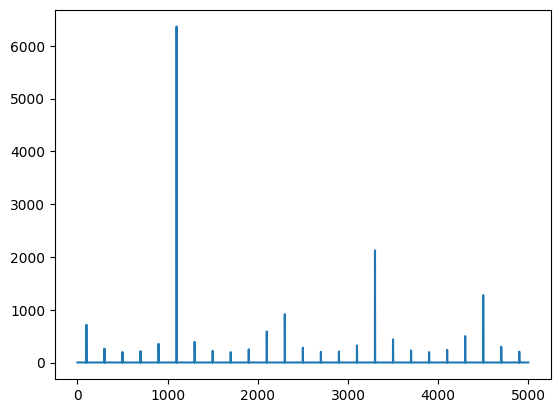

In [ ]:
from thinkdsp import SquareSignal

square = SquareSignal(1100).make_wave(duration=1, framerate=10000)
square.make_spectrum().plot()
square.make_audio()

Для того, чтобы было удобнее анализировать полученный спектр, выведем несколько пиков:

In [ ]:
square.make_spectrum().peaks()[:10]

[(6367.182534102138, 1100.0),
 (2125.0234754609446, 3300.0),
 (1278.179301804898, 4500.0),
 (916.3945635352013, 2300.0),
 (716.3133230172564, 100.0),
 (589.7524848583665, 2100.0),
 (502.79979422568437, 4300.0),
 (439.63348354369833, 3500.0),
 (391.8810380915291, 1300.0),
 (354.6987875059537, 900.0)]

Рассматриваемый сигнал является прямоугольным, следовательно, он будет иметь только нечётные гармоники. Таким образом, ожидаемыми гармониками сигнала должны быть 3200, 5500, 7700 и 9900 Гц.

Как и ожидалось, на спектре, полученном выше, есть пики 1100 и 3300 Гц. Однако, следующие пики равны 4500, 2300 и 100 Гц вместо ожидаемых 5500, 7700 и 9900 Гц соответственно. Данный эффект связан с биениями, которые возникли в выборках с частотой 10 000 Гц кадров в секунду из сигналов выше 5000 Гц.
В качестве примера ниже приведём пример графика, где изображены оба сигнала (4500 и 5500 Гц) серыми линиями, а выборки - вертикальными.

* Сигнал 4500 Гц при 10 000 кадрах/с

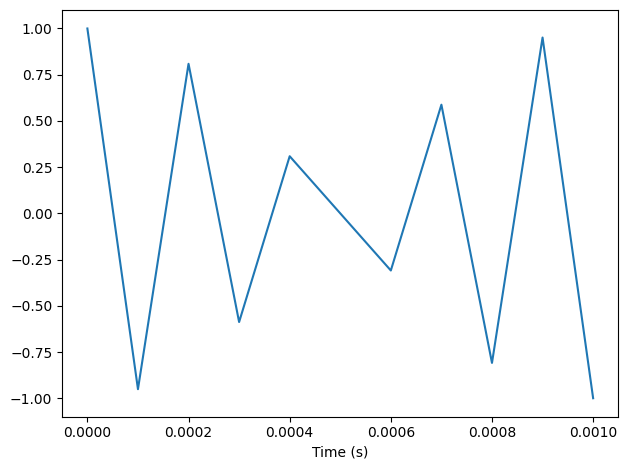

In [ ]:
from thinkdsp import CosSignal

signal = CosSignal(4500)
duration = signal.period*5
segment = signal.make_wave(duration, framerate=10000)
segment.plot()
decorate(xlabel='Time (s)')

* Сигнал 5500 Гц при 10 000 кадрах/с

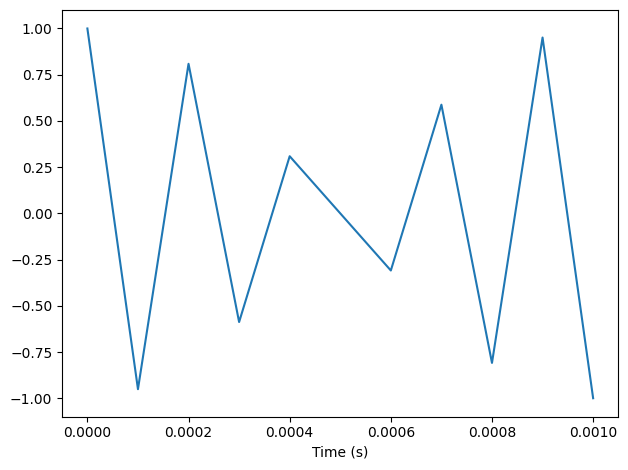

In [ ]:
signal = CosSignal(5500)
segment = signal.make_wave(duration, framerate=10000)
segment.plot()
decorate(xlabel='Time (s)')

Как видно, значения ***signal*** различаются, а ***wave*** совпадают. Отсюда становится понятно, что выборки с частотой 10 кГц/с из сигнала 5500 Гц не будут отличимы от выборок из сигнала 4500 Гц, 77000 не будет отличима от 2300 Гц и тд.

* Как итог, сигнал заучит совсем по-другомму. Например, появятся частоты, не кратные основным (2300 Гц). Если же рассмотреть 100 Гц, то появятся лишние низкие частоты, из-за чего звук станет более низким.

In [ ]:
from thinkdsp import SinSignal

SinSignal(2300).make_wave(duration=1, framerate=10000).make_audio()

In [ ]:
SinSignal(100).make_wave(duration=1, framerate=10000).make_audio()

* Получившиеся аудиозаписи сильно отличаются от первоначальной, что показывает как силдьно могут биения повлиять на исходный сигнал.

## lab 2.4
___

**Задание**: Взять объект **Spectrum** и распечатать несколько первых значений **Spectrum.fs**. Убедиться в том, что начинаются с нуля, т.е. **Spectrum.hs[0]** - амплитуда комоненты с чатотой 0. Провести эксперемент:

1) Создать треугольный сигнал с частотой 440 Гц и **wave** длительностью 0,01 с. Распечатать сигнал

2) Создать объект **Spectrum** и распечатать **Spectrum.hs[0]**. Понять каковы амплитуда и фаза этого компонента.

3) Установить **Spectrum.hs[0] = 100**. Ронять как эта операция повлияет на сигнал.

Создадим треугольный сигнал:

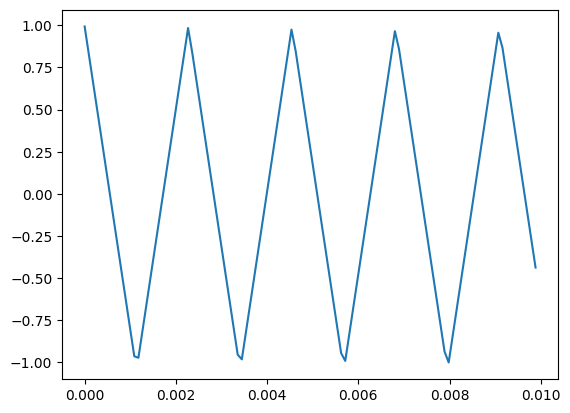

In [ ]:
from thinkdsp import TriangleSignal

triangle = TriangleSignal(freq=440).make_wave(duration=0.01)
triangle.plot()

Получим спектр и выведем первый элемент **Spectrum.hs[0]**, чтобы убедиться в том, что он равен 0:

In [ ]:
spectrum = triangle.make_spectrum()
spectrum.hs[0]

(1.0436096431476471e-14+0j)

Установим это занчение равное 100 и выведем новый (красный график) и исходный (синий график) сигналы:

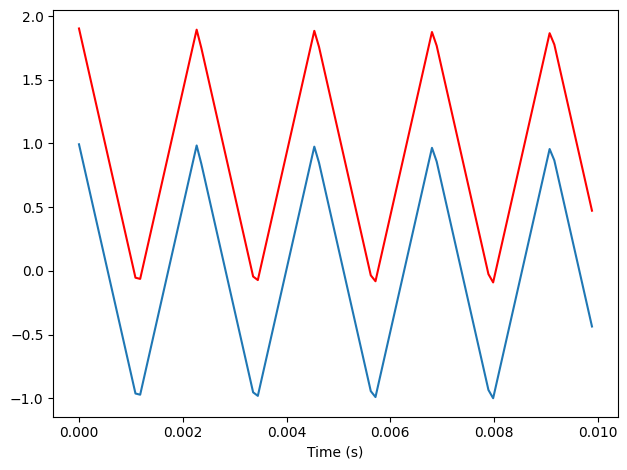

In [ ]:
spectrum.hs[0] = 100

triangle.plot()
spectrum.make_wave().plot(color='red')
decorate(xlabel='Time (s)')

* Компонент нулевой частоты **Spectrum.hs[0]** представляет собой сумму всех значений сигнала. Поскольку изначально сигнал был несмещён, этот компонент был равен 0. После изменений этого значения на 100 произошло смещение, вследствие чего график поднялся вертикально вверх, не сдвигаясь по горизонтали.

## lab 2.5
___

**Задание**: Написать функцию, принимающую **Spectrum** как параметр и изменяющую его делением каждого элемента **hs** на соответствующую частоту из **fs**.

In [ ]:
def change_spectrum(spectrum):
    spectrum.hs[0] = 0 # исключаем деление на 0
    spectrum.hs[1:] /= spectrum.fs[1:] # делим спектр на fs

Проверим эту функцию, используя прямоугольный сигнал, треугольный или пилообразный сигналы:

1) Вычислим **Spectrum** и распечатаем его

In [ ]:
wave = TriangleSignal().make_wave(duration=1)
wave.make_audio()

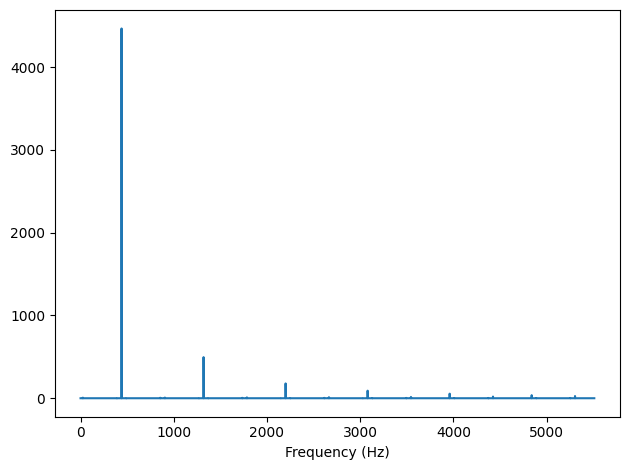

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot(high=10000)
decorate(xlabel='Frequency (Hz)')

2) Изменим **spectrum** с помощью функции **change_spectrum**:

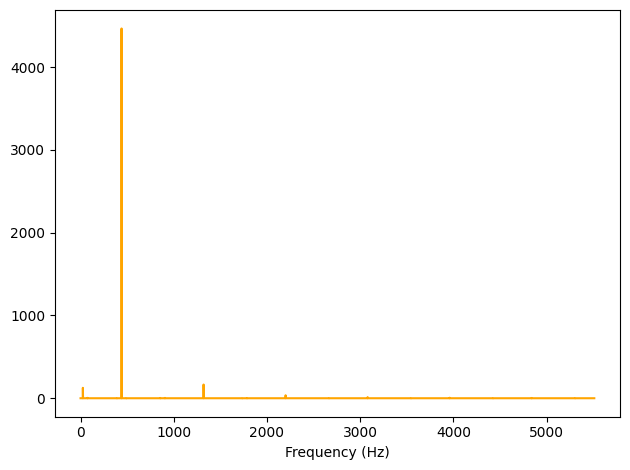

In [ ]:
change_spectrum(spectrum)
spectrum.scale(440)
spectrum.plot(high=10000, color='orange')
decorate(xlabel='Frequency (Hz)')

Посмотрев на график и сравнив его с изначальным, видно, что механизм чем-то напоминает фильтр низких частот.

3) Воспользуемся **Spectrum.make_wave**, чтобы сделать **wave** из изменённого **Spectrum** и воспроизведём его:

In [ ]:
changed = spectrum.make_wave()
changed.make_audio()

После прослушивания получившегося аудиофайла слышно, что звук стал более низким (высоких частот меньше), что подтверждает ожидаемый результат.

## lab 2.6
___

**Задание**: У треугольных и прямоугольых сигналов есть только нечётные гармоники; в пилообразном сигнале есть и чётные, и нечётные гармоники. Гармоники прямоугольных и пилообразных сигналов уменьшаются пропорционально $1/f$, гармоники треугольных сигналов - пропорционально $1/f^2$. Нужно понять, можно ли найти сигнал, состоящий из чётных и нечётных гармоник, спадающих пропорционально $1/f^2$.

Напишем вспомогательную функцию, которая будет определять, подчиняются ли поступающие на её вход значения формуле $1/f^2$. Это поможет проверить, получилось ли найти необходимый сигнал.

In [ ]:
def check_f_squared_law(freqs, amps):
  """
  Проверяет, подчиняются ли амплитуды сигнала закону квадрата частоты.

  Args:
    freqs: Список частот сигнала.
    amps: Список амплитуд сигнала.

  Returns:
    True, если амплитуды подчиняются закону квадрата частоты, False - в противном случае.
  """

  # Вычислить ожидаемые амплитуды
  expected_amps = 1 / freqs**2

  # Сравнить ожидаемые и фактические амплитуды
  tolerance = 1e-6
  return np.allclose(amps, expected_amps, atol=tolerance)

Попытаемся получить сигнал путём сложения нескольких синусооид.

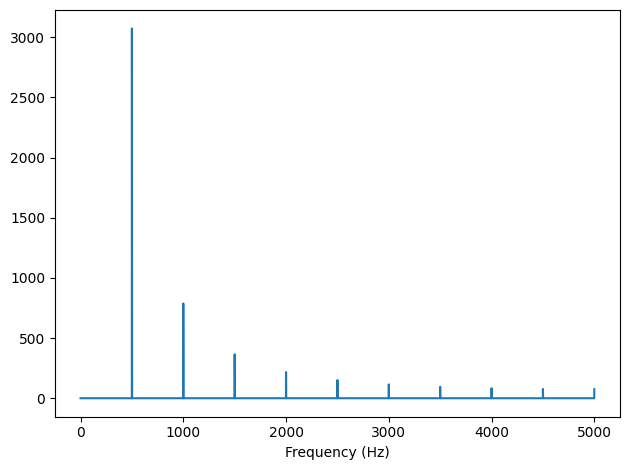

In [ ]:
from thinkdsp import SinSignal

freqs = np.arange(500, 9500, 500) # список частот
amps = 1 / freqs**2 # dопределяет амплитуды для каждой из частот
signal = sum(SinSignal(freq, amp) for freq, amp in zip(freqs, amps)) # создаём сигнал, суммируя косинусоиды

spectrum = wave.make_spectrum()
spectrum.plot()
decorate(xlabel='Frequency (Hz)')

Выведем пики спектрограммы, чтобы увидеть последовательность убывания частот:

In [ ]:
spectrum.peaks()[:10]

[(3072.4404653429615, 500.0),
 (787.3786432330505, 1000.0),
 (364.7999997232463, 1500.0),
 (217.6261045864612, 2000.0),
 (150.37593984962825, 2500.0),
 (114.87699586469492, 3000.0),
 (94.70798373552688, 3500.0),
 (83.1257751127871, 4000.0),
 (77.07410758923834, 4500.0),
 (75.18796992480947, 5000.0)]

С помощью созданной ранее вспомогательной функции **check_f_squared_law()** проверим, что полученный сигнал соответствует тому, который требовалось найти по заданию:

In [ ]:
result = check_f_squared_law(freqs, amps)
print(result) # True

True


Воспроизведём полученный сигнал:

In [ ]:
wave = signal.make_wave(duration=1, framerate=10000)
wave.make_audio()

Как видно, вывелось значение ***True***, что говорит о том, что гармоники спадают пропорционально $1/f^2$, что соответствует требованиям задания.

# lab 3 - Апериодические сигналы
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

--2024-02-11 14:33:58--  https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py [following]
--2024-02-11 14:33:58--  https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48574 (47K) [text/plain]
Saving to: ‘thinkdsp.py’

thinkdsp.py         100%[===================>]  47.44K  --.-KB/s    in 0.01s   

2024-02-11 14:33:59 (3.45 MB/s) - ‘thinkdsp.py’ saved [48574/48574]



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from thinkdsp import decorate, read_wave

## lab 3.1
___

**Задание**: Запустить и прослушать примеры из блокнота **[chap03.ipymp](https://colab.research.google.com/github/AllenDowney/ThinkDSP/blob/master/code/chap03.ipynb)**. В примере с утечкой заменить окно Хэмминга одним из окон, предоставленных в **NumPy** и посмотреть , как они вллияют на утечку (см. [ссылку](http://docs.scipy.org/doc/numpy/reference/routines.window.html)).

Посмотрим на влияние утечки на синусоидальный сигнал (который содержит только одну частотную составляющую).

In [ ]:
from thinkdsp import SinSignal

signal = SinSignal(freq=440)

Создадим синусоидальный сигнал с частотой 440 Гц.

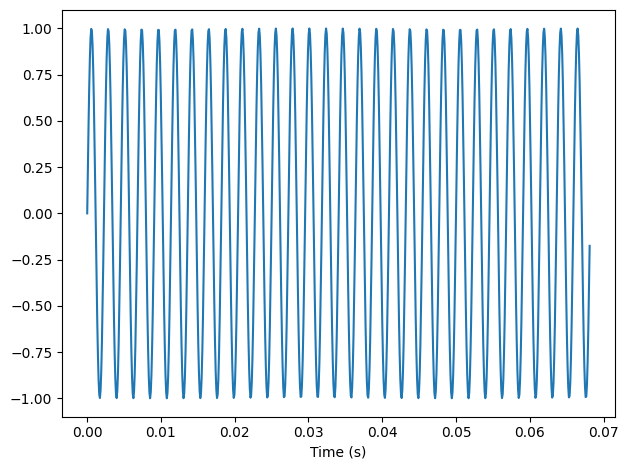

In [ ]:
duration = signal.period * 30
wave = signal.make_wave(duration)
wave.plot()
decorate(xlabel='Time (s)')

Разложимего в  спектр с параметром **high**=880, т.е. так, чтобы утечка была кратна периоду:

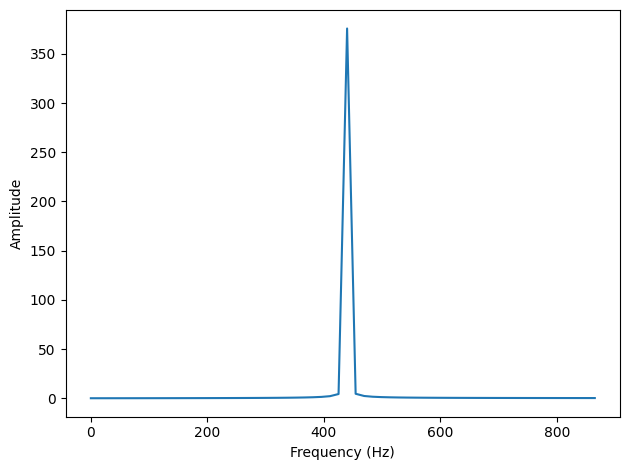

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot(high=880)
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

Теперь рассмотрим случай, когда утечка не кратна периоду. В этом случае утечка будет очень серьёзной.

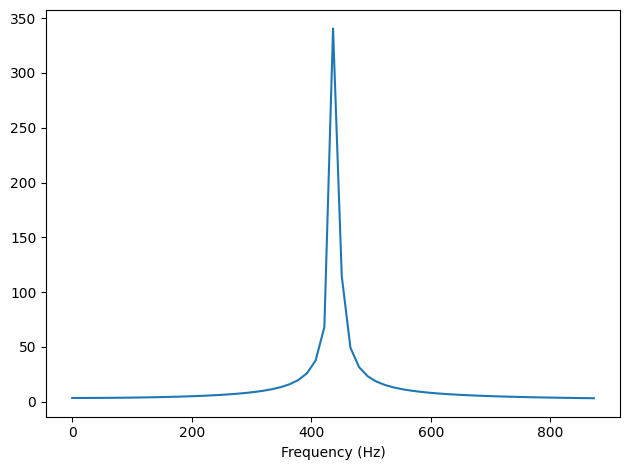

In [ ]:
duration = signal.period * 30.25
wave = signal.make_wave(duration)
spectrum = wave.make_spectrum()
spectrum.plot(high=880)
decorate(xlabel='Frequency (Hz)')

В таком случае можно использовать окна. Их использование поможет, однако, это уменьшит общую энергию.

Рассмотрим как будет выглядеть эффект 5ти разных окон:

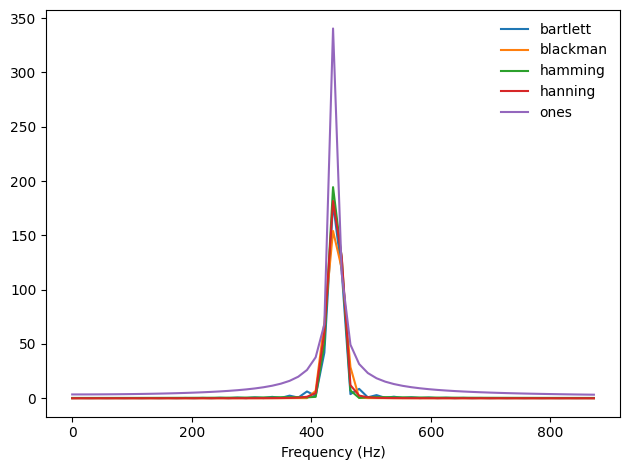

In [ ]:
for window_func in [np.bartlett, np.blackman, np.hamming, np.hanning, np.ones]:
    wave = signal.make_wave(duration)
    wave.ys *= window_func(len(wave.ys))

    spectrum = wave.make_spectrum()
    spectrum.plot(high=880, label=window_func.__name__)

decorate(xlabel='Frequency (Hz)')

Заметим, что функция Бартлетта оставляет остаточный дребезг. Во всех случаях ф-ция Хэмминга показывает себя лучше всего, т.к. она рассеивает меньше всего энергии, поэтому была использована именно она.

## lab 3.2
___

**Задание**: Написать класс, называемый `SawtoothChirp`, расширяющий `Chirp` и переопределяющий `evaluate` для генерации пилообразного  сигнала с линейно увеличивающейся (или уменьшающейся) частотой.

Нарисовать эскиз спектрограммы этого сигнала и распечатать её. Эффект биений должен быть очевиден, а если сигнал внимательно прослушать, то можно услышать биения.

В качестве заготовки функции воспользуемся функцией из пункта 2.2

In [ ]:
from thinkdsp import Chirp
from thinkdsp import normalize, unbias

PI2 = np.pi * 2

class SawtoothChirp(Chirp):
    """Представляет пилообразный сигнал с переменной частотой."""

    def evaluate(self, ts):
        freqs = np.linspace(self.start, self.end, len(ts))
        dts = np.diff(ts, prepend=0) # разница м/у соседними эл-тами ts (эл-ты времени)
        dphis = PI2 * freqs * dts # изменения фазы
        phases = np.cumsum(dphis) # вычисляет нарастающую сумм2у
        phases = np.insert(phases, 0, 0) # добавляем 0 в начало
        cycles = phases / PI2
        frac, _ = np.modf(cycles)
        ys =  normalize(unbias(frac), self.amp)
        return ys

Создадим сигнал, воспользовавшись `SawtoothChirp` и воспроизведём его:

In [ ]:
signal = SawtoothChirp(start=220, end=880)
wave = signal.make_wave(duration=1, framerate=4000)
wave.apodize()
wave.make_audio()

График сигнала будет выгляеть следующим образом:

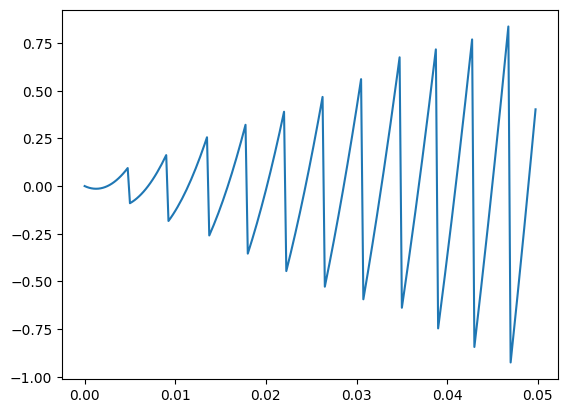

In [ ]:
wave.segment(duration=0.05).plot()

График и аудио запись подтверждают то, что сигнал пилообразный. Теперь выведем спектрограмму полученного сигнала:

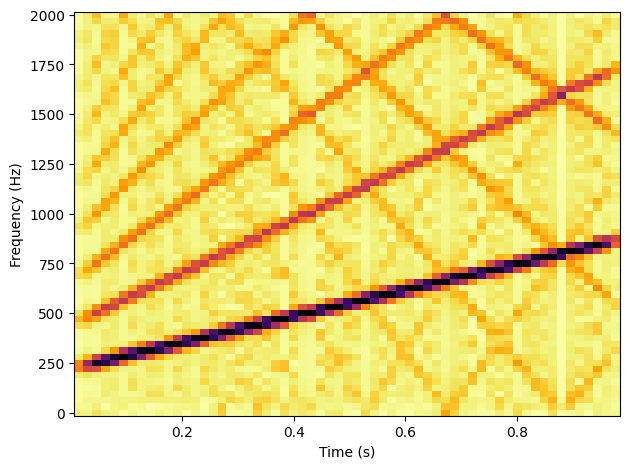

In [ ]:
spectrum = wave.make_spectrogram(128)
spectrum.plot()
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

При малой частоте кадров можно наблюдать как совмещённые гармоники отображаются от частооты сгиба. На практике их можно уловить как шипение пр и прослушивании аудио файла. Если увеличить частоту кадров, то они исчезнут:

## lab 3.3
___

**Задание**: Создать пилообразный `Chirp`, меняющийся от 2500 до 3000 Гц, и на его основе сгенерировать сигнал длительностью 1 с и частотой кадров 20 кГц. Нарисовать, каким примерно будет Spectrum. Затем распечатать Spectrum и посмотреть, правильно ли было сделано предполажение.

Создадим чирп:

In [ ]:
signal = SawtoothChirp(start=2500, end=3000)
wave = signal.make_wave(duration=1, framerate=20000)
wave.make_audio()

Основная частота колеблется от 2500 до 3000 Гц, следовательно, при 2500 Гц сигнал резко возрастёт, после чего будет идти до 3000 Гц, а затем упадёт (этот фрагмент находится выше последующих, т.к. мы имеем дело с пилообразным сигналом, гармоники которого убывают пропорционально $1/f$, следовательно каждый последующий скачок будет меньше предыдущего). Таком образом, дойдя до 2го промежутка, который начинается при 5000 Гц, сигнал возрастёт, однако пик будет в 2 раза меньше сегмента 1. После 6000 Гц чигнал упадёт. Аналогично будет и с 3им сегментом (с 7500 по 9000 Гц), где сигнал возрастёт на высоту $= 1/3$ от первоначальной, а зетем снова упадёт. Примерный вид спектрограммы представлен на рисунке ниже:

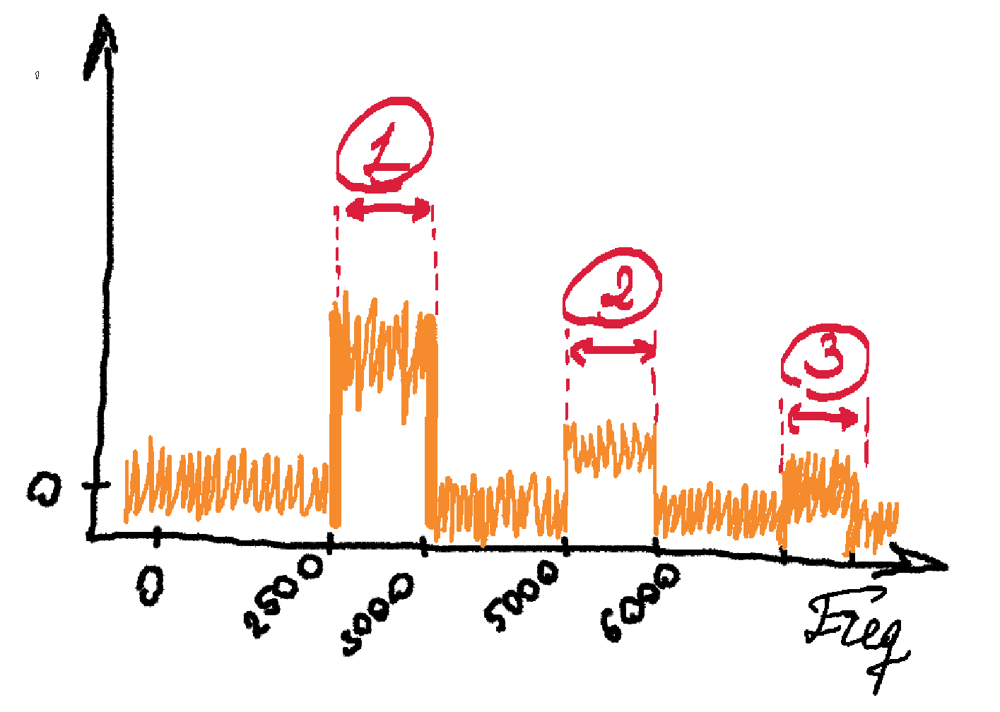

Теперь построим требуемую спектрограмму и распечатаем её:

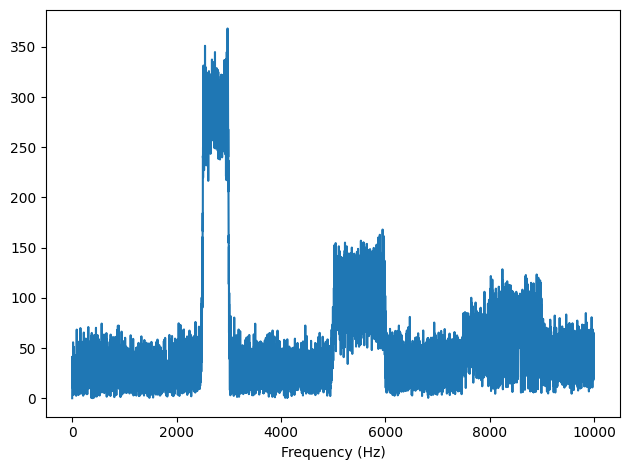

In [ ]:
wave.make_spectrum().plot()
decorate(xlabel='Frequency (Hz)')

Получившаяся спектрограмма совпала с вышеизложенными ожиданиями

## lab 3.4
___

**Задание**: В музыкальной терминологии *глиссандо* - это нота, меняющаяся от одной высоты до другой, то есть, свободный чирп.
Найти или записать звук глиссандо и распечатать спектрограмму первых нескольких секунд.

In [ ]:
if not os.path.exists('test.wav'):
    !wget https://github.com/MatNepo/Telecom2024/blob/main/lab3/test.wav

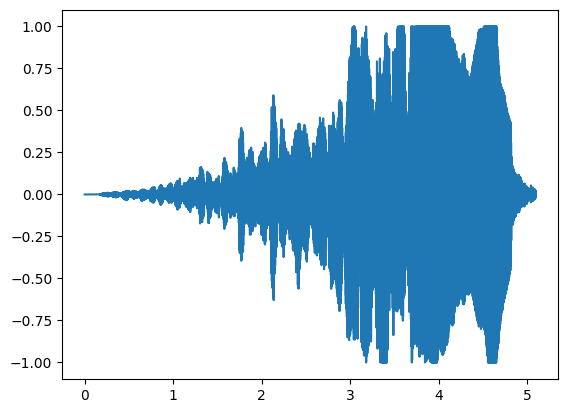

In [ ]:
wave = read_wave('test.wav')
wave.segment().plot()
wave.make_audio()

Выведем спектрограмму:

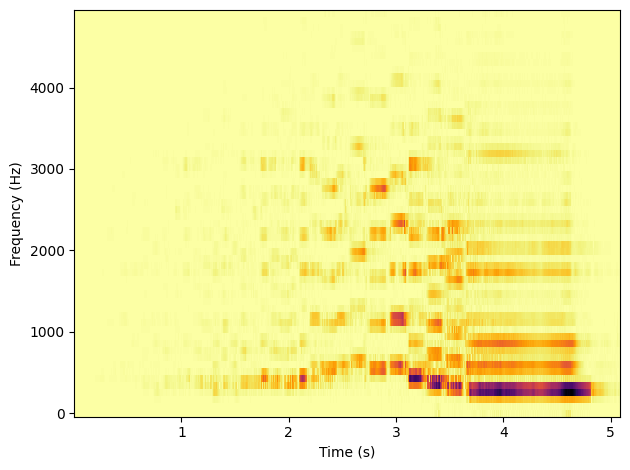

In [ ]:
wave.make_spectrogram(512).plot(high=5000)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

На полученной спектограмме можно заметить зависимость частоты от высоты сигнала (ноты): по мере того, как звук становился громче и ноты менялись, менялась и частоты. Как только последняя нота была сыграна, частота пеестала расти.

## lab 3.5
___

**Задача**: Трумбонист играет глиссандо, непрерывно дуя в мундштук и двигая кулису трамбона. При этом общая длина трубы меняется, а играемая нота обратно пропорциональна этой длине.

Если предположить, что музыкант двигает кулису с постоянной скоростью, как будет меняться во времени частота?

Напишите класс, называемый `TromboneGliss`, расширяющий `Chirp` и предоставляющий `еvaluate`. Создайте сигнал, имитирующий глиссандо на тромбоне от **С3** до **F3**, и обратно до **С3**. **С3** - 262 Гц; F3-349 Гц.

Напечатайте спектрограмму полученного сигнала. На что похоже глиссандо на тромбоне на линейный или же экспоненциальный чирп?

Создадим класс `TromboneGliss`:

In [ ]:
class TromboneGliss(Chirp):
    """Представляет собой сигнал, похожий на тромбон, с различной частотой."""

    def evaluate(self, ts):
        """Оценивает сигнал в заданное время.

         ts: массив чисел с плавающей запятой

         Возвращает: волновой массив с плавающей запятой
        """
        l1, l2 = 1.0 / self.start, 1.0 / self.end
        lengths = np.linspace(l1, l2, len(ts)) # длина кулисы трамбона
        freqs = 1 / lengths # изменение длины кулисы трамбона

        # стандартное объявление ф-ции evaluate
        dts = np.diff(ts, prepend=0)
        dphis = PI2 * freqs * dts # Фаза сигнала
        phases = np.cumsum(dphis)
        ys = self.amp * np.cos(phases)
        return ys

Согласно заданию, сигнал трамбона должен состоять из 2 частей:

* Опишем первую часть волны (от C3 до F3) и выведем аудио файл сигнала:

In [ ]:
low = 262 # C3
high = 349 # F3

signal = TromboneGliss(high, low)
wave1 = signal.make_wave(duration=1)
wave1.apodize()
wave1.make_audio()

* Аналогично опишем вторую часть (от F3 до C3):

In [ ]:
signal = TromboneGliss(low, high)
wave2 = signal.make_wave(duration=1)
wave2.apodize()
wave2.make_audio()

Соединим полученные части в один общий сигнал:

In [ ]:
wave = wave1 | wave2
wave.make_audio()

Распечатаем спектрограмму полученного сигнала:

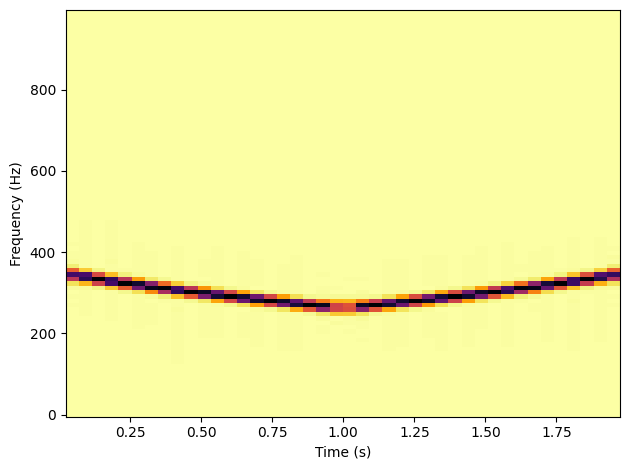

In [ ]:
sp = wave.make_spectrogram(1024)
sp.plot(high=1000)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

## lab 3.6
___

**Задание**: Сделать или найти запись серии гласных звуков и посмотреть на спектрограмму. Получится ли различить гласные?

Загрузим аудио файл с произношением глассных букв алфавита:

In [ ]:
if not os.path.exists('87778__marcgascon7__vocals.wav'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/87778__marcgascon7__vocals.wav

--2024-02-11 21:49:11--  https://github.com/AllenDowney/ThinkDSP/raw/master/code/87778__marcgascon7__vocals.wav
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/87778__marcgascon7__vocals.wav [following]
--2024-02-11 21:49:11--  https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/87778__marcgascon7__vocals.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1399852 (1.3M) [audio/wav]
Saving to: ‘87778__marcgascon7__vocals.wav’

87778__marcgascon7_ 100%[===================>]   1.33M  --.-KB/s    in 0.07s   

2024-02-11 21:49:12 (19.5 MB/s) - ‘87778__

In [ ]:
wave = read_wave('vowelsLetters.wav')
wave.make_audio()

Выведем спектрограмму сигнала. Плюсом данной аудио записи является тот факт, что здесь нету большого количества посторонних шумов, что позволит отчётливо распознать положение гласных звуков на спектрограмме

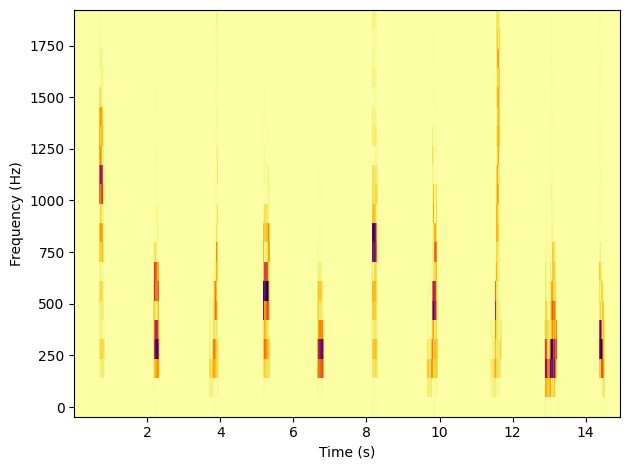

In [ ]:
wave.make_spectrogram(512).plot(2000)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

Форманты (пики на спектрограмме), которые выбиваются относительно фоновых шумов являются гласными звуками.

Гласные звуки русского языка а, э, и, о, у отличаются друг от друга по соотношению амплитуд первых двух формант (F1 и F2) относительно основного тона (F0). Это различие обуславливается артикуляционными характеристиками каждого звука, которые влияют на его спектральный состав.

* F0 (основной тон): 80-300 Гц (мужчины), 160-500 Гц (женщины).
* F1 (первая форманта): 200-800 Гц.
* F2 (вторая форманта): 800-2500 Гц.

Примерные диапазоны частот для изолированных гласных звуков (в контексте речи частоты могут меняться):

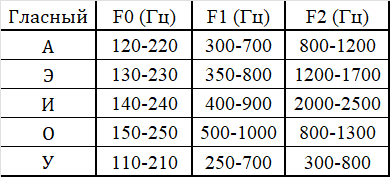

Выделим отдельно сегмент со звуком «а»:

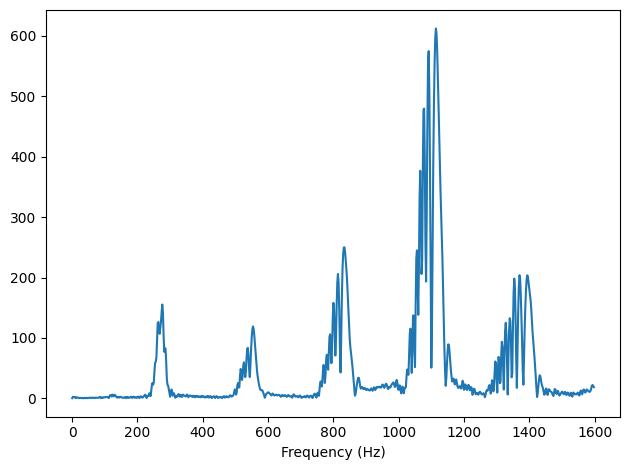

In [ ]:
segment = wave.segment(start=0.5, duration=0.5)
segment.make_spectrum().plot(high=1600)
decorate(xlabel='Frequency (Hz)')
segment.make_audio()

Форманты находятся на частотах 250 Гц и 1100 Гц. Данные значение подходят под теоретическое описание звука «а».

Выделим отдельно сегмент со звуком «у»:

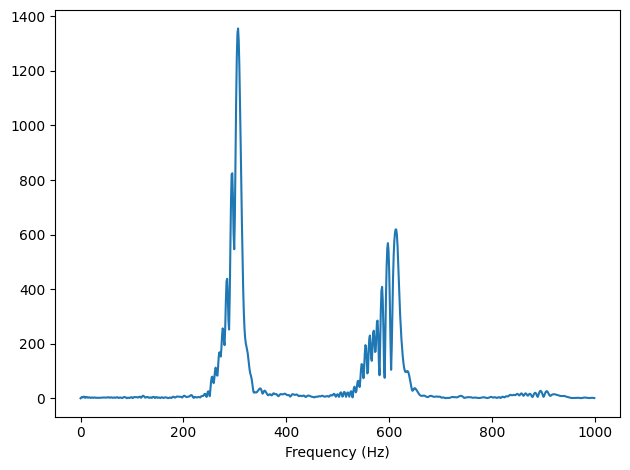

In [ ]:
segment = wave.segment(start=2, duration=0.8)
segment.make_spectrum().plot(high=1000)
decorate(xlabel='Frequency (Hz)')
segment.make_audio()

Форманты находятся на частотах 300 Гц и 600 Гц (меньше 800, но не сильно). Несмотрея на то,что вторая форманта чуть сдвинута влево, по спектрограмме видно, что она описывает звук звука «у».

Выделим отдельно сегмент со звуком «о»:

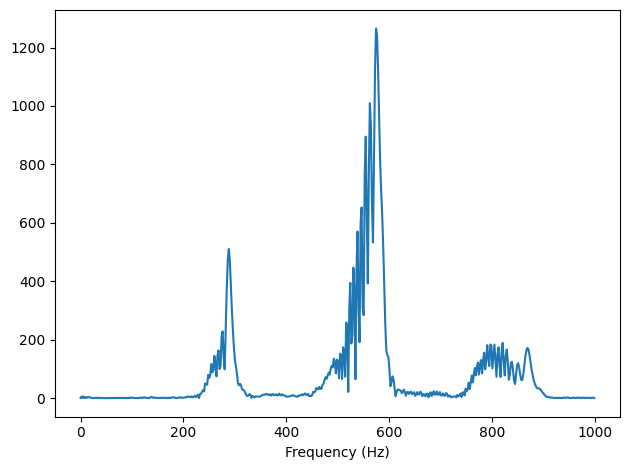

In [ ]:
segment = wave.segment(start=5.1, duration=0.5)
segment.make_spectrum().plot(high=1000)
decorate(xlabel='Frequency (Hz)')
segment.make_audio()

Форманты находятся на частотах 580 Гц и 800 Гц. Данные значение подходят под теоретическое описание звука «о».

Выделим отдельно сегмент со звуком «э»:

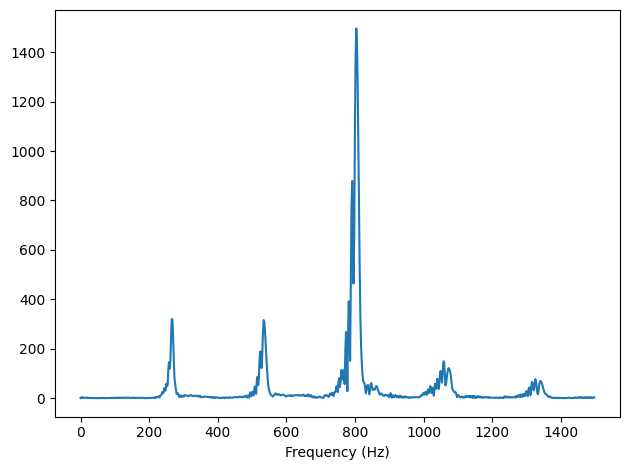

In [ ]:
segment = wave.segment(start=8, duration=0.5)
segment.make_spectrum().plot(high=1500)
decorate(xlabel='Frequency (Hz)')
segment.make_audio()

Ожидаемыми формантами являются 800 Гц для F1 и 1200-17000 Гц для F2. Значения F1, полученные спектограммой совпали с ожидаемыми. Значение F2 на спектограмме не совсем соответствует нужному, однако можно заметить, что на частотах от 1000 до 1400 Гц есть форманты, что говорит о том, что по спектограмме можно понять, что на ней изображён звук «э».

Выделим отдельно сегмент со звуком «и»:

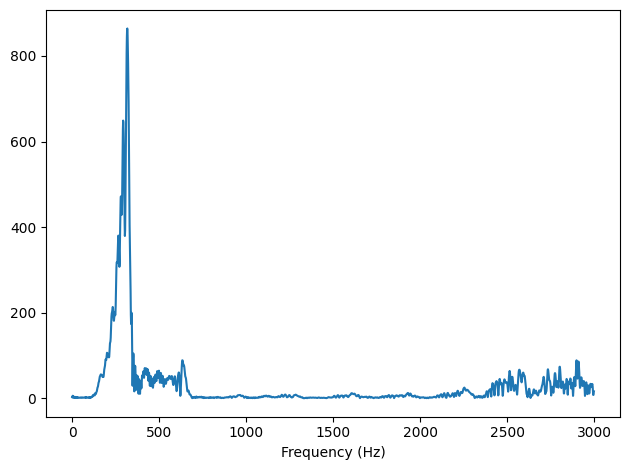

In [ ]:
segment = wave.segment(start=14.1, duration=0.7)
segment.make_spectrum().plot(high=3000)
decorate(xlabel='Frequency (Hz)')
segment.make_audio()

Форманты находятся на частотах 300 Гц и 2500 Гц. Данные значение примерно подходят под теоретическое описание звука «о».

Таким образом, если звукии не являются частью фраз и звучат отчётливо, то их спектрограммы соответствуют теоретическим значениям. В случае же наличия контекста, либо посторонних шумов, эти значения будут отличаться от ожидаемых, однако, по прежнему, во многих случаях, будет различимо какой звук описывается.

Возможно, именно этот метод (анализ соответствия формант определённым звукам и привязка к определённым промежуткам частот каждого звука) стоит в основе современных сервисов, работающих с поступающими голосовыми запросами (например, Google Assistant, Yandex Алиса, Shazam и так далее)

# lab 4 - Шум
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py

--2024-02-14 17:37:37--  https://github.com/AllenDowney/ThinkDSP/raw/master/code/thinkdsp.py
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py [following]
--2024-02-14 17:37:37--  https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/thinkdsp.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48574 (47K) [text/plain]
Saving to: ‘thinkdsp.py’

thinkdsp.py         100%[===================>]  47.44K  --.-KB/s    in 0.01s   

2024-02-14 17:37:37 (4.03 MB/s) - ‘thinkdsp.py’ saved [48574/48574]



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from thinkdsp import decorate, read_wave, Wave

Определение "**шума**":

* "Шум" - это нежилательный сигнал любого рода. Если два сигнала любого рода мешают друг другу, то один из них относительно другого рассматриивается как шум.

* "Шум" - это сигнал, срдержащий компоненты с самыми разными частотами, но не имеющий гармонической структурыпериодических сигналов, рассмотренных в предыдущих главах.

In [ ]:
# Get .wav file

import os

if not os.path.exists('North Sea.wav'):
    !wget https://github.com/MatNepo/Telecom2024/blob/main/lab4/North%20Sea.wav

--2024-02-14 11:37:04--  https://github.com/MatNepo/Telekom2024/blob/main/lab4/North%20Sea.wav
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4420 (4.3K) [text/plain]
Saving to: ‘North Sea.wav’

North Sea.wav       100%[===================>]   4.32K  --.-KB/s    in 0s      

2024-02-14 11:37:04 (84.1 MB/s) - ‘North Sea.wav’ saved [4420/4420]



## lab 4.1
___

**Задача**: Скачать с [сайта](https://colab.research.google.com/corgiredirector?site=http%3A%2F%2Fasoftmurmur.com%2Fabout%2F) некоторые из файлов и вычислить спектры каждого сигнала. Понять, похож ли из спектр мощности на белый, розовый или броуновский шум. Как спектр меняется во времени?

In [ ]:
wave = read_wave('North Sea.wav')
wave.make_audio()

В качестве примера для исследования выберем звук природы (пение птиц, ...). Т.к. запись объёмная, выделим 2-х секундный сегмент:

In [ ]:
segment = wave.segment(start=2.0, duration=2.0)
segment.make_audio()

Составим спектр:

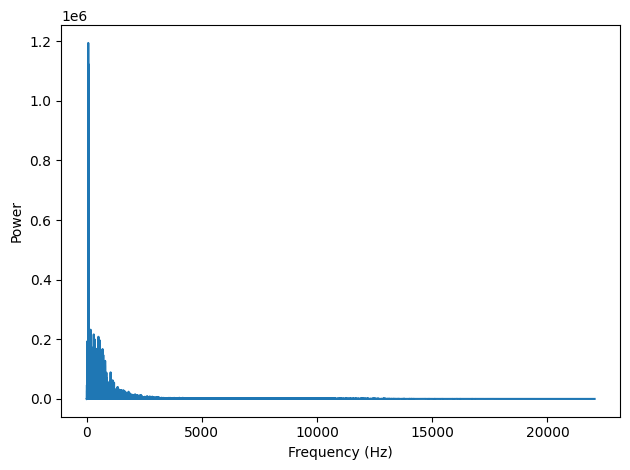

In [ ]:
spectrum = segment.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)', ylabel='Power')

Шум, представленный на графике не может относиться к разряду UU-шумов, так как у них мощность на всех частотах распределена одинаково, в то время, как на полученном спектре мощность убывает, при этом, в начале она убывает резко, а затем медленнее, что может свидетельствовать о том, что она пропорциональна $1/f$. Это может быть ***розовый шум*** или ***красный шум*** (не *броуновский шум*, т.к. он состоит почти полностью из низких  частот и его спектр не будет растянут на большой промежуток частот).

Чтобы проверить предположение, рассмотрим спектр мощности в логарифмическом масштабе:

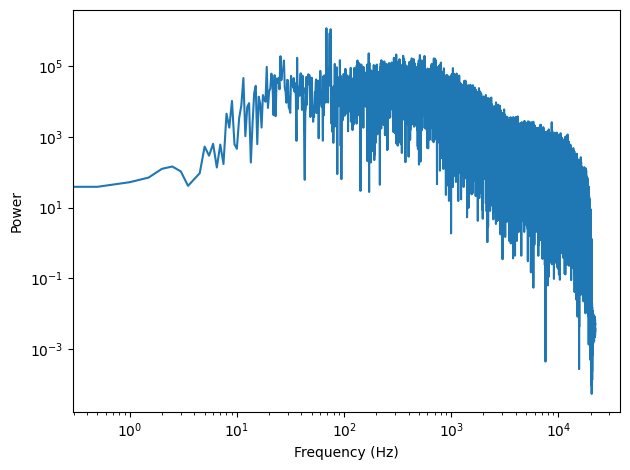

In [ ]:
spectrum.plot_power()

loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)', ylabel='Power', **loglog)

Дааная спектрограмма имеет необычную структуру, т.к. её амплитуда сначала возрастает, а затем уменьшается.

Чтобы увидеть как меняется спектр со временем, воспользуемся тем, что запись имее доставточно большую длину и рассмотрим другой сегмент времени, проделав с ним те же действия, что и с первым.

Выведем 2ю звуковую дорожку со спектрограммой рассматриваемого сегмента:

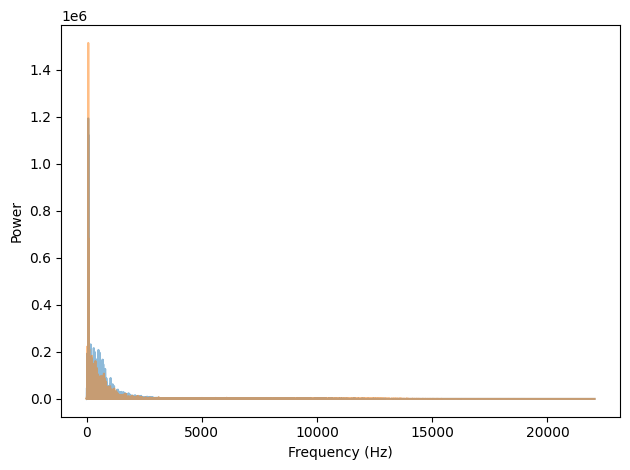

In [ ]:
segment2 = wave.segment(start=4.0, duration=2.0)
spectrum2 = segment2.make_spectrum()

spectrum.plot_power(alpha=0.5)
spectrum2.plot_power(alpha=0.5)
decorate(xlabel='Frequency (Hz)', ylabel='Power')

segment2.make_audio()

Аналогично тому, как действовали в прошлый раз, выведем спектр мощности в логарифмическом масштабе:

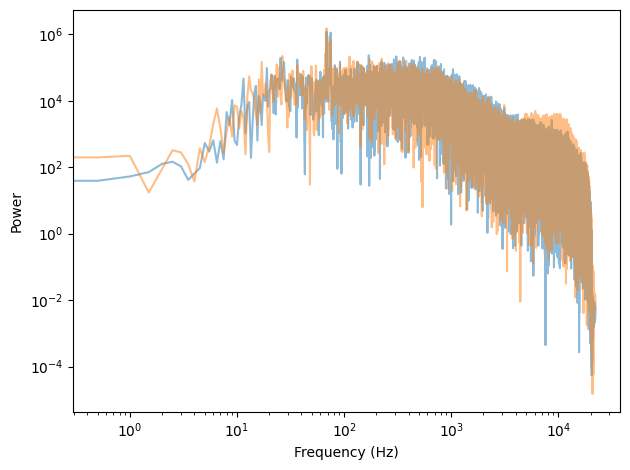

In [ ]:
spectrum.plot_power(alpha=0.5)
spectrum2.plot_power(alpha=0.5)
decorate(xlabel='Frequency (Hz)', ylabel='Power', **loglog)

Структура не изменилась. В качестве финаольного теста возьмём ещё один сегмент для чистоты исследования:

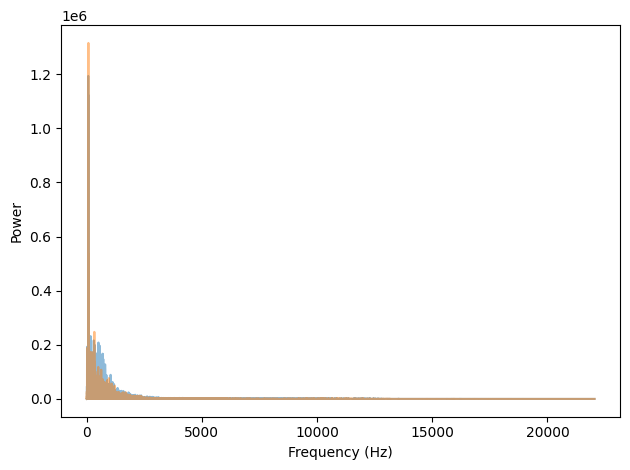

In [ ]:
segment3 = wave.segment(start=7.7, duration=2.0)
spectrum3 = segment3.make_spectrum()

spectrum.plot_power(alpha=0.5)
spectrum3.plot_power(alpha=0.5)
decorate(xlabel='Frequency (Hz)', ylabel='Power')

segment3.make_audio()

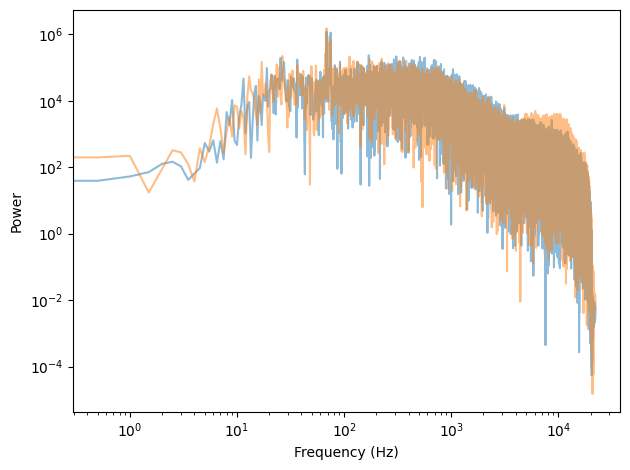

In [ ]:
spectrum.plot_power(alpha=0.5)
spectrum2.plot_power(alpha=0.5)
decorate(xlabel='Frequency (Hz)', ylabel='Power', **loglog)

Таким образом, структура шума кажется неизменной с течением времени. Также, выведем для каждого из спектров их спектрограммы и сравним их:

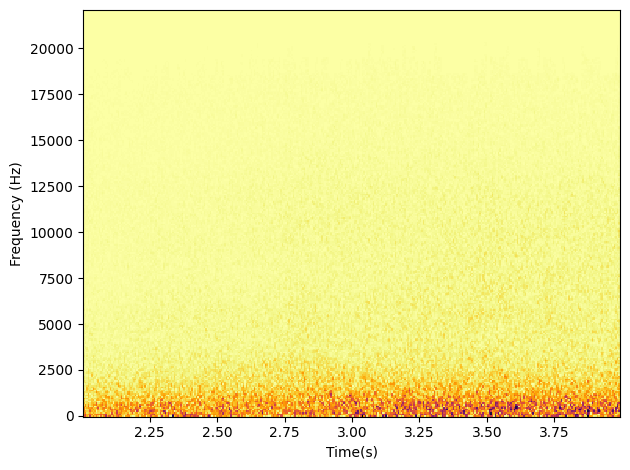

In [ ]:
segment.make_spectrogram(512).plot()
decorate(xlabel='Time(s)', ylabel='Frequency (Hz)')

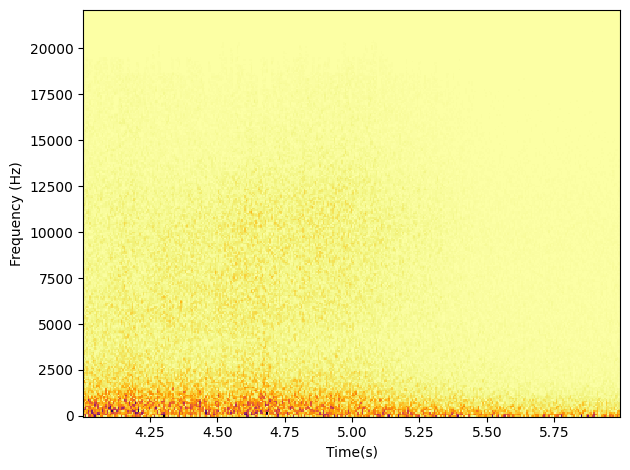

In [ ]:
segment2.make_spectrogram(512).plot()
decorate(xlabel='Time(s)', ylabel='Frequency (Hz)')

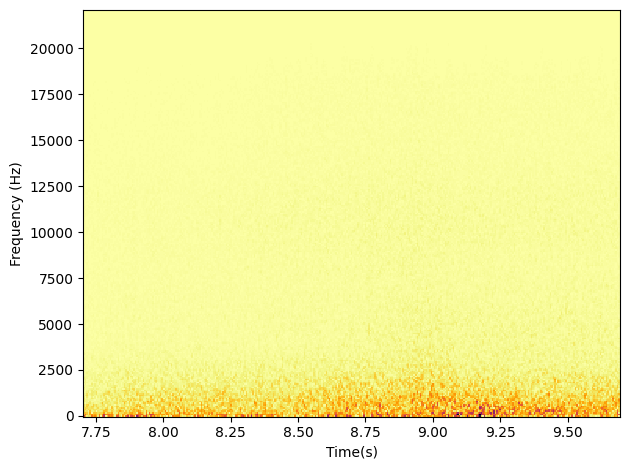

In [ ]:
segment3.make_spectrogram(512).plot()
decorate(xlabel='Time(s)', ylabel='Frequency (Hz)')

В 1ом сегменте общая амплитуда падала, во 2ом сегменте она оставалась практически неизменной, а в 3ем - возрастала. Но, вне зависимости от того как вела себя амплитуда, смесь частот оставалась однородной

## lab 4.2
___

**Задача**: Реализовать метод Бартлетта и использовать его для оценки спектра мощности шумового сигнала.

Подсказка: посмотреть на реализацию `make_spectrogram`.

* Метод Бартлетта - это метод спектрального анализа, используемый для оценки спектральной плотности мощности (PSD) сигнала, особенно когда работа с прямыми оценками PSD может быть ненадежной, например, с шумоподобными сигналами.

In [ ]:
from thinkdsp import Spectrum

def bartlett_method(wave, seg_length=512, win_flag=True):
    """Оценивает спектр мощности шумовой волны.

    seg_length: длимна сегмента
    """
    # Разбиваем сигнал wave на перекрывающиеся сегменты (длины seg_length),
    # вычисляем периодo для каждого сегмента (с или без оконной функции
    # win_flag) и объединяем их в объект spectrogram
    spectro = wave.make_spectrogram(seg_length, win_flag)
    spectrums = spectro.spec_map.values() # Извлекаем отдельные объекты spectrum из spectrogram

    # Вычисляем массив мощности для каждого spectrum и сохраняем их в списке psds
    psds = [spectrum.power for spectrum in spectrums]

    # Расчет среднеквадратичного (RMS) значения мощности
    hs = np.sqrt(sum(psds) / len(psds))
    fs = next(iter(spectrums)).fs

    # make a Spectrum with the mean amplitudes
    spectrum = Spectrum(hs, fs, wave.framerate)
    return spectrum

Таким образом, только что напичсанная ф-ция `barlet_method` разбивает сигнал на сегменты, вычисляет их периодграммы и усредняет их, чтобы получить более устойчивую к шуму оценку спектра мощности.
Возвращает объект `Spectrum`, содержащий эту оценку, позволяя анализировать распределение мощности в сигнале.

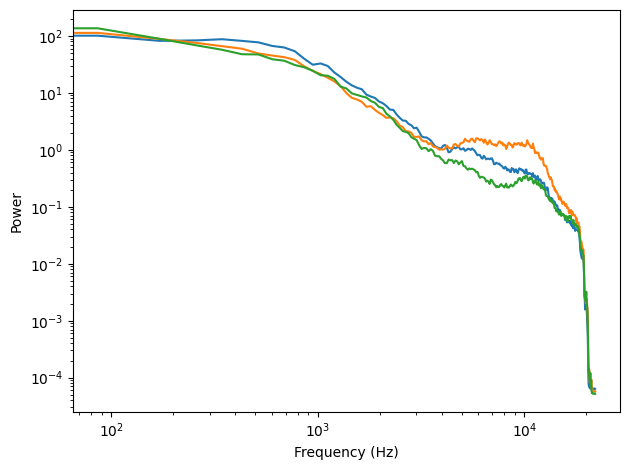

In [ ]:
psd = bartlett_method(segment)
psd2 = bartlett_method(segment2)
psd3 = bartlett_method(segment3)

psd.plot_power()
psd2.plot_power()
psd3.plot_power()

decorate(xlabel='Frequency (Hz)', ylabel='Power', **loglog)

После построения ф-ции Барлетта можно увидеть чёткую зависимость мощности от частоты. Зависимость не является линейной, но для всех 3-х сегментов она одинакова.

## ldb 4.3
___

**Задача**: скачать с [сайта](https://www.coindesk.com/price/) CSV файл с историческими данными о ежедневней цене BitCoin. Открыть этот файл и вычислить спектр цен BitCoin как ф-цию времени. Понять похоже ли это на белый, розовый или броуновский шум?

In [ ]:
if not os.path.exists('BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv'):
    !wget https://github.com/AllenDowney/ThinkDSP/raw/master/code/BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv

--2024-02-14 19:33:47--  https://github.com/AllenDowney/ThinkDSP/raw/master/code/BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv [following]
--2024-02-14 19:33:47--  https://raw.githubusercontent.com/AllenDowney/ThinkDSP/master/code/BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 143622 (140K) [text/plain]
Saving to: ‘BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv’

BTC_USD_2013-10-01_ 100%[===================>] 140.26K  --.-KB/s    in 0.03

Составим таблицу, используя только что загруженный файл, где будет содержаться информация стоимость BitCoin до начала торгов и после их окончания

In [ ]:
import pandas as pd

df = pd.read_csv('BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv', parse_dates=[0])
df

,Currency,Date,Closing Price (USD),24h Open (USD),24h High (USD),24h Low (USD)
0,BTC,2013-10-01,123.654990,124.304660,124.751660,122.563490
1,BTC,2013-10-02,125.455000,123.654990,125.758500,123.633830
2,BTC,2013-10-03,108.584830,125.455000,125.665660,83.328330
3,BTC,2013-10-04,118.674660,108.584830,118.675000,107.058160
4,BTC,2013-10-05,121.338660,118.674660,121.936330,118.005660
...,...,...,...,...,...,...
2354,BTC,2020-03-22,5884.340133,6187.042146,6431.873162,5802.553402
2355,BTC,2020-03-23,6455.454688,5829.352511,6620.858253,5694.198299
2356,BTC,2020-03-24,6784.318011,6455.450650,6863.602196,6406.037439
2357,BTC,2020-03-25,6706.985089,6784.325204,6981.720386,6488.111885


Построим график закрывающей цены за период, приведенной в таблице:

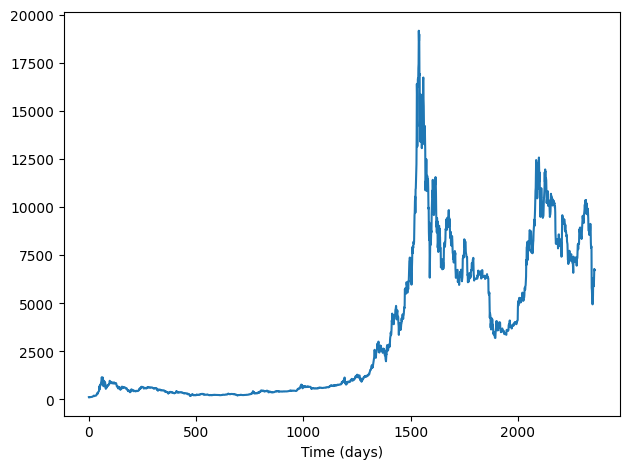

In [ ]:
ys = df['Closing Price (USD)']
ts = df.index

wave = Wave(ys, ts, framerate=1)
wave.plot()
decorate(xlabel='Time (days)')

Аналогично с тем как делали до этого, выведем спектр мощности в логарифмическом масштабе:

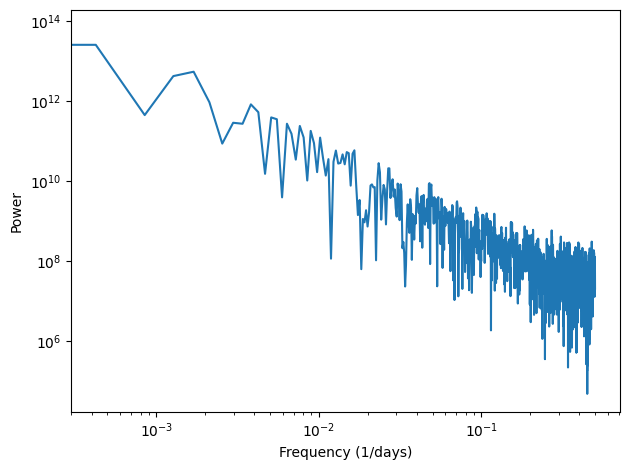

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (1/days)', ylabel='Power', **loglog)

На данном спектре можно увидеть, что мощность по мере увеличения частоты убывает, а это означает, что данный график схож со спектром розового или красного шума. Так как в данном случае мощность постоянно убывает (если брать усреднённые значения на промежутках частот), можем воспользоваться функцией `estimate_slope()`, которая наследуется из `spectrum`:

In [ ]:
spectrum.estimate_slope()[0]

-1.7332540936758951

Так как получившийся коэф. наклона = $-1.73$, сложно сделать вывод о том, является ли данный шум красным.

*Возможно, данный пример спектра схож больше с розовым шумом, т.к. он имеет меньший наклон($k=-1$), нежели красный ($k=-2$).

## lab 4.4
___

**Задача**: Счетчик Гейгера — это устройство, которое обнаруживает радиацию. Когда ионизирующая частица попадает на детектор, он выдает всплеск тока. Общий выходной сигнал в определенный момент времени можно смоделировать как некоррелированный шум Пуассона (UP), где каждая выборка представляет собой случайную величину из распределения Пуассона, которая соответствует количеству частиц, обнаруженных в течение интервала.

Написать класс `UncorrelatedPoissonNoise`, который наследует `_Noise` и предоставляет `evaluate`. Следует использовать `np.random.poisson` для генерации случайных значений из распределения Пуассона. Параметр этой функции `lam` — среднее количество частиц в каждом интервале. Можно использовать атрибут `amp` для указания `lam`. Например, если частота кадров 10 кГц и `amp` равна 0,001, мы ожидаем около 10 «щелчков»/с.

Сгенерировать примерно секунду шума UP и послушать его. Для низких значений `amp`, например 0,001, это должно звучать как счетчик Гейгера. При более высоких значениях звук должен звучать как белый шум. Вычислить и построить спектр мощности, чтобы увидеть, похож ли он на белый шум.

In [ ]:
from thinkdsp import Noise

class UncorrelatedPoissonNoise(Noise):
    """Представляет некоррелированный шум Пуассона."""

    def evaluate(self, ts):
        """Оценивает сигнал в заданное время.

         ts: массив чисел с плавающей запятой

         returns: волновой массив с плавающей запятой
         """
        ys = np.random.poisson(self.amp, len(ts))
        return ys

### Низкий уровень радиации

Рассмотрим как будет звучать счётчик Гейгера при низком уровне радиации (частота = 10 кГц; `amp` = 0.001, т.е. около 10 "щелчков"/с)

In [ ]:
amp = 0.001
framerate = 10000 # частота 10 кГц
duration = 1 # Длина = 1 секунде

signal = UncorrelatedPoissonNoise(amp=amp)
wave = signal.make_wave(duration=duration, framerate=framerate)
wave.make_audio()

Если найти в интернете как звучит реальный счётчик Гейгера, то можно убедиться в том, что получилось добиться схожего звучания.

Убедимся в том, что ожидаемое количество частиц (10) совпадает с действительным. Для этого посчитаем число эл-ов в массиве `ys`:

In [ ]:
expected = amp * framerate * duration
actual = sum(wave.ys)
print(f"Количество щелчков:\nExpected = {expected}\nActual = {actual}")

Количество щелчков:
Expected = 10.0
Actual = 10


Точное значение будет получаться не всегда (из-за случайных значений из распределения Пуассона), однако, оно всегда будет примерно таким же, как и ожидаемое. Для наглядности изобразим то, как будет выглядить `wave`:

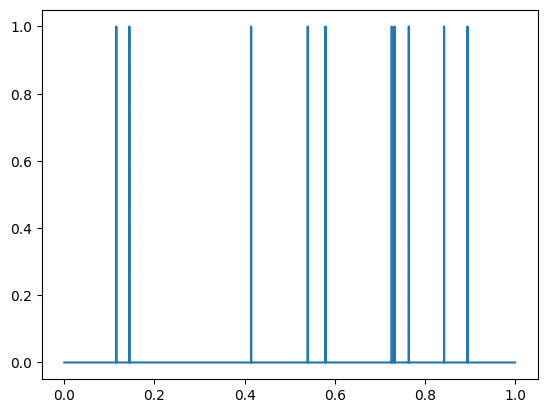

In [ ]:
wave.plot()

Приведём теперь разложение в спектр мощности в логарифмическом масштабе по аналогии с тем, как делали это в предыдущих пунктах:

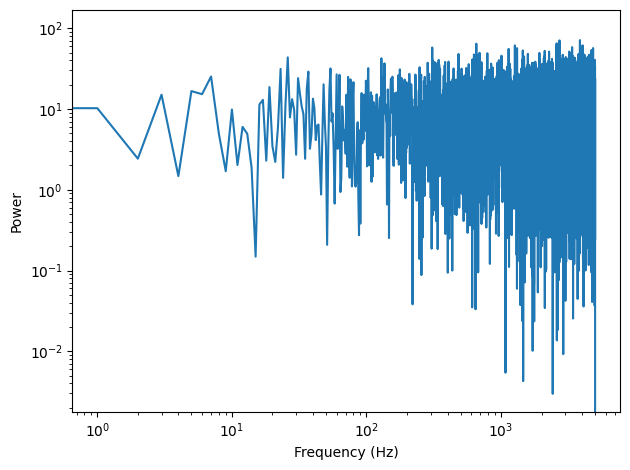

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)',
         ylabel='Power',
         **loglog)

Заметим, что амплитуда получившегося спектра возрастает, а наклон PSD примерно равен нулю, т.к. если усреднять значения мощности в малых промежутках частоты, то получим лини почти параллельную оси абсцисс (коэф. наклона = 0). Таким образом, этот спектр напоминает белый шум.

### Высокий уровень радиации

Рассмотрим случай с высоким уровнем радиации ($amp = 1.0$). Таким образом, интенсивность будет в 1000 раз больше, чем в прошлый раз

In [ ]:
amp = 1 # интенсивность
framerate = 10000
duration = 1

signal = UncorrelatedPoissonNoise(amp=amp)
wave = signal.make_wave(duration=duration, framerate=framerate)
wave.make_audio()

Данный звуковой файл похож на будый шум. Выведем его спкетр, чтобы убедитья в этом:

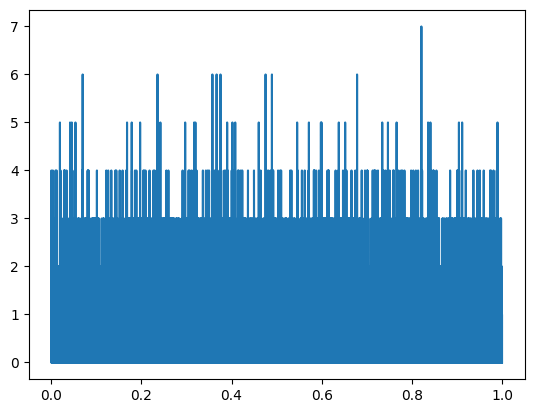

In [ ]:
wave.plot()

Когда речь идёт о белом шуме, не всегда имеется ввиду UU-шум. В таких случаях часто имеется ввиду ***некорелированный гаусов шум*** (UG). Именное его можно наблюдать на получившемся графике спектра.

* UG-шум многим похож на UU-шум. У спектра одинаковая средняя мощность на всех частотах, поэтому UG-шум также белый. Но есть интересное свойство: спектр UG-шума - также UG-шум. Точнее, действительные и мнимые части спектра некоррелированные гауссовы значения.

Проверим предположение о том, что это UG-шум:
* Сгенерируем спектр UG-шума и "кривую нормального распределения вероятности" (для этого воспользуемся кодом, представленным в репозитории учебного пособия);
* Сравним полученные графики, чтобы понять будет ли распределение гаусовским (UG-шум).

In [ ]:
def normal_prob_plot(sample, fit_color='0.8', **options):
    """Создает нормальный вероятностный график с подобранной линией.

    sample: последовательность чисел
    fit_color: назначение цвета для выбранной линии
    options: переданы в Plot
    """
    # Генерация нормально распределенных случайных значений для оси x
    n = len(sample)
    xs = np.random.normal(0, 1, n)
    xs.sort()

    # Сортировка значений выборки для оси y
    ys = np.sort(sample)

    # Подгонка линии к данным
    mean, std = np.mean(sample), np.std(sample)
    fit_ys = mean + std * xs

    # Построение линии модели (серая линия)
    plt.plot(xs, fit_ys, color='gray', alpha=0.5, label='model')

    # Построение вероятностного графика с использованием переданных параметров
    plt.plot(xs, ys, **options)

Построим график для **действительной** части спектра гауссова шума:

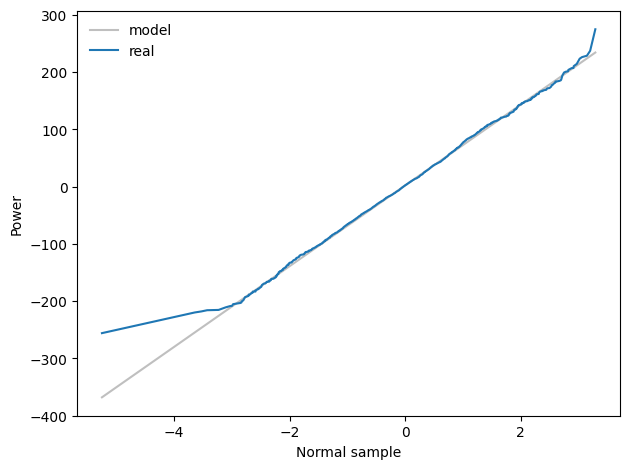

In [ ]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0

normal_prob_plot(spectrum.real, label='real')
decorate(xlabel='Normal sample',
        ylabel='Power')

Построим график для **мнимой** части спектра гауссова шума:

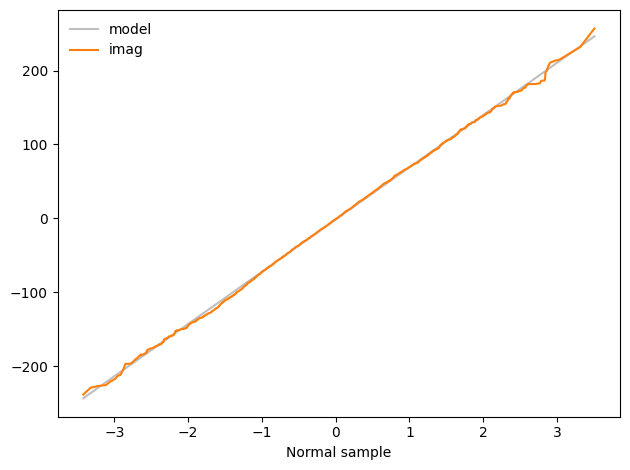

In [ ]:
normal_prob_plot(spectrum.imag, label='imag', color='C1')
decorate(xlabel='Normal sample')

* Серая линия - усреднённая линейная модель данных
* Цветная яркая линия - линия полученных данных

Прямая линия на графике нормальной вероятности показывает, что данные были взяты из гауссова распределения. Как видно из полученных графиков, мнимая часть спектра почти в точности совпадает с усреднённой линией модели данных (такие колебания линии данных, которые находятся, например, в районе -3 не играют большого значения, т.к. они слишком малы). В действительная части спектра гаусовского шума на концах линии различаются, однако, в остальной(основной) части они практически совпадают.

Таким образом, на основе полученных графиков, можно сделать ваывод о том, что при рассмотрении высокой степени радиации на счётчике Гейгера будет слышен **UG-шум** (некоррелированный гаусов шум).

## lab 4.5
___

**Задача**: Существуют более эффективные способы генерации розового шума, например алгоритм *Voss-McCartney*. Нужно изучить этот способ, реализовать его, вычислить спектр результата и убедиться, что соотношение между мощностью и частотой соответствующее.

Алгоритм Voss-McCartney был предложен Роджером Воссом (Roger Voss) и Мэттом Маккартни (Matt McCartney). Он основан на идее объединения белого шума нескольких источников с различными частотными характеристиками для создания розового шума. Этот метод вдохновлен статистическими свойствами музыкальных произведений, где различные частоты вносят разные вклады в общий сигнал.

Шаги алгоритма Voss-McCartney:

1. Задается количество уровней (глубина) и количество отсчетов.
2. Создается матрица с размерами "глубина x количество отсчетов", заполненная случайным белым шумом.
3. Выполняется процедура "подъема" (up-sweep): суммируются значения вдоль столбцов, начиная с верхних строк. Каждый новый элемент получается как среднее арифметическое двух соседних элементов. Это приводит к уменьшению высокочастотной компоненты и увеличению низкочастотной. Иными словами, происходит суммирование случайных чисел, которые обновляются с разной частотой дискретизации.
4. Повторяется шаг 3 для каждого уровня.
5. Получившиеся значения преобразуются в одномерный массив, представляющий розовый шум.

Этот метод позволяет эффективно генерировать розовый шум с более равномерным распределением энергии по различным частотам.

Итоговый код выглядит следующим образом:

In [ ]:
import numpy as np
import pandas as pd

def voss_mccartney_pink_noise(nrows, ncols=16):
    """
    Генерирует розовый шум с использованием алгоритма Восса-Маккартни.

    Параметры:
    - nrows (int): Количество значений для генерации.
    - ncols (int): Количество случайных источников (по умолчанию 16).

    Возвращает:
    - NumPy array: Массив, представляющий розовый шум.
    """

    # Шаг 1: Инициализация матрицы с NaN значениями, заполнение первой строки и столбца случайными значениями.
    array = np.empty((nrows, ncols))
    array.fill(np.nan)
    array[0, :] = np.random.random(ncols)  # Заполнение первой строки случайными значениями.
    array[:, 0] = np.random.random(nrows)  # Заполнение первого столбца случайными значениями.

    # Шаг 2: Случайный выбор позиций, где происходят изменения случайных источников.
    n = nrows
    cols = np.random.geometric(0.5, n)  # Геометрическое распределение для числа изменений.
    cols[cols >= ncols] = 0  # Если выбрано больше столбцов, чем есть в матрице, устанавливаем в 0.
    rows = np.random.randint(nrows, size=n)

    # Шаг 3: Заполнение матрицы случайными значениями на выбранных позициях.
    array[rows, cols] = np.random.random(n)

    # Шаг 4: Преобразование в DataFrame для использования метода fillna.
    df = pd.DataFrame(array)
    df.fillna(method='ffill', axis=0, inplace=True)  # Заполнение NaN с использованием предыдущих значений.

    # Шаг 5: Суммирование значений вдоль столбцов для получения розового шума.
    total = df.sum(axis=1)

    return total.values

### Пояснения к работе функции

In [ ]:
import numpy as np

def initialize_matrix(levels, columns):
    return np.random.rand(levels, columns)

- `initialize_matrix` - это функция, создающая и возвращающая двумерную матрицу размера `levels` x `columns`.
- `np.random.rand(levels, columns)` - генерирует случайные числа в диапазоне [0, 1] для каждого элемента матрицы.

In [ ]:
def generate_step(matrix):
    for row in range(matrix.shape[0]):
        matrix[row, :-1] = (matrix[row, :-1] + matrix[row, 1:]) / 2
        matrix[row, -1] = np.random.rand()

- `generate_step` - функция, которая проходит по каждой строке матрицы и выполняет шаг генерации и сглаживания.
- `matrix[row, :-1]` - обновляет значения внутри строки, вычисляя среднее для каждой пары соседних значений.
- `matrix[row, -1] = np.random.rand()` - добавляет новое случайное значение в конец строки.

In [ ]:
def normalize_matrix(matrix):
    return (matrix - np.min(matrix)) / (np.max(matrix) - np.min(matrix))

- `normalize_matrix` - функция, нормализующая матрицу так, чтобы значения оказались в диапазоне [0, 1].
- `(matrix - np.min(matrix)) / (np.max(matrix) - np.min(matrix))` - применяет формулу нормализации для каждого элемента матрицы.

In [ ]:
rows = 16  # Количество уровней
columns = 11025  # Количество случайных чисел для каждого уровня

In [ ]:
# Инициализация
matrix = initialize_matrix(rows, columns)

# Просмотр начальной матрицы
print("Initial Matrix:")
print(matrix)

Initial Matrix:
[[0.34765559 0.76853703 0.12149696 ... 0.01613664 0.7045968  0.50929243]
 [0.58884841 0.50571951 0.62479148 ... 0.45257035 0.64431022 0.63414595]
 [0.26595618 0.19178117 0.07793162 ... 0.08603466 0.27391403 0.13056226]
 ...
 [0.82330241 0.86068041 0.79776004 ... 0.85372645 0.97944242 0.1755466 ]
 [0.55068533 0.88122339 0.25680989 ... 0.59454648 0.58011442 0.3840091 ]
 [0.3085009  0.23385783 0.89071127 ... 0.29094314 0.05528193 0.084723  ]]


In [ ]:
# Генерация и сглаживание
for i in range(rows):
    generate_step(matrix)
    # Просмотр текущей матрицы после каждого шага
    print(f"\nMatrix after {i + 1} iterations:")
    print(matrix)


Matrix after 1 iterations:
[[0.55809631 0.44501699 0.44513297 ... 0.36036672 0.60694462 0.60247878]
 [0.54728396 0.56525549 0.39691901 ... 0.54844029 0.63922809 0.97567538]
 [0.22886867 0.1348564  0.36109406 ... 0.17997434 0.20223814 0.43820733]
 ...
 [0.84199141 0.82922023 0.62372262 ... 0.91658443 0.57749451 0.64985059]
 [0.71595436 0.56901664 0.41417314 ... 0.58733045 0.48206176 0.95847978]
 [0.27117937 0.56228455 0.83589408 ... 0.17311254 0.07000246 0.43545122]]

Matrix after 2 iterations:
[[0.50155665 0.44507498 0.51569167 ... 0.48365567 0.6047117  0.45932472]
 [0.55626973 0.48108725 0.49019213 ... 0.59383419 0.80745173 0.74286377]
 [0.18186254 0.24797523 0.47570146 ... 0.19110624 0.32022274 0.85200124]
 ...
 [0.83560582 0.72647142 0.57744858 ... 0.74703947 0.61367255 0.0683007 ]
 [0.6424855  0.49159489 0.37262356 ... 0.5346961  0.72027077 0.73761506]
 [0.41673196 0.69908932 0.68194652 ... 0.1215575  0.25272684 0.33572775]]

Matrix after 3 iterations:
[[0.47331582 0.48038333 0.55

In [ ]:
# Нормализация
normalized_matrix = normalize_matrix(matrix)

# Просмотр нормализованной матрицы
print("\nNormalized Matrix:")
print(normalized_matrix)


Normalized Matrix:
[[0.52907852 0.49408326 0.45851158 ... 0.45392462 0.46684582 0.58976192]
 [0.76808687 0.69128036 0.62275714 ... 0.50559444 0.26969417 0.11003643]
 [0.56427514 0.53388862 0.47991024 ... 0.55325994 0.49938399 0.50594619]
 ...
 [0.61793535 0.59491076 0.54314958 ... 0.6060268  0.59081888 0.32653544]
 [0.55181523 0.5365366  0.51421556 ... 0.55121836 0.50499368 0.36907417]
 [0.45734856 0.50289312 0.52174849 ... 0.40197964 0.25200926 0.50363626]]


In [ ]:
# Преобразование в одномерный массив
flattened_array = normalized_matrix.flatten()

# Просмотр одномерного массива
print("\nFlattened Array:")
print(flattened_array)


Flattened Array:
[0.52907852 0.49408326 0.45851158 ... 0.40197964 0.25200926 0.50363626]


### Исследование маленькой выборки

Чтобы проверить получившуюся ф-цию, введём значения `rows = 16` и `cols = 11025`

In [ ]:
ys = voss_mccartney_pink_noise(nrows=11025, ncols=16)
ys

array([8.49397615, 8.51957588, 8.76523211, ..., 8.60562498, 9.03710218,
       9.14911645])

Возьмём полученные значения массива и превратим их в волну:

In [ ]:
wave = Wave(ys)
wave.unbias()
wave.normalize()

Распечатаем спектр

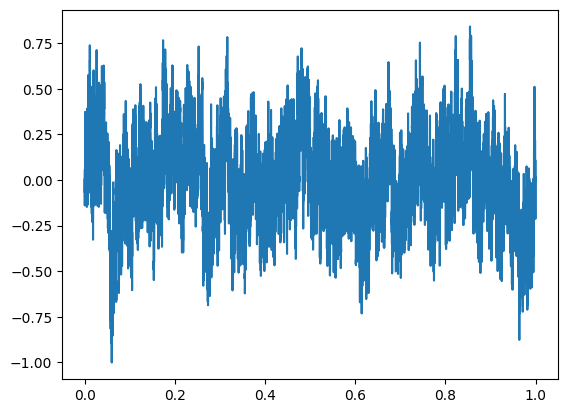

In [ ]:
wave.plot()

Как и ожидалось, полученный спектр больше похож на случайные значения, чем на белый шум, но более хаотичен и разрознинен, чем красный шум. Выведем звуковой файл полученного спектра:

In [ ]:
wave.make_audio()

Для большей наглядности приведём теперь разложение в спектр мощности в логарифмическом масштабе по аналогии с тем, как делали это в предыдущих пунктах:

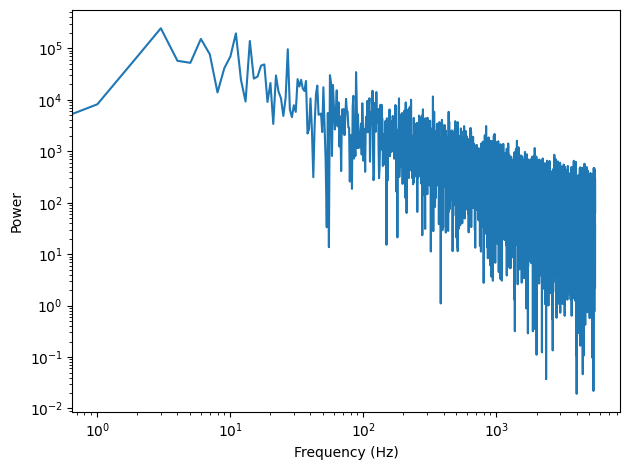

In [ ]:
spectrum = wave.make_spectrum()
spectrum.hs[0] = 0
spectrum.plot_power()
loglog = dict(xscale='log', yscale='log')
decorate(xlabel='Frequency (Hz)', ylabel='Power', **loglog)

Выведем коэффициент наклона:

In [ ]:
spectrum.estimate_slope().slope

-1.021709265670479

Получившийся коэф. наклона $k=0.98$. Это значение приблизительно равно 1, что соответсвует наклону PSD для розового шума.

### Исследование большой выборки

In [5]:
def voss(nrows, ncols=16):
    """Generates pink noise using the Voss-McCartney algorithm.
    
    nrows: number of values to generate
    rcols: number of random sources to add
    
    returns: NumPy array
    """
    array = np.empty((nrows, ncols))
    array.fill(np.nan)
    array[0, :] = np.random.random(ncols)
    array[:, 0] = np.random.random(nrows)
    
    # the total number of changes is nrows
    n = nrows
    cols = np.random.geometric(0.5, n)
    cols[cols >= ncols] = 0
    rows = np.random.randint(nrows, size=n)
    array[rows, cols] = np.random.random(n)

    df = pd.DataFrame(array)
    df.fillna(method='ffill', axis=0, inplace=True)
    total = df.sum(axis=1)

    return total.values

Чтобы подкрепить полученные результаты сделаем более длинную выборку:

In [ ]:
seg_length = 64 * 1024
iters = 100
wave = Wave(voss(seg_length * iters))
len(wave)

6553600

Воспользуемся методом Барлетта (ф-ция написана в пункте 4.2) для вычисления среднего значения:

In [ ]:
spectrum = bartlett_method(wave, seg_length=seg_length, win_flag=False)
spectrum.hs[0] = 0
len(spectrum)

32769

Выведем спектр мощности в логарифмическом масштабе:

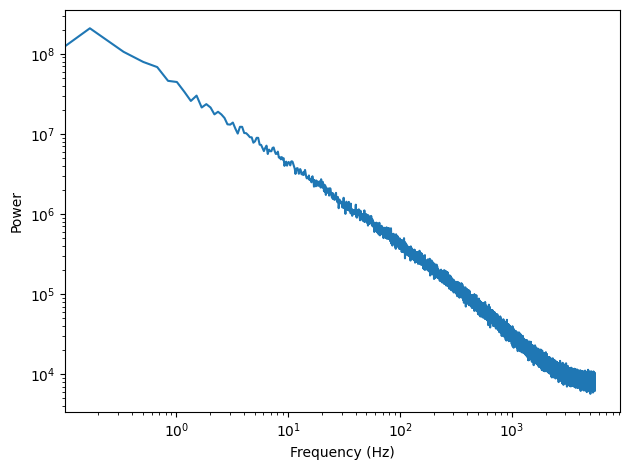

In [ ]:
spectrum.plot_power()
decorate(xlabel='Frequency (Hz)', ylabel='Power', **loglog)

In [ ]:
spectrum.estimate_slope()[0]

-1.0016335491194621

При рассматривании большой выборки коэффициент наклона PSD принял значение ещё более близкое к -1, что свидетельствет о том, что функция, описывающая метод `Voss-McCartney`, работает корректно и выводит значения соответствующие розовому уровню шума

# lab 5 - Автокорреляция
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/blob/main/lab5/thinkdsp.py

In [ ]:
from matplotlib import pyplot as plt
from thinkdsp import read_wave, decorate, Wave, Spectrum
from thinkdsp import TriangleSignal

import numpy as np
import pandas as pd

## lab 5.2
___

**Задача**: Пример кода в `chap05.ipynb` показывает, как использовать автокоррекцию для основной частоты периодического сигнала. Инкапсилирровать этот код в функцию под названием `estimate_fundamental`, и использовать его для отследивания высоты записанного звука.

Чтобы увидеть, насколько хорошо это работает, попробовать наложить оценки высоты тона на спектрограмму записи.

In [ ]:
if not os.path.exists('voice_down_bew.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/voice_down_bew.wav

Создадим фрагмент только что загруженного аудио файла:

In [ ]:
wave = read_wave('voice_down_bew.wav')
wave.normalize()
wave.make_audio()

Выведем спектрограмму для записи созданного вокального чирпа:

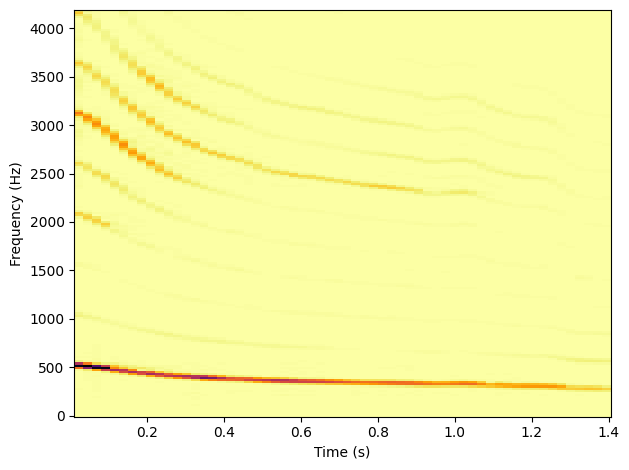

In [ ]:
spectr = wave.make_spectrogram(seg_length=2048)
spectr.plot(high=4200)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

Функция `autocorr` вычисляет и строит автокорреляционную функцию для заданного звукового сигнала. Автокорреляционная функция показывает степень корреляции между сигналом и его лагированными копиями при различных задержках (лагах). В результате выполнения функции, она возвращает массивы `lags` и `corrs`, содержащие значения лагов и соответствующих автокорреляций.

In [ ]:
def autocorr(wave):
    """Computes and plots the autocorrelation function.

    wave: Wave
    """
    lags = np.arange(len(wave.ys)//2)
    corrs = [serial_corr(wave, lag) for lag in lags]
    return lags, corrs

Функция `serial_corr` вычисляет последовательную корреляцию (автокорреляцию) заданной волны с определенным лагом. Она сдвигает волну на указанное количество отсчетов и затем вычисляет коэффициент корреляции между исходной волной и сдвинутой версией. Этот коэффициент представляет собой степень линейной связи между исходной волной и ее лагированной версией.

In [ ]:
def serial_corr(wave, lag=1):
    """Computes serial correlation with given lag.

    wave: Wave
    lag: integer, how much to shift the wave

    returns: float correlation coefficient
    """
    n = len(wave)
    y1 = wave.ys[lag:]
    y2 = wave.ys[:n-lag]
    corr_mat = np.corrcoef(y1, y2)
    return corr_mat[0, 1]

Создадим функцию `estimate fundamental` которая будет принимать волну, начало записи, длину для анализа и промежуток в котором происходит поиск пиковой частоты:

In [ ]:
def estimate_fundamental(wave, start, duration=0.01, low = 50, high = 150):
    segment = wave.segment(start=start, duration=duration)
    lags, corrs = autocorr(segment)
    lag = np.array(corrs[low:high]).argmax() + low
    return 1 / (lag / segment.framerate)

Эта функция использует `autocorr` - функцию, предоставленную автором пособия. На полученных значениях мы выбираем заданный промежуток `corros[low:high]` и получаем максимальное значение, после чего переводим lag в частоту и возвращаем её.

Как и ожидалось, полученная спектрограмма убывает в соответствии с частотой звука в аудио файле. Теперь воспользуемся разработанной функцией и создадим график изменения основной
частоты этого чирпа:

Теперь воспользуемся разработанной функцией и создадим график изменения основной
частоты этого чирпа.

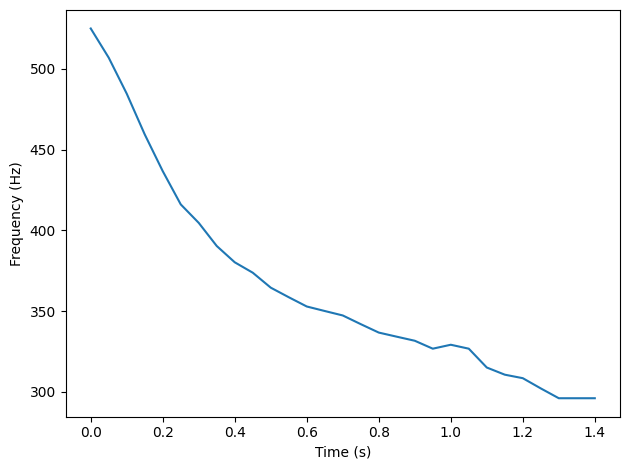

In [ ]:
x = np.arange(0, wave.duration, 0.05)
y = [estimate_fundamental(wave, start) for start in x]
plt.plot(x, y)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

Как мы видим, частота чирпа меняется с 530 до 300. Проверим корректность наших расчетов, наложив этот график на спектрограмму, полученную ранее

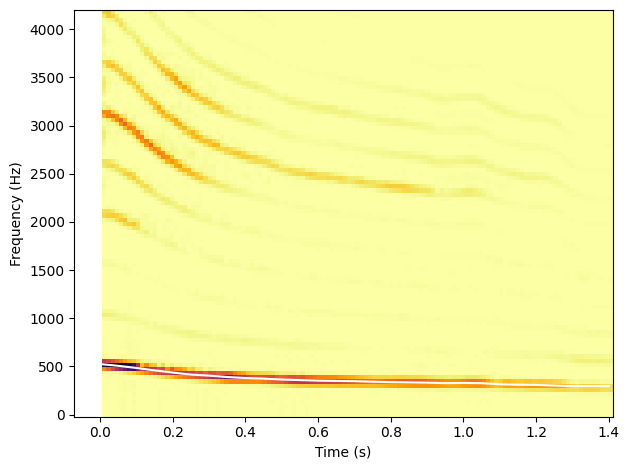

In [ ]:
plt.plot(x, y, color='white')
spectro.plot(high=4200)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

Как мы видим, график накладывается идеально в центр темной зоны спектрограмма, т. е. на самую высокую частоту, как и ожидалось.

## lab 5.3
___

**Задача**: Для упражнений в предыдущей главе были нужны исторические цены BitCoins, и надо было оценить спектр мощности изменения цен. Используя те же данные, необходимо вычислить автокорреляцию цен в платёжной системе Bitcoin. Понять, быстро ли спадает автокорреляционная функция. Есть ли признаки периодического процесса?

In [ ]:
if not os.path.exists('BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv

In [ ]:
df = pd.read_csv('BTC_USD_2013-10-01_2020-03-26-CoinDesk.csv', parse_dates=[0])

ys = df['Closing Price (USD)']
ts = df.index

Проанализируем  и выведем график изменений цен биткоина:

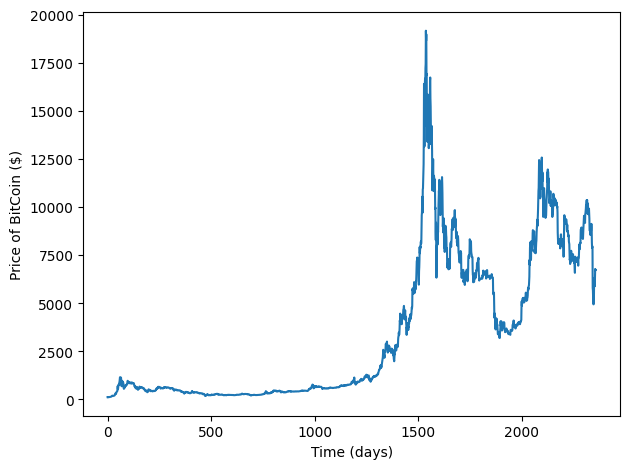

In [ ]:
wave = Wave(ys, ts, framerate=1)
wave.plot()
decorate(xlabel='Time (days)', ylabel='Price of BitCoin ($)')

В прошлый раз анализ производился, сравнивая изменение цен с шумом, и мы пришли к выводу, что это розовый шум. Повторим анализ, на этот раз используя автокорреляцию. Для наглядности выведем график автокорреляции:

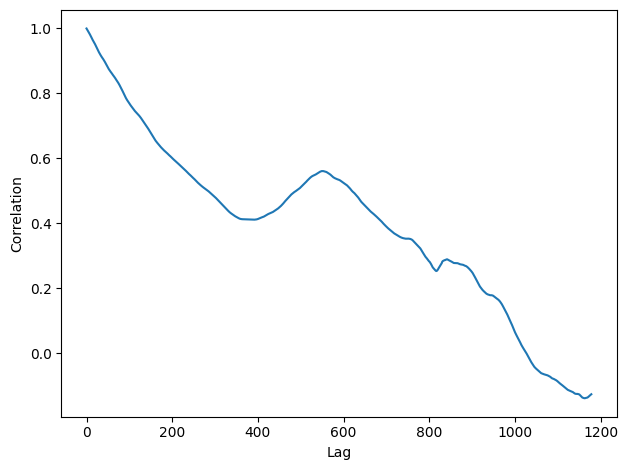

In [ ]:
lags, corrs = autocorr(wave)
plt.plot(lags, corrs)
decorate(xlabel='Lag', ylabel='Correlation')

Как мы видим, данный процесс не похож на периодический, а скорее напоминает обычный розовый шум, при $𝛽$ близкой к 1.7, что мы и получали в прошлых

In [ ]:
spectrum = wave.make_spectrum()
spectrum.estimate_slope()[0]

-1.7332540936758951

## lab 5.4
___

**Задача**: В блокноте под назваинем `saxopohne.ipynb`, в котором исследуется автокорреляция, восприятие высоты тона и явление, называемое *подавленная основная*. Прочесть блокнот и "погонять" примеры. Выбрать другой сегмент записи и снова поработать с примерами.

Скачаем необходимую запись саксофона:

In [ ]:
if not os.path.exists('saxophone_weep.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/saxophone_weep.wav

Выполним анализ звука саксофона для получения информации о «подавленная основная». Откроем запись саксофона:

In [ ]:
wave = read_wave('saxophone_weep.wav')
wave.normalize()
wave.make_audio()

Создадим спектрограмму полученного аудиофрагмента:

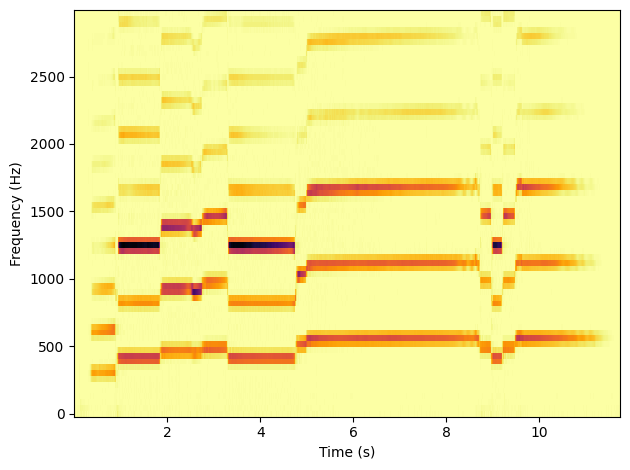

In [ ]:
gram = wave.make_spectrogram(seg_length=1024)
gram.plot(high=3000)
decorate(xlabel='Time (s)', ylabel='Frequency (Hz)')

Для примера возьмём отрезок звука от 3 до 4 секунд:

In [ ]:
start = 4.0
duration = 0.5
segment = wave.segment(start=start, duration=duration)
segment.make_audio()

Для полученого фрагмента выведем спектр:

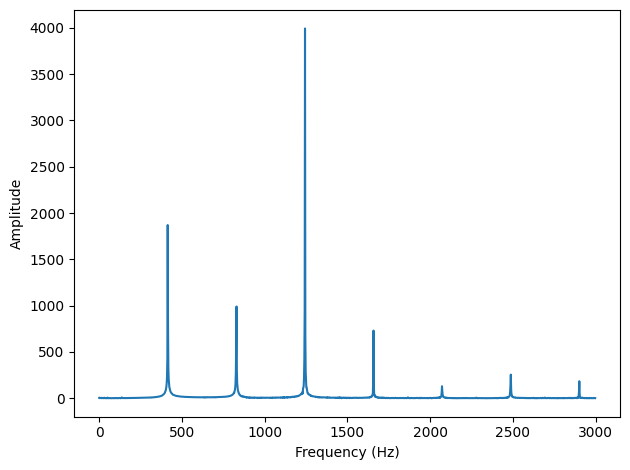

In [ ]:
spectrum = segment.make_spectrum()
spectrum.plot(high=3000)
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

Для удобства выведем значения 10 наиболее высоких частот в виде конкретных значений:

In [ ]:
data = spectrum.peaks()[:10]
df = pd.DataFrame(data, columns=['Value', 'Lag'])
print(df.to_string(index=False))

      Value    Lag
3992.340463 1244.0
1870.050347  414.0
 990.394290  830.0
 948.661214 1242.0
 784.192179  416.0
 730.561413 1658.0
 691.762943  828.0
 667.606842 1246.0
 437.468250  412.0
 419.399536 1240.0


Как мы видим, основной пик находится на 1244, однако частота, которую мы слышим
это 414, убедимся в этом, прослушав треугольный сигнал этой частоты

In [ ]:
TriangleSignal(freq=414).make_wave(duration=0.5).make_audio()

В полученном фрагменте мы слышим именно эту частоту. Чтоб понять, почему это происходит, выведем корреляцию заданного сегмента

In [ ]:
def autocorr(segment):
    corrs = np.correlate(segment.ys, segment.ys, mode='same')
    N = len(corrs)
    lengths = range(N, N//2, -1)

    half = corrs[N//2:].copy()
    half /= lengths
    half /= half[0]
    return half

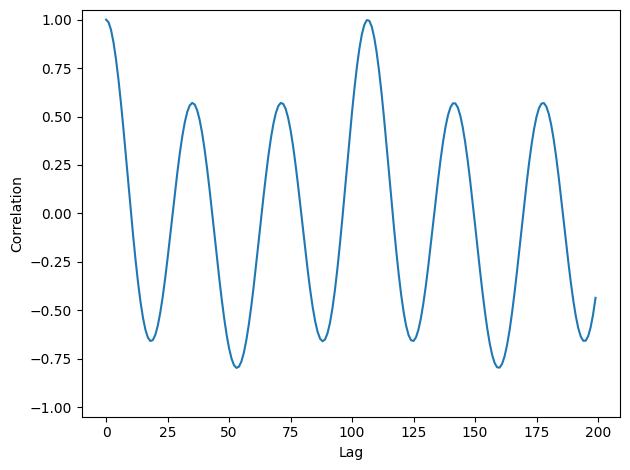

In [ ]:
corrs = autocorr(segment)
plt.plot(corrs[:200])
decorate(xlabel='Lag', ylabel='Correlation', ylim=[-1.05, 1.05])

Как мы видим, пиковая lag находится около 100, для получения точного значения частоты напишем функцию и выполним её

In [ ]:
def find_frequency(corrs, low, high):
    lag = np.array(corrs[low:high]).argmax() + low
    period = lag / segment.framerate
    frequency = 1 / period
    return frequency

find_frequency(corrs, 80, 125)

416.0377358490566

Полученная частота близка к пику в 414 Гц, отличие на 2 Гц не является существенной и может быть результатом погрешности.

Таким образом, основная частота, которую мы слышим, зависит не от амплитуды спектра, а от корреляции. Теперь попробуем избавиться от этого пика в 414, для этого применим фильтр низких частот и выведем график спектра

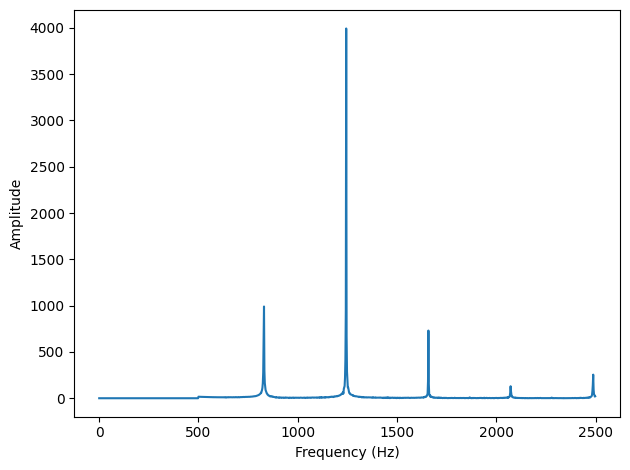

In [ ]:
spectrum = segment.make_spectrum()
spectrum.high_pass(500)
spectrum.plot(high=2500)
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

Создадим аудио фрагмент полученного сегмента:

In [ ]:
segment = spectrum.make_wave()
segment.make_audio()

Заметим, что звук стал более высоким, но общая его структура не изменилась, попробуем понять, с чем это связано, воспользовавшись функцией корреляции

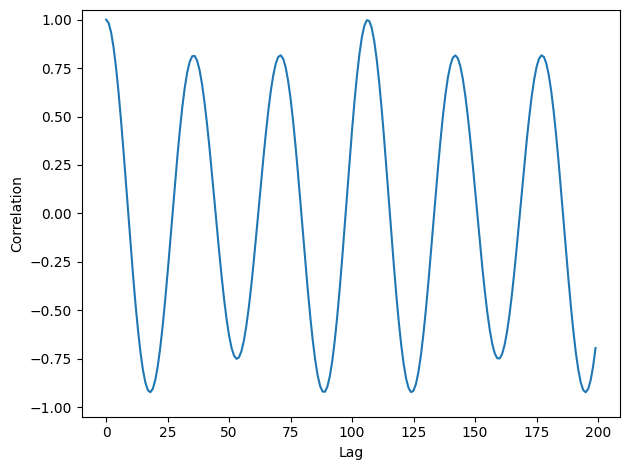

In [ ]:
corros = autocorr(segment)
plt.plot(corros[:200])
decorate(xlabel='Lag', ylabel='Correlation', ylim=[-1.05, 1.05])

Найдем точное значение пика, который находится в районе 105 Гц, используя функцию, написанную ранее, а также два предыдущих пика

In [ ]:
find_frequency(corrs, 20, 50)

1260.0

In [ ]:
find_frequency(corrs, 50, 80)

621.1267605633802

In [ ]:
find_frequency(corrs, 80, 125)

416.0377358490566

Несмотря на то, что в спектре мы удалили пик на 414, все еще самая большая частота на графике корреляции находится на 414 т. к. на высоких частотах, преимущественно присутствуют гармоники именно этой частоты, а не 1225 или 621 Гц. Убедимся, что причина именно в этом, применим как фильтр низких, так и высоких частот, выведем получившийся спектр

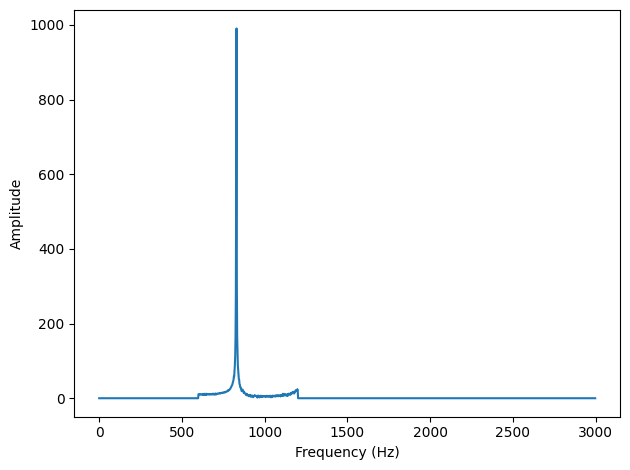

In [ ]:
spectrum = segment.make_spectrum()
spectrum.high_pass(600)
spectrum.low_pass(1200)
spectrum.plot(high=3000)
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

У данного спектра будут следующие значения наибольших его пиков:

In [ ]:
data = spectrum.peaks()[:5]
df = pd.DataFrame(data, columns=['Value', 'Lag'])
print(df.to_string(index=False))

     Value   Lag
990.394290 830.0
691.762943 828.0
299.639359 832.0
278.311502 826.0
164.057899 834.0


Как можно заметить, пик приходится на частоту 828 830 Гц. Прослушаем получившуюся запись

In [ ]:
segment = spectrum.make_wave()
segment.make_audio()

Сравним с треугольным сигналом на той же частоте

In [ ]:
TriangleSignal(freq=830).make_wave(duration=0.5).make_audio()

Звук действительно сильно изменился и стал больше походить на 830 Гц, нежели на полученные ранее 414 Гц.

Рассмотрим график корреляции полученного отрезка

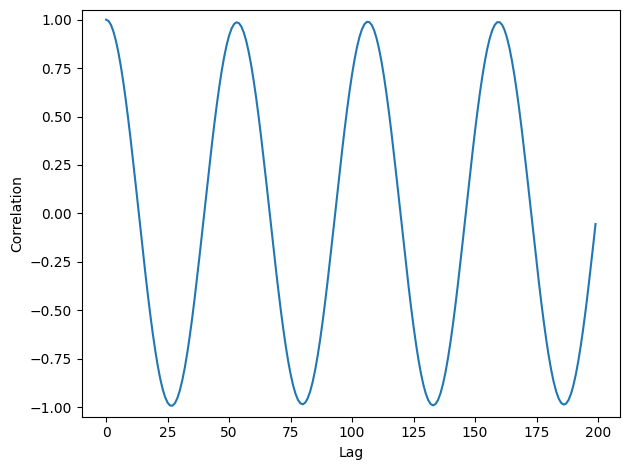

In [ ]:
corrs = autocorr(segment)
plt.plot(corrs[:200])
decorate(xlabel='Lag', ylabel='Correlation', ylim=[-1.05, 1.05])

Посмотрим на значение частоты первого пика:

In [ ]:
find_frequency(corrs, 25, 75)

832.0754716981132

Как и ожидалось, значение наибольшего пика составило примерно 832 Гц

# lab 6 - Дискретное косинусное преобразование
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py

--2024-04-22 17:39:35--  https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab5/thinkdsp.py [following]
--2024-04-22 17:39:35--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab5/thinkdsp.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48574 (47K) [text/plain]
Saving to: ‘thinkdsp.py’

thinkdsp.py         100%[===================>]  47.44K  --.-KB/s    in 0.002s  

2024-04-22 17:39:35 (26.2 MB/s) - ‘thinkdsp.py’ saved [48574/48574]



In [ ]:
import numpy as np
import scipy.fftpack
import matplotlib.pyplot as plt

from thinkdsp import decorate, UncorrelatedGaussianNoise, read_wave, Spectrogram
from scipy.stats import linregress

## lab 6.1
___

**Задача**: Утверждается, что `analyze1` требует времени пропорционально $n^3$, а `analyze2` - пропорционально $n^2$. Убедиться в этом, запуская их с несколькими разными массивами и засекая время работы. В блокнотах Jupyter можно испольщовать "волшебную команду" `%timeit`.

Если печатать зависимость времени работы от размера на логарифмической шкале, то получится прямая линия с уклоном 3 для `analyze1` и с уклоном 2 для `analyze2`.

Также стоит поупражняться с `dct_iv` и `scipy.fftpack.dct`.

### Исполдьзуемые функции

Функция `anylyze1` выглядит следующим образом:

In [ ]:
PI2 = np.pi * 2

def analyze1(ys, fs, ts):
    """Analyze a mixture of cosines and return amplitudes.

    Works for the general case where M is not orthogonal.

    ys: wave array
    fs: frequencies in Hz
    ts: times where the signal was evaluated

    returns: vector of amplitudes
    """
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.linalg.solve(M, ys)
    return amps

Функция `anylyze2` выглядит следующим образом:

In [ ]:
def analyze2(ys, fs, ts):
    """Analyze a mixture of cosines and return amplitudes.

    Assumes that fs and ts are chosen so that M is orthogonal.

    ys: wave array
    fs: frequencies in Hz
    ts: times where the signal was evaluated

    returns: vector of amplitudes
    """
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.dot(M, ys) / 2
    return amps

Проверим, что у алгоритмов именно такая сложность, как утверждается (у первой функции пропорционально $n^3$, у второй - пропорционально $n^2$), для этого создадим некоррелированный Гауссов шум. Проведём его анализ:

(16384,)

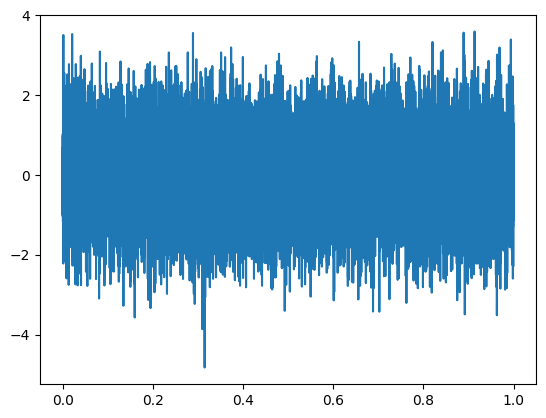

In [ ]:
signal = UncorrelatedGaussianNoise()
noise = signal.make_wave(duration=1.0, framerate=16384)
noise.plot()
noise.ys.shape

Используя магическую функцию блокнота Jupiter `%timeit` создадим функцию, для замеров времени:

In [ ]:
def run_speed_test(ns, func):
    results = []
    for N in ns:
        print(N)
        ts = (0.5 + np.arange(N)) / N
        freqs = (0.5 + np.arange(N)) / 2
        ys = noise.ys[:N]
        result = %timeit -r1 -o func(ys, freqs, ts)
        results.append(result)

    bests = [result.best for result in results]
    return bests

Также, создадим функцию для отрисовки результатов в логарифмической шкале, а также возвращающую наклон этой прямой:

In [ ]:
from scipy.stats import linregress

loglog = dict(xscale='log', yscale='log')

def plot_bests(ns, bests):
    plt.plot(ns, bests)
    decorate(**loglog)

    x = np.log(ns)
    y = np.log(bests)
    t = linregress(x,y)
    slope = t[0]

    return slope

### Создание массива

Для тестирования создадим массив, который будет подавать количества точек с измерениями:

In [ ]:
ns = 2 ** np.arange(6, 13)
ns

array([  64,  128,  256,  512, 1024, 2048, 4096])

### `analyze1`

Теперь, когда у нас есть массив значений, поместим его в ф-цию `analyze1`:

64
2.26 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
128
8.59 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
256
20.2 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
512
39.1 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
1024
78.8 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
2048
411 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
4096
2.15 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


1.528369851790671

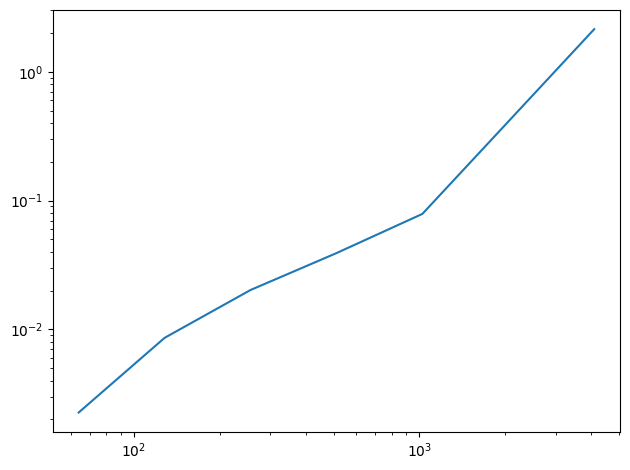

In [ ]:
bests = run_speed_test(ns, analyze1)
plot_bests(ns, bests)

Само время выполнения нас не особо интересует, а вот последнее значение – наклон графика – достаточно интересная величина. Ожидалось, что она будет ближе к 3, однако в ходе наших измерений видно, что она даже меньше двух.

Это может быть связано со множеством факторов, однако, скорее всего, все дело в `np.linalg.solve`, в котором присутствует ряд оптимизаций, которые ускоряют работу функции на каком-то размере выборки. Предположительно, при увеличении n, мы достигнем ожидаемой сложности, однако это потребует больше ресурсов т. к. даже при $4096$ точках, время ожидания составляет порядка секунды.


### `analyze2`

Теперь выполним те же действия для ф-ции `analyze2`, что проделывали выше для `analyze1`:

64
94.2 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
128
593 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
256
2.14 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
512
8.69 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
1024
35 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
2048
191 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
4096
700 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


2.1167738704312042

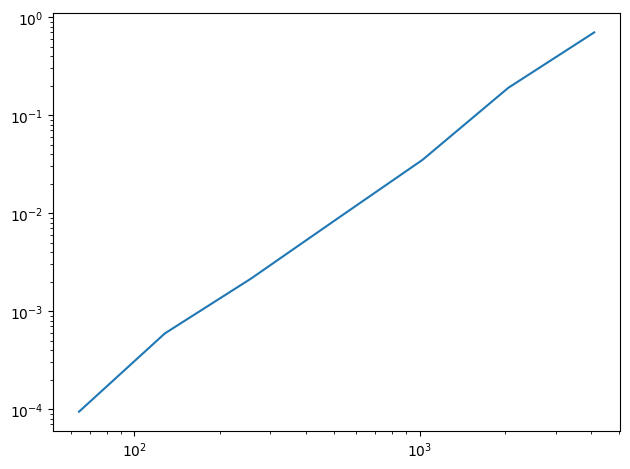

In [ ]:
bests2 = run_speed_test(ns, analyze2)
plot_bests(ns, bests2)

Как мы видим, здесь наклон действительно близок к 2, как и ожидалось. Так же стоит отметить, что время выполнения в данном случае значительно ниже, даже несмотря на то, что наклон выше. Это также стоит учитывать, однако на это мы сможем обратить внимание позже.

### `dct`

Повторим эти расчеты с функцией `dct` из `scipy.fftpack`:

In [ ]:
import scipy.fftpack

def scipy_dct(ys, freqs, ts):
    return scipy.fftpack.dct(ys, type=3)

Выполним измерения, которые выполняли для других функций:

64
6.09 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
128
7.11 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
256
7.48 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
512
13.3 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
1024
12.6 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
2048
28.4 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
4096
35.8 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)


0.4431483196008114

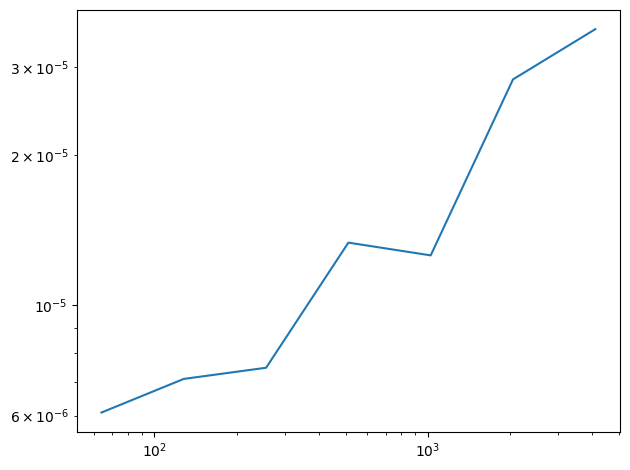

In [ ]:
bests3 = run_speed_test(ns, scipy_dct)
plot_bests(ns, bests3)

В первую очередь, отметим скорость выполнения, которая во много раз меньше, чем у предыдущих функций. Так же обратим внимание на странный угол наклона у нашей функции. Это значение свидетельствует о сложности `nlog(n)`, о чем можно узнать из документации к методу.

### Визуальное сравнение

Выведем все три графика на одном листе, чтобы было нагляднее видно разницу в скорости выполнения, а также роста:

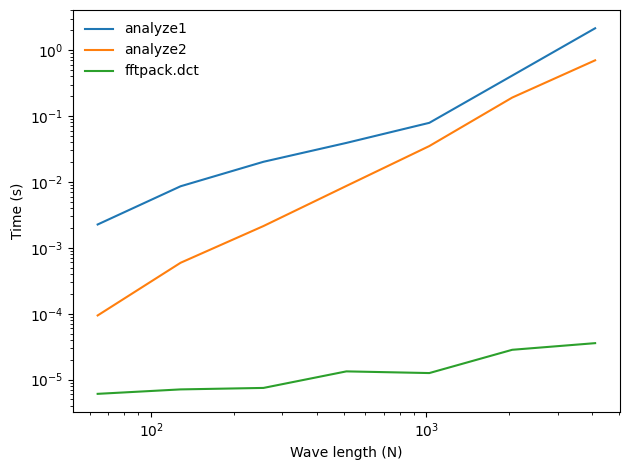

In [ ]:
plt.plot(ns, bests, label='analyze1')
plt.plot(ns, bests2, label='analyze2')
plt.plot(ns, bests3, label='fftpack.dct')
decorate(xlabel='Wave length (N)', ylabel='Time (s)', **loglog)

## lab 6.2
___

**Задача**: Одно из основных применений ДКП - это сжатие звука и изображений. В простейшей форме ДКП при сжатии работает следующим образом:
1. Разбивает длинный сигнал на сегменты.
2. Вычисляет ДКП каждого сегмента.
3. Определяет частотные компоненты с такой амплитудой, что их не слышно и удаляет их, сохраняя только оставшиеся частоты и амплитуды.
4. При воспроизведении сигнала загружает частоты и амплитуды каждого сегмента и применяет обратное ДКП.

Реализовать версию этого алгоритма и применить его для записи музыки или речи. Сколько компонет можно удалить до того, как разница станет заметной?

Для того, чтобы этот метод стал практичным, нужен способ хранения *прореженого массива*, то есть массива, где большинство элементов равно нулю. NumPy (SciPy) даёт несколько способов работы с прореженными массивами; о них можно прочитать на [веб-странице](http://docs.scipy.org/doc/scipy/reference/sparce.html).

Описанный выше алгоритм реализуем для аудиофайла с игрой на саксафоне, который испольщовался в предыдущей лабораторной работе (`saxophone_weep.wav`):

In [ ]:
if not os.path.exists('saxophone_weep.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/saxophone_weep.wav

--2024-04-22 19:13:00--  https://github.com/MatNepo/Telecom2024/raw/main/lab5/saxophone_weep.wav
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab5/saxophone_weep.wav [following]
--2024-04-22 19:13:01--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab5/saxophone_weep.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2071600 (2.0M) [audio/wav]
Saving to: ‘saxophone_weep.wav’

saxophone_weep.wav  100%[===================>]   1.98M  --.-KB/s    in 0.01s   

2024-04-22 19:13:01 (172 MB/s) - ‘saxophone_weep.wav’ saved [2071600/2071600]



На основе полученной аудиозаписи создадим аудиофайл:

In [ ]:
wave = read_wave('saxophone_weep.wav')
wave.make_audio()

Для начала выполним этот алгоритм для одного сегмента, а потом напишем функцию, которая будет масштабировать наш подход.

### Создание сегмента

Получим сегмент:

In [ ]:
segment = wave.segment(start=1.2, duration=0.5)
segment.normalize()
segment.make_audio()

### Подсчёт ДКП

Для полученного сегмента посчитаем ДКП:

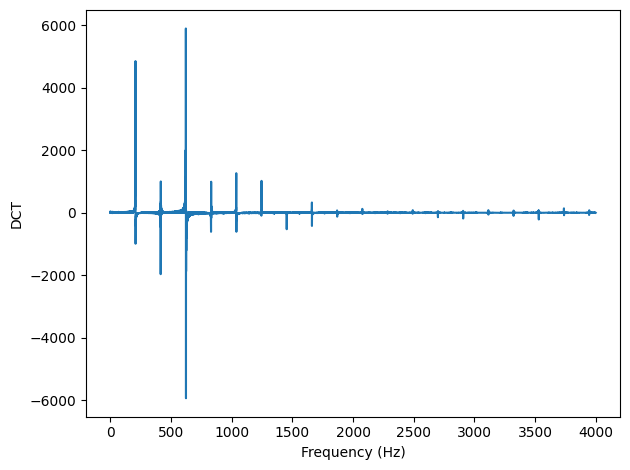

In [ ]:
seg_dct = segment.make_dct()
seg_dct.plot(high=4000)
decorate(xlabel='Frequency (Hz)', ylabel='DCT')

### Определение частотных компонент

Напишем функцию для третьего пункта, которая будет удалять все частотные компоненты с маленькой амплитудой. Также дополнительно она будет выводить сколько значений было удалено и количество процентов от общего числа:

In [ ]:
def compress(dct, thresh=1):
    count = 0
    for i, amp in enumerate(dct.amps):
        if np.abs(amp) < thresh:
            dct.hs[i] = 0
            count += 1

    n = len(dct.amps)
    print(count, n, 100 * count / n, sep='\t')

Выполним эту функцию для полученного сегмента:

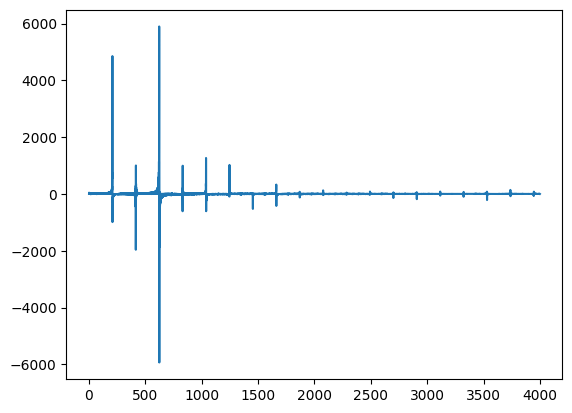

In [ ]:
seg_dct = segment.make_dct()
seg_dct.plot(high=4000)

In [ ]:
seg2 = seg_dct.make_wave()
seg2.make_audio()

По графику кажется, что ничего не изменилось (по аудио создается такое же впечатление), однако посмотрим на результат, который вывела наша функция:

In [ ]:
compress(seg_dct, thresh=10)

20457	22050	92.77551020408163


В результате выполнения было удалено 92.8% сегментов. Именно поэтому данный метод является таким эффективным т. к. практически не заметен для слуха, однако хорошо сохраняет информацию.

### Применение обратного ДКП

Теперь необходимо реализовать алгоритм, который будет работать с сегментами большей длины. Первым шагом необходимо выполнить разбиение на сегменты с ДКП. Функция будет аналогична `wave.make_spectrogram`, за исключением того, что она использует ДКП:

In [ ]:
from thinkdsp import Spectrogram

def make_dct_spectrogram(wave, seg_length):
    """Computes the DCT spectrogram of the wave.

    seg_length: number of samples in each segment

    returns: Spectrogram
    """
    window = np.hamming(seg_length)
    i, j = 0, seg_length
    step = seg_length // 2

    # map from time to Spectrum
    spec_map = {}

    while j < len(wave.ys):
        segment = wave.slice(i, j)
        segment.window(window)

        # the nominal time for this segment is the midpoint
        t = (segment.start + segment.end) / 2
        spec_map[t] = segment.make_dct()

        i += step
        j += step

    return Spectrogram(spec_map, seg_length)

Здесь необходимо отметить необходимость использовать окно Хемминга, которое рассматривалось в предыдущих лабораторных.

После того, как мы разбиваем аудио на сегменты, необходимо применить функцию «сжатия» на каждый из этих сегментов.

In [ ]:
spectro = make_dct_spectrogram(wave, seg_length=1024)
for t, dct in sorted(spectro.spec_map.items()):
    compress(dct, thresh=0.2)

1018	1024	99.4140625
1016	1024	99.21875
1014	1024	99.0234375
1017	1024	99.31640625
1016	1024	99.21875
1017	1024	99.31640625
1016	1024	99.21875
1020	1024	99.609375
1014	1024	99.0234375
1005	1024	98.14453125
1009	1024	98.53515625
1015	1024	99.12109375
1015	1024	99.12109375
1016	1024	99.21875
1016	1024	99.21875
1015	1024	99.12109375
1017	1024	99.31640625
1020	1024	99.609375
1013	1024	98.92578125
1017	1024	99.31640625
1013	1024	98.92578125
1017	1024	99.31640625
1018	1024	99.4140625
1015	1024	99.12109375
1013	1024	98.92578125
794	1024	77.5390625
785	1024	76.66015625
955	1024	93.26171875
995	1024	97.16796875
992	1024	96.875
976	1024	95.3125
925	1024	90.33203125
802	1024	78.3203125
836	1024	81.640625
850	1024	83.0078125
882	1024	86.1328125
883	1024	86.23046875
891	1024	87.01171875
901	1024	87.98828125
902	1024	88.0859375
900	1024	87.890625
900	1024	87.890625
894	1024	87.3046875
904	1024	88.28125
901	1024	87.98828125
915	1024	89.35546875
913	1024	89.16015625
899	1024	87.79296875
905	1024	88.37

Теперь создадим аудиофайл и прослушаем получившуюся волну:

In [ ]:
wave2 = spectro.make_wave()
wave2.make_audio()

Аудиофайл не поменял звучания, однако было удалено практически 95% значений (судя по логам в ходе вызовов функции), что сильно упрощает хранение этой информации.

*В этой функции главное правильно найти баланс между звучанием и удалением информации, например при `thresh = 10` разница уже становится сильно заметной, однако к этому моменту удаляется более 98% информации.

## lab 6.3
___

**Задача**: В репозитории [этой книги](https://github.com/MatNepo/ThinkDSP) есть блокнот Jupyter под названием `phase.ipynb`, в котором исследуется влияние фазы на восприятие звука. Необходимо прочтитать этот блокнот и "прогнать" примеры. Выбрать иной сегмент звука и повторить эксперименты. Можно ли найти некие общие соотношения во фразовой структуре звука и его восприятии?

### Анализ пилообразного сигнала

In [ ]:
from thinkdsp import SawtoothSignal

Ответим на вопрос, слышим ли мы изменения в фазе сигнала.
Начнем исследования с обычного пилообразного сигнала:

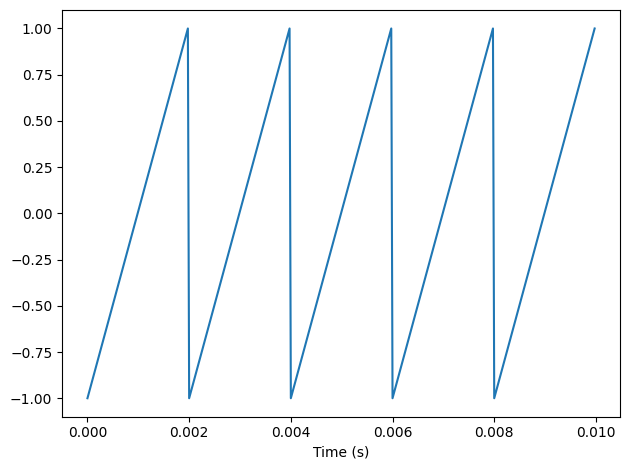

In [ ]:
signal = SawtoothSignal(freq=500, offset=0)
wave = signal.make_wave(duration=0.5, framerate=40000)
wave.segment(duration=0.01).plot()
decorate(xlabel='Time (s)')
wave.make_audio()

Выведем спектр созданного сигнала:

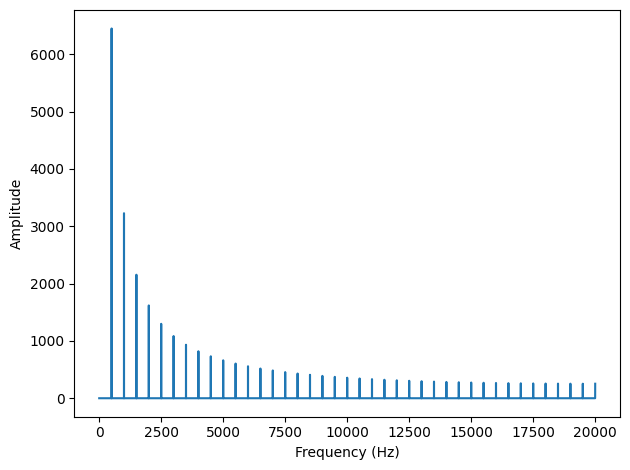

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot()
decorate(xlabel='Frequency (Hz)',
         ylabel='Amplitude')

Подобного вида графики мы рассматривали в предыдущих главах. Выведем новый график, график углов спектра:

In [ ]:
def plot_angle(spectrum, thresh=1):
    angles = spectrum.angles
    angles[spectrum.amps < thresh] = np.nan
    plt.plot(spectrum.fs, angles, 'x')
    decorate(xlabel='Frequency (Hz)',
             ylabel='Phase (radian)')

Эта функция выводит все углы, выше определенного порога. Если вывести график, убрав порог (указать нулевое значение порога), получим следующий результат:

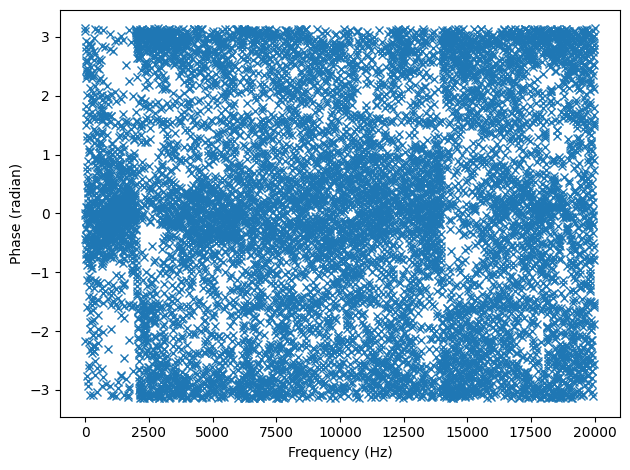

In [ ]:
plot_angle(spectrum, thresh=0)

Этот график выглядит хаотичным, однако если увеличить порог, например до 1, мы получим совсем другой результат:

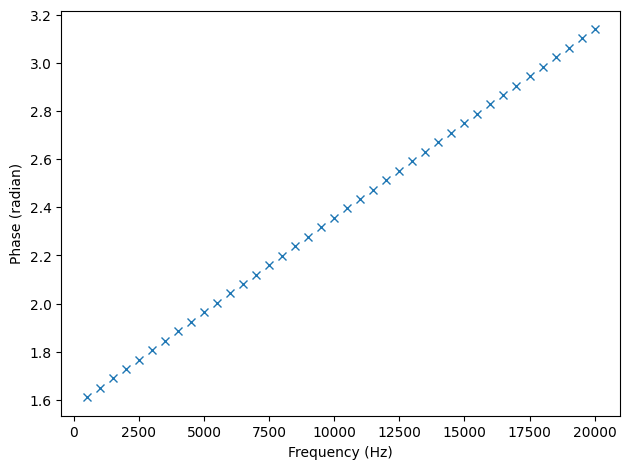

In [ ]:
plot_angle(spectrum, thresh=1)

Как мы видим, каждая гармоника смещена, относительно предыдущей на долю радиана.
Напишем функцию, которая будет выводить все три 3 графика, а также аудио переданного спектра:

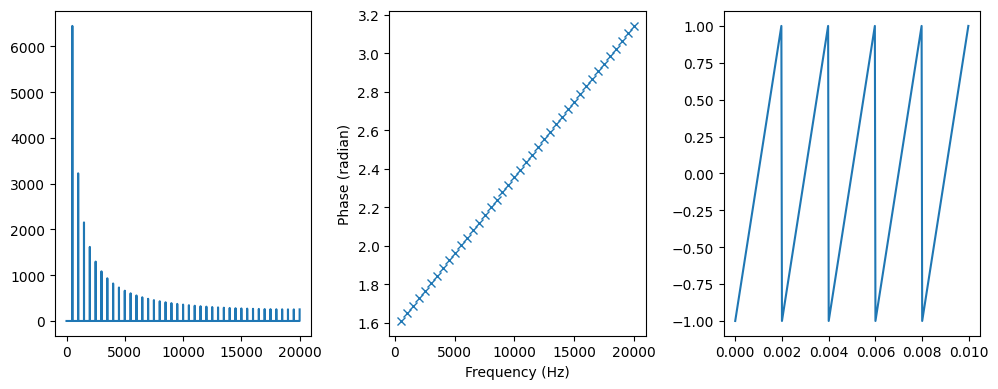

In [ ]:
def plot_three(spectrum, thresh=1):
    plt.figure(figsize=(10, 4))
    plt.subplot(1,3,1)
    spectrum.plot()
    plt.subplot(1,3,2)
    plot_angle(spectrum, thresh=thresh)
    plt.subplot(1,3,3)
    wave = spectrum.make_wave()
    wave.unbias()
    wave.normalize()
    wave.segment(duration=0.01).plot()
    display(wave.make_audio())

plot_three(spectrum)

Теперь попробуем поменять эти углы и посмотрим, как это влияет на звучание.
Первым делом занулим эти углы:

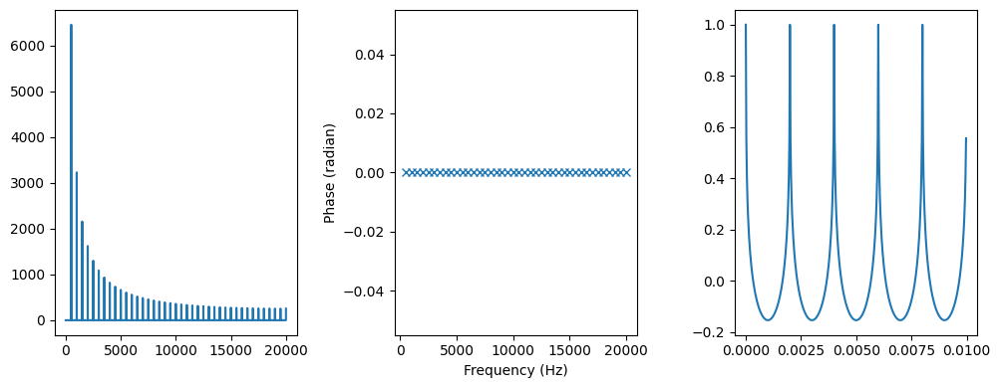

In [ ]:
def zero_angle(spectrum):
    res = spectrum.copy()
    res.hs = res.amps
    return res

spectrum2 = zero_angle(spectrum)
plot_three(spectrum2)

Слышно, что звук не изменился, а только стал тише, однако это результат нормализации. Т. е. при изменении угла на 0, мы получили абсолютно тот же звук.
Теперь умножим наши углы на $exp⁡(iφ)$, это добавит $φ$ к углу:

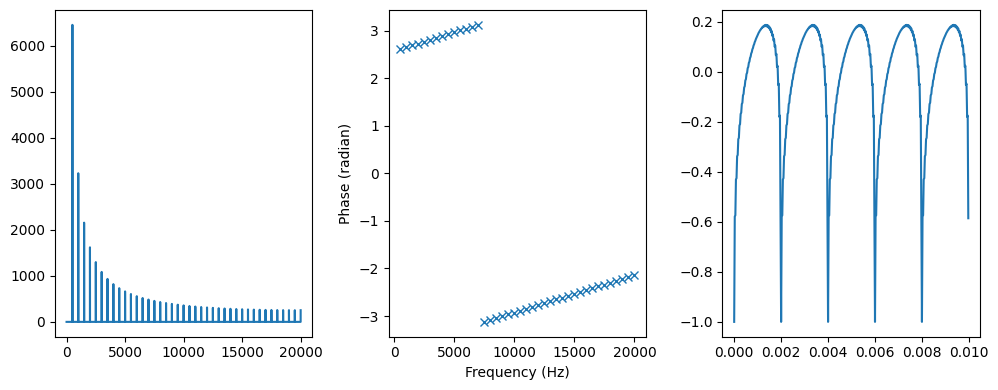

In [ ]:
def rotate_angle(spectrum, offset):
    res = spectrum.copy()
    res.hs *= np.exp(1j * offset)
    return res

spectrum3 = rotate_angle(spectrum, 1)
plot_three(spectrum3)


И опять не произошло никакого изменения в плане звучания. Попробуем на этот раз выполнить случайное смещение:

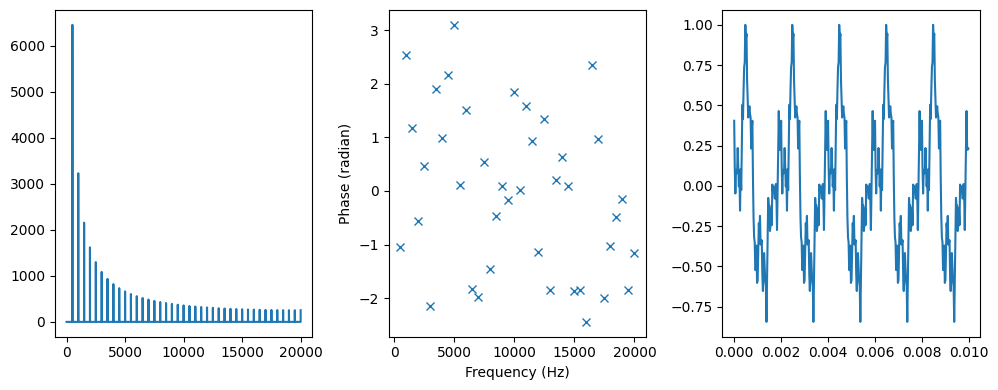

In [ ]:
def random_angle(spectrum):
    res = spectrum.copy()
    angles = np.random.uniform(0, PI2, len(spectrum))
    res.hs *= np.exp(1j * angles)
    return res
spectrum4 = random_angle(spectrum)
plot_three(spectrum4)

### Анализ звука флейты

Опять получается тот же звук, только громче. Возможно, проблема в том, что звук слишком простой. Возьмем звук многоствольной флейты и повторим эксперимент:

In [ ]:
if not os.path.exists('pan-pipe-flute-middle-eastern.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab6/pan-pipe-flute-middle-eastern.wav

--2024-04-22 20:16:21--  https://github.com/MatNepo/Telecom2024/raw/main/lab6/pan-pipe-flute-middle-eastern.wav
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab6/pan-pipe-flute-middle-eastern.wav [following]
--2024-04-22 20:16:21--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab6/pan-pipe-flute-middle-eastern.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1801610 (1.7M) [audio/wav]
Saving to: ‘pan-pipe-flute-middle-eastern.wav’

pan-pipe-flute-midd 100%[===================>]   1.72M  --.-KB/s    in 0.02s   

2024-04-22 20:16:21 (99.0 MB/s) - ‘pan-

In [ ]:
wave = read_wave('pan-pipe-flute-middle-eastern.wav')
wave.make_audio()

Возьмем сегмент длительности 0.9 и распечатаем для него все графики:

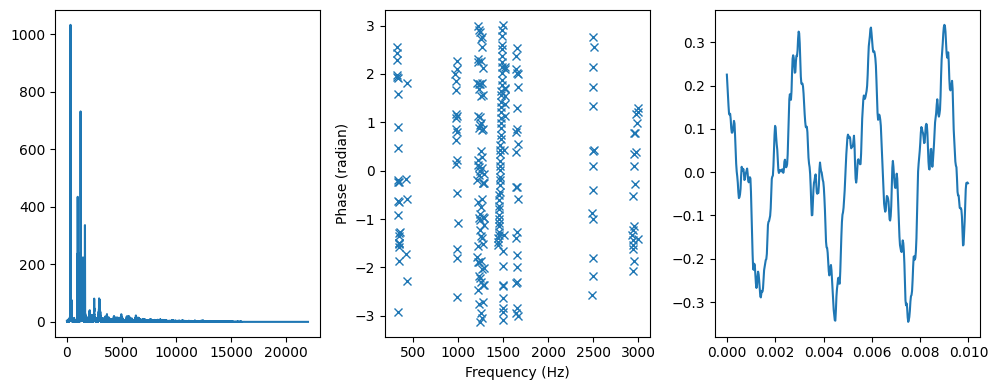

In [ ]:
segment = wave.segment(start=0.1, duration=0.9)
spectrum = segment.make_spectrum()
plot_three(spectrum, thresh=50)

Вызовем функцию `zero_angle`:

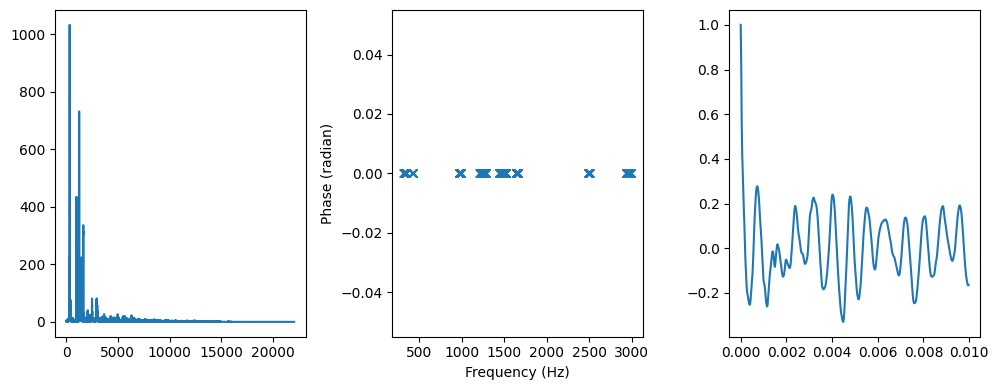

In [ ]:
spectrum2 = zero_angle(spectrum)
plot_three(spectrum2, thresh=50)

Звук сильно изменился в начале звук практически не слышно, однако ближе к концу он восстанавливает исходный уровень громкости. Так же стоит отметить, что исходная мелодия вообще не узнается в получившемся отрезке.

Посмотрим, какой результат будет со смещением фазы:

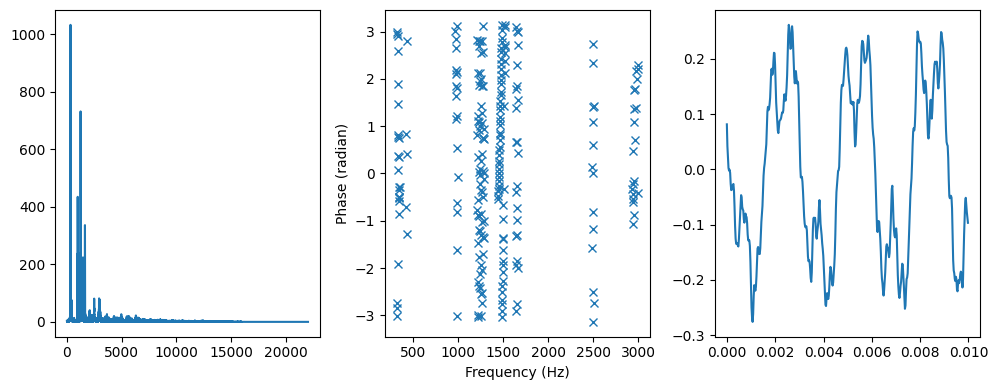

In [ ]:
spectrum3 = rotate_angle(spectrum, 1)
plot_three(spectrum3, thresh=50)

После применения этой функции звук совсем не изменился. Также теперь попробуем применить функцию `random_angle`:

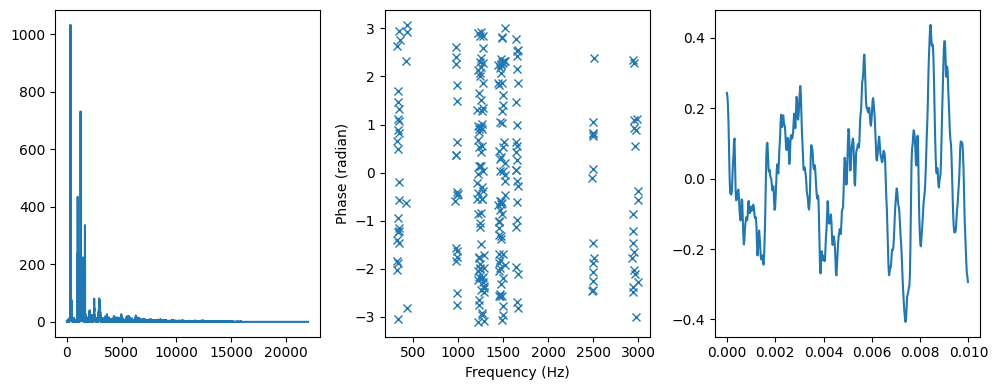

In [ ]:
spectrum4 = random_angle(spectrum)
plot_three(spectrum4, thresh=50)

После применения этой функции звук потерял всю «форму», став более монотонным, однако исходная мелодия флейты угадывается.

В отличии от пилообразного сигнала, мы видим, что функция зануления угла и случайного угла произвели какой-то эффект.

### Анализ звука саксофона

Теперь попробуем повторить опыты над звуком саксофона:

In [ ]:
wave = read_wave('saxophone_weep.wav')
wave.make_audio()

Дальнейший код будет опускаться т. к. он полностью дублирует предыдущий. Выведем на экран графики для этого сегмента:

In [ ]:
segment = wave.segment(start=3.5, duration=0.6)

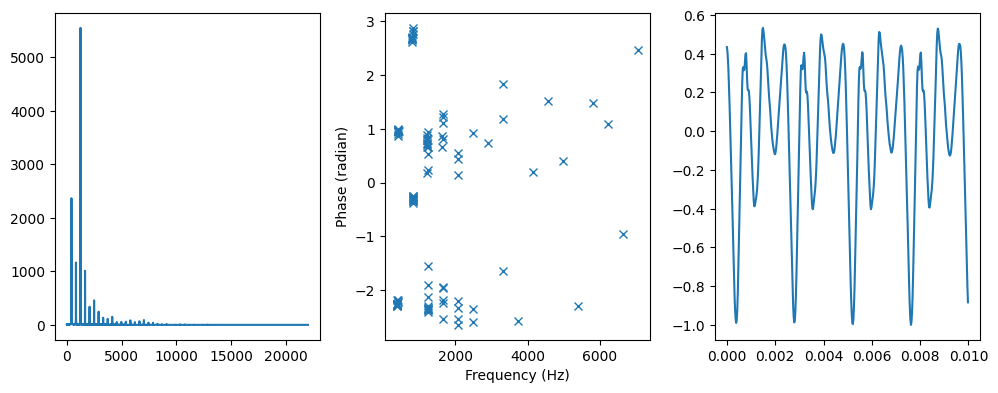

In [ ]:
spectrum = segment.make_spectrum()
plot_three(spectrum, thresh=50)

Вызовем функцию zero_angle и посмотрим на результат:

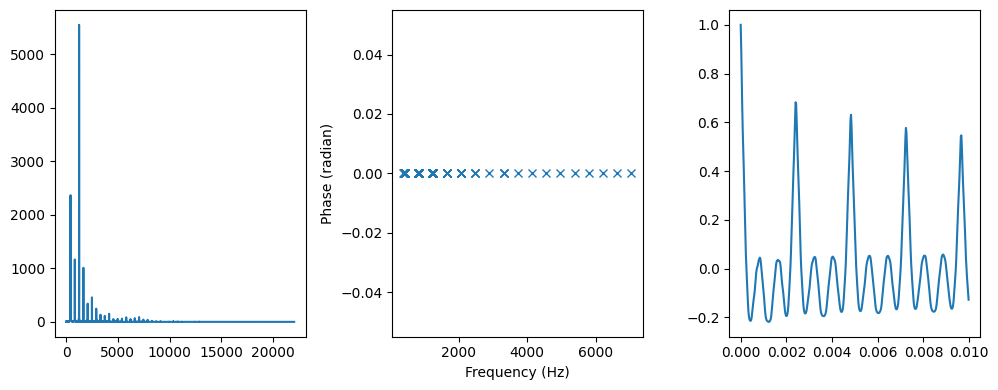

In [ ]:
spectrum2 = zero_angle(spectrum)
plot_three(spectrum2, thresh=50)

Звук стал тише, но что более важно изменил свою «форму». Сам сегмент на протяжении всего времени монотонный, однако после обработки он сначала более тихий, а ближе к концу становится громче, чего в изначальном сегменте не было.

Теперь попробуем функцию rotate_angle:

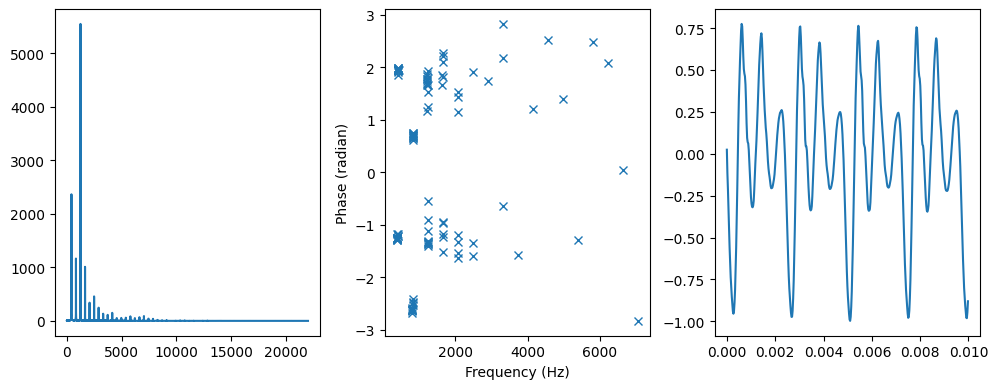

In [ ]:
spectrum3 = rotate_angle(spectrum, 1)
plot_three(spectrum3, thresh=50)

И опять после использования этой функции звук совсем не изменился.

Посмотрим, как изменится звук после функции random_angle:

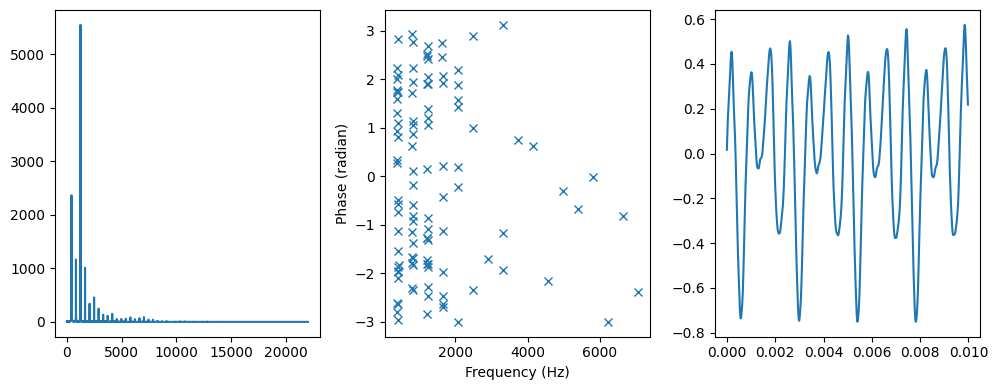

In [ ]:
spectrum4 = random_angle(spectrum)
plot_three(spectrum4, thresh=50)

И опять изменений в звуке нет. Как мы узнали в предыдущих упражнениях в звуке саксофона слышимая частота (фундаментальный компонент) не является доминирующим. Добавим фильтр низких частот, чтоб создать явление подавленной основной. Возможно, этот звук более чувствителен к фазовой структуре:

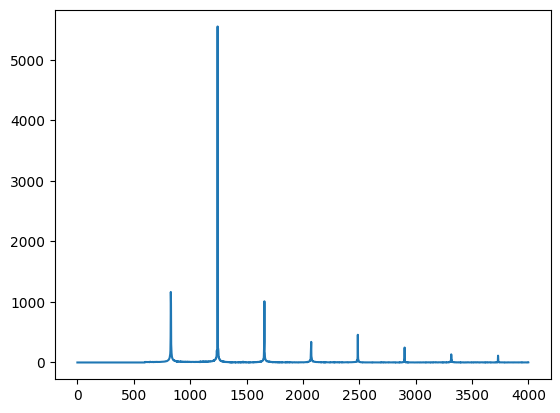

In [ ]:
spectrum.high_pass(600)
spectrum.plot(high=4000)

Как мы видим, все частоты ниже 600 исчезли. Выведем для этого звука все три графика:

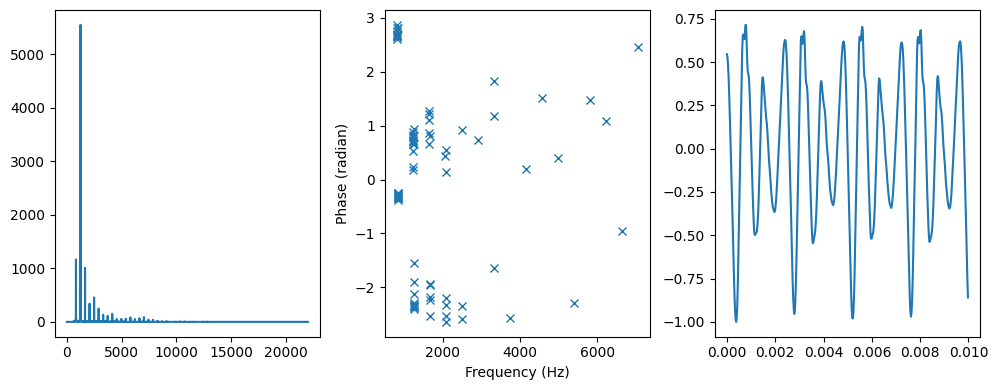

In [ ]:
plot_three(spectrum, thresh=50)

Как видно, графики не сильно изменились, то же самое можно сказать и относительно звука. Как и ожидалось, изменения не сильно заметны.

Теперь применим функцию `zero_angle`:

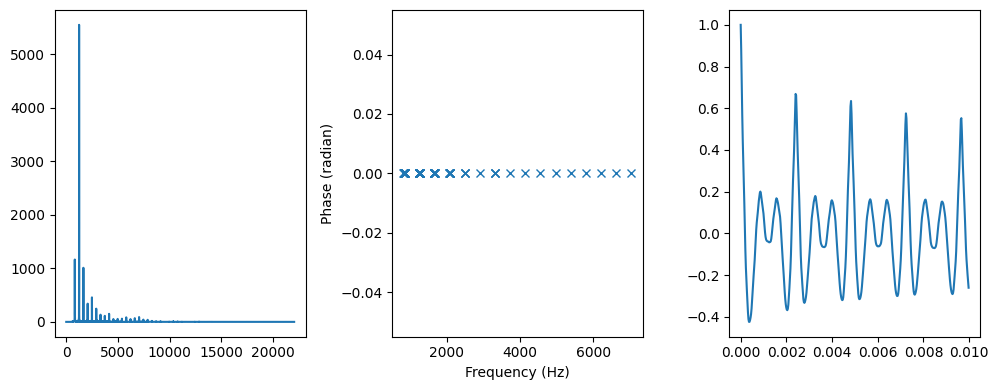

In [ ]:
spectrum2 = zero_angle(spectrum)
plot_three(spectrum2, thresh=50)

Неожиданно, однако звук претерпел меньше изменений, нежели до фильтра низких частот, однако все равно чувствуется изменение «формы» сигнала.
Далее перейдем к функции `rotate_angle`, которая в прошлый раз практически не изменила сигнал (по звучанию):

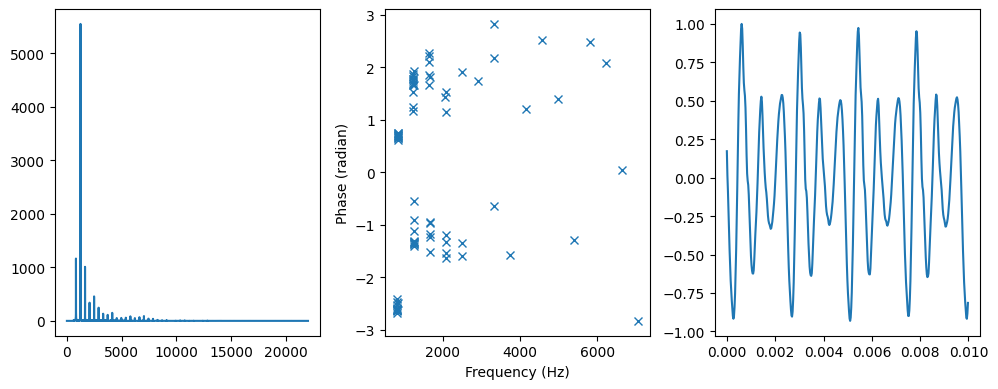

In [ ]:
spectrum3 = rotate_angle(spectrum, 1)
plot_three(spectrum3, thresh=50)

Как и ранее, звук не изменился.

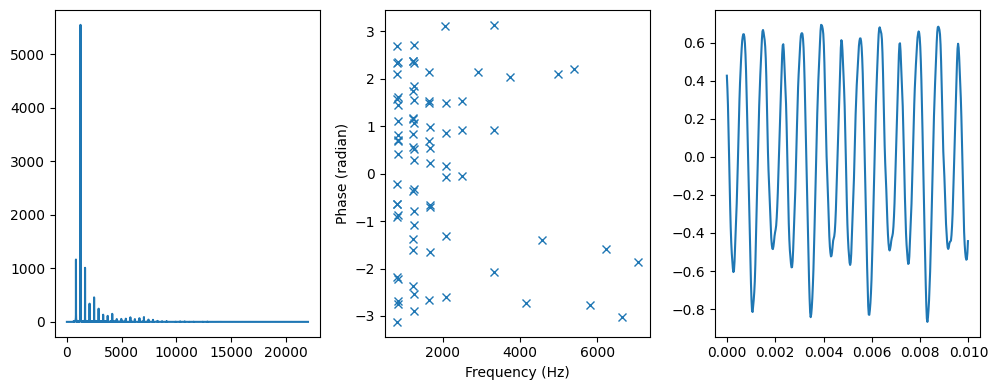

In [ ]:
spectrum4 = random_angle(spectrum)
plot_three(spectrum4, thresh=50)

Звук опять практически не изменился.

### Вывод

Можно сделать вывод, что в основном мы не слышим изменения в фазовой структуре. Однако сильные изменения все же заметны, особенно если фазовая структура изменяется очень сильно.

# lab 7 - Дискретное преобразование Фурье
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py

--2024-05-18 14:22:21--  https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab5/thinkdsp.py [following]
--2024-05-18 14:22:21--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab5/thinkdsp.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48574 (47K) [text/plain]
Saving to: ‘thinkdsp.py’

thinkdsp.py         100%[===================>]  47.44K  --.-KB/s    in 0.01s   

2024-05-18 14:22:22 (3.43 MB/s) - ‘thinkdsp.py’ saved [48574/48574]



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from scipy.stats import linregress

PI2 = 2 * np.pi

## lab 7.2
___

**Задача**: В этой главе показано, как выразить ДПФ и обратное ДПФ произведениями матриц. Время выполнения этих операций пропорционально $N^2$, где $N$ - длиан массива сигнала. Во многих случаях этого достаточно, но есть алгоритмы и побыстрее - быстрое преобразование Фурье (БПФ); время его работы пропорционально $N*log(N)$.

Ключ к БПФ - это лемма Дэниелсона-Ланцоша (Danielson-Lanczos):

$DFT(y)[n]=DFT(e)[n]+exp(-2πin/N) DFT(o)[n]$,

где $DFT(y)[n]$ - это n-й элемент ДПФ от $y$, $e$ и $o$ - масисивы сигнала,содержащие соответсвенно чётные и нечётные элементы $y$.

Эта лемма предлагает рекурсивный алгоритм для ДПФ:
1. Дан массив сигнала у. Разделим его на четные элементы е и нечетные элементы О.
2. Вычислим DFT е и о, делая рекурсивные вызовы.
3. Вычислим DFT(y) для каждого значения и, используя лемму Дэниелсона-Ланцоша.

В простейшем случае эту рекурсию надо продолжать, пока длина у не дойдет до 1. Тогда $DFT(y)=y$. А если длина $y$ достаточно мала, можно вычислить его ДПФ перемножением матриц, используя зара- нее вычисленные матрицы.

Подсказка: реализовывать этот алгоритм стоит постепенно, начав с нерекурсивной версии. На шаге 2, вместо того чтобы делать рекур- сивный вызов, используйте $dft$, как показано в разделе «ДПФ» на стр. 93, или $пр.fft.fft$. Отладьте шаг 3 и проверьте, согласуются ли результаты с другими реализациями. Затем добавьте базовый случай и убедитесь, что он работает. И наконец, замените шаг 2 на рекурсивные вызовы. Примечание: помните, что ДПФ периодично; попробуйте применить $nр.tile$. О БПФ можно прочитать подробнее в Википедии: https://ru.wikipedia.org/wiki/Быстрое_преобразование_Фурье.

Создадим простой сигнал и вычислим его ДПФ, используя функцию $numpy$:

In [ ]:
ys = [-0.5, 0.1, 0.7, -0.1]
hs = np.fft.fft(ys)
hs

array([ 0.2+0.j , -1.2-0.2j,  0.2+0.j , -1.2+0.2j])

Будем использовать эти значения как эталон, для проверки корректности построения функции. Для начала проверим утверждение леммы на корректность, для этого создадим функцию, которая вместо рекурсивного вызова делит массив на две части, вычисляет их ДПФ (пока что без рекурсии, а используя функцию $numpy$) и подставляет значения в лемму:


In [ ]:
def fft_norec(ys):
    N = len(ys)
    He = np.fft.fft(ys[::2])
    Ho = np.fft.fft(ys[1::2])

    ns = np.arange(N)
    W = np.exp(-1j * PI2 * ns / N)

    return np.tile(He, 2) + W * np.tile(Ho, 2)

Запустим этот код и посмотрим на разницу между этим методом и методом из $numpy$:

In [ ]:
hs1 = fft_norec(ys)
np.sum(np.abs(hs - hs1))

0.0

Полученное значение равно нулю, что свидетельствует о том, что такой метод вычислений является валидным. Тогда вместо того, чтоб использовать встроенную функцию, вызовем нашу функцию рекурсивно, как говорит об этом второй пункт алгоритма:

In [ ]:
def my_fft(ys):
    N = len(ys)
    if N == 1:
        return ys

    He = my_fft(ys[::2])
    Ho = my_fft(ys[1::2])

    ns = np.arange(N)
    W = np.exp(-1j * PI2 * ns / N)

    return np.tile(He, 2) + W * np.tile(Ho, 2)

Как видно по коду, пришлось добавить проверку на длину массива (добавить базовый случай), иначе алгоритм бы ушел в бесконечный цикл. Вызовем теперь эту функцию и посмотрим на результат погрешности:

In [ ]:
hs2 = my_fft(ys)
np.sum(np.abs(hs - hs2))

1.6653345369377348e-16

Число является очень маленьким, что свидетельствует о том, что метод выполняет расчеты корректно до погрешности вычислений.

Однако утверждать, что эта функция работает быстрее пока что рано, выполним замеры скорости работы программ. Также дополнительно проверим функцию из методических материалов на предмет сложности $𝑁^2$:


In [ ]:
def dft(ys):
    N = len(ys)
    ts = np.arange(N) / N
    freqs = np.arange(N)
    args = np.outer(ts, freqs)
    M = np.exp(1j * PI2 * args)
    amps = M.conj().transpose().dot(ys)
    return amps

Создадим функцию для запуска замера скорости (с использованием `%timeit`):

In [ ]:
def run_speed_test(func, lengths, ys):
    bests = []
    print(func.__name__)
    for l in lengths:
        print(l)
        result = %timeit -r1 -o func(ys[:l])
        bests.append(result.best)

    return bests

Так же создадим функцию, которая будет генерировать массив ys заданной длинны в пределах от -1 до 1:

In [ ]:
def generate_ys(max_length=2**5):
    return np.random.uniform(-1, 1, max_length)

Создадим массив $lengths$, для создания выборок разной длинны (по степеням двойки) и сгенерируем $ys$ необходимой длинны:

In [ ]:
max_length = 15
lengths = [2 ** i for i in range(5, max_length)]
ys = generate_ys(lengths[-1])

Запустим `speed_test` для встроенного метода в $numpy$:

In [ ]:
fft_res = run_speed_test(np.fft.fft, lengths, ys)

fft
32
6.97 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
64
7.02 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
128
11 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
256
5.54 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
512
9.14 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 100000 loops each)
1024
27.8 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
2048
52.2 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
4096
65.4 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
8192
130 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
16384
271 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)


Далее выполним этот же вызов, но для функции $dft$, которая по утверждению автора книги работает за $𝑁^2$:

In [ ]:
dft_res = run_speed_test(dft, lengths, ys)

dft
32
69.1 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
64
381 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
128
2.78 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
256
18.8 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
512
77.3 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
1024
201 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
2048
394 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
4096
1.05 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
8192
5.1 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
16384
20.1 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


Также вызовем измерение времени для разработанной функции БПФ:

In [ ]:
my_fft_res = run_speed_test(my_fft, lengths, ys)

my_fft
32
588 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
64
1.2 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
128
3.31 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
256
8.65 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
512
9.74 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
1024
37.2 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
2048
137 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
4096
201 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
8192
464 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
16384
309 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


Выведем эти результаты в виде графиков в логарифмической шкале, а также посчитаем их наклон:

fft 0.6132099451577271
dft 1.919336448175951
my_fft 1.1214068613495127


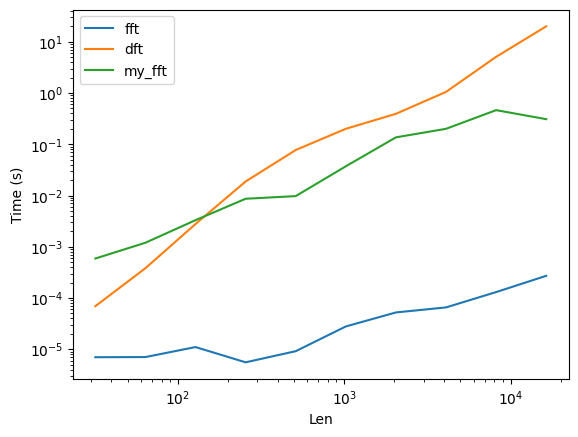

In [ ]:
def plot_speed_test(lengths, ys, label):
    plt.plot(lengths, ys, label=label)
    x = np.log(lengths)
    y = np.log(ys)
    t = linregress(x,y)
    print(label, t[0])

plot_speed_test(lengths, fft_res, 'fft')
plot_speed_test(lengths, dft_res, 'dft')
plot_speed_test(lengths, my_fft_res, 'my_fft')

plt.legend()
plt.xlabel('Len')
plt.ylabel('Time (s)')
plt.xscale('log')
plt.yscale('log')

Как видно из этих графиков быстрее всего работает встроенная функция, а также возрастает достаточно медленно. Быстрее всех возрастает $dft$ из методических материалов, однако в начале она работала и быстрее. Наша функция же возрастает достаточно медленно, как и ожидалось.

Как и ожидалось, наклон `dft` почти равен 2, что свидетельствует о том, что изначальная информация о сложности была корректной. `fft` и `my_fft` не являются абсолютно прямыми, их наклон близок к 1, что может говорить о логарифмической природе их скорости роста.


# lab 8 - Фильтрация и свёртка
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py

In [ ]:
import scipy.signal
import matplotlib.pyplot as plt
import numpy as np
from thinkdsp import SquareSignal, decorate, zero_pad, Wave
from ipywidgets import interact
import ipywidgets as widgets
import scipy

M = 15
std = 2.5

## lab 8.1
___

**Задание**:  В блдокноте этой главы есть интерактивный виджет, где можно экспериментировать с параметрами гауссова окна и изучить их влияние на частоту среза. Что случится, если при увеличении ширины гауссова окна `std` не увеличивать число элементов в окне $M$?

В приложении к методическим материалам была получена следущая функция:

In [ ]:
def plot_filter(M=11, std=2):
    signal = SquareSignal(freq=440)
    wave = signal.make_wave(duration=1, framerate=44100)
    spectrum = wave.make_spectrum()

    gaussian = scipy.signal.windows.gaussian(M=M, std=std)
    gaussian /= sum(gaussian)

    ys = np.convolve(wave.ys, gaussian, mode='same')
    smooth =  Wave(ys, framerate=wave.framerate)
    spectrum2 = smooth.make_spectrum()

    # plot the ratio of the original and smoothed spectrum
    amps = spectrum.amps
    amps2 = spectrum2.amps
    ratio = amps2 / amps
    ratio[amps<560] = 0

    # plot the same ratio along with the FFT of the window
    padded =  zero_pad(gaussian, len(wave))
    dft_gaussian = np.fft.rfft(padded)

    plt.plot(np.abs(dft_gaussian), color='gray', label='Gaussian filter')
    plt.plot(ratio, label='amplitude ratio')

    decorate(xlabel='Frequency (Hz)', ylabel='Amplitude ratio')
    plt.show()

Она принимает на вход параметры $M$ (число элементов в окне) и $std$ (стандартное отклонение гауссова распределения). После чего создает прямоугольный сигнал и применяет к нему гауссово окно (аналогично проделанной работе в методических материалах) для заданных $M$ и $std$. После этого отображает окно после преобразования Фурье и результат применения окна. Запустим эту функцию, используя слайдер для удобства изменения данных:

In [ ]:
slider = widgets.IntSlider(min=2, max=100, value=11)
slider2 = widgets.FloatSlider(min=0, max=20, value=2)
interact(plot_filter, M=slider, std=slider2)

interactive(children=(IntSlider(value=11, description='M', min=2), FloatSlider(value=2.0, description='std', m…

<function __main__.plot_filter(M=11, std=2)>

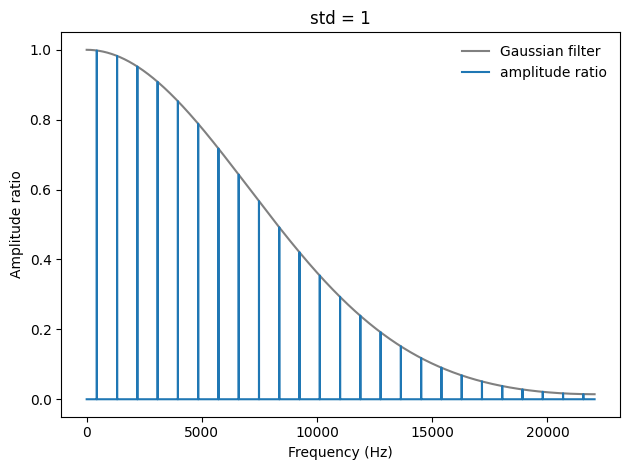

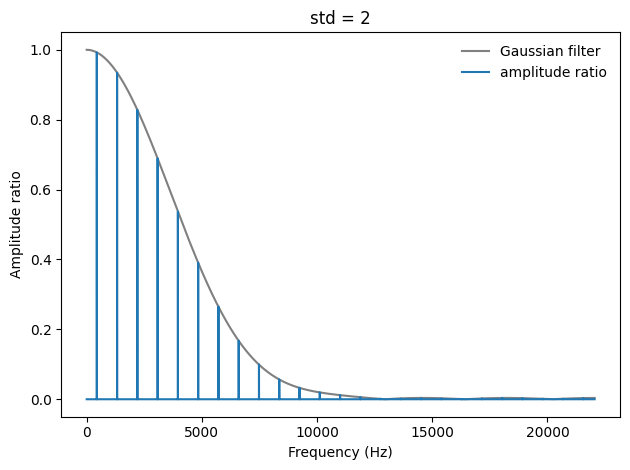

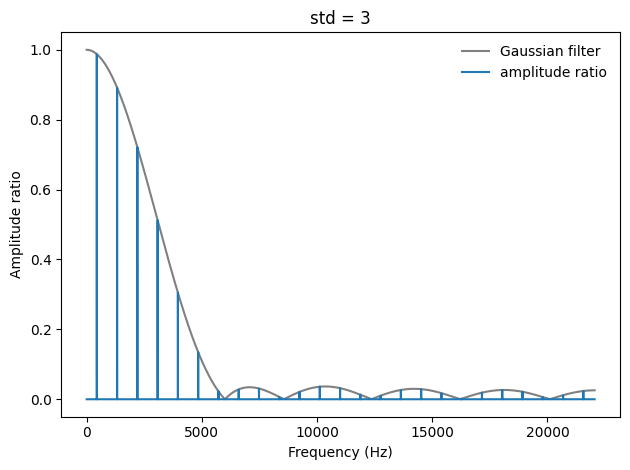

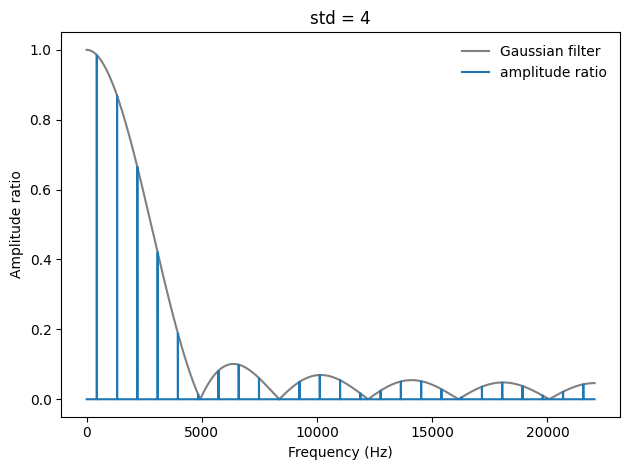

In [ ]:
for i in np.arange(1, 5, step=1):
    plt.title(f'std = {i}')
    plot_filter(std=i)

Как мы видим, при уменьшении `std` гауссово окно все меньше влияет на выделенный список частот, спадая медленнее, а при увеличении, наоборот, спадает достаточно быстро. Также, при увеличении `std` становятся заметнее боковые лепестки, о которых говорилось в пособии.


## lab 8.2
___

**Задание**: В этой главе утверждается, что преобразование Фурье гауссовой кривой также гауссова кривая. Для дискретного преобразования Фурье это сотношение приблизительно верно. Попробуйте его на нескольких примерах. Что происходит с преобразованием Фурье, если меняется `std`?

Проверим утверждение, воспользовавшись следующей функцией:

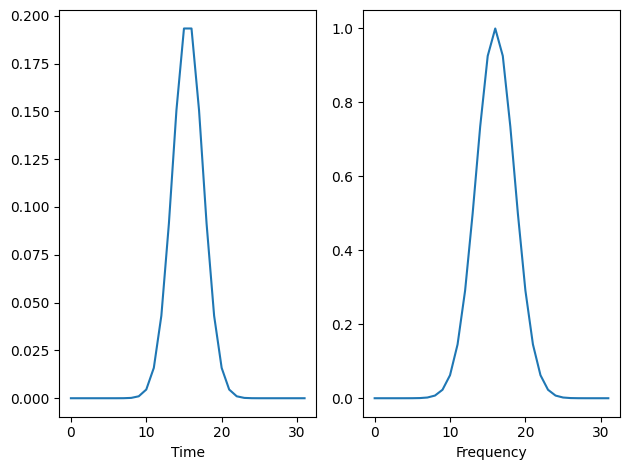

In [ ]:
def plot_gaussian(std):
    M = 2 ** 5
    gaussian = scipy.signal.windows.gaussian(M=M, std=std)
    gaussian /= sum(gaussian)

    plt.subplot(1, 2, 1)
    plt.plot(gaussian)
    decorate(xlabel='Time')

    fft_gaussian = np.fft.fft(gaussian)
    fft_rolled = np.roll(fft_gaussian, M//2)

    plt.subplot(1, 2, 2)
    plt.plot(np.abs(fft_rolled))
    decorate(xlabel='Frequency')
    plt.show()

plot_gaussian(2)

Эта функция создает гауссово окно с переданным значением `std`, и выводит его на экран. После этого выполняет преобразование Фурье и выводит получившуюся кривую рядом. Запустим этот код, меняя `std` слайдером (для удобства):

In [ ]:
slider = widgets.FloatSlider(min=0.1, max=20, value=2)
interact(plot_gaussian, std=slider)

interactive(children=(FloatSlider(value=2.0, description='std', max=20.0, min=0.1), Output()), _dom_classes=('…

<function __main__.plot_gaussian(std)>

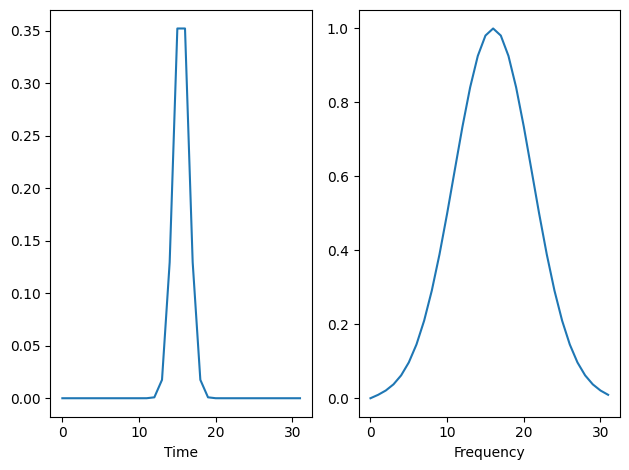

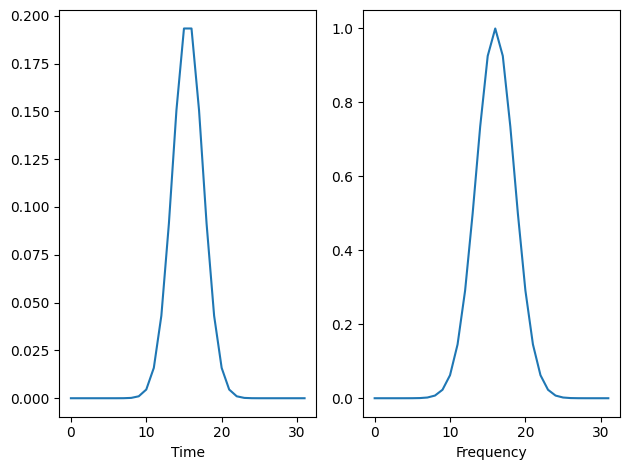

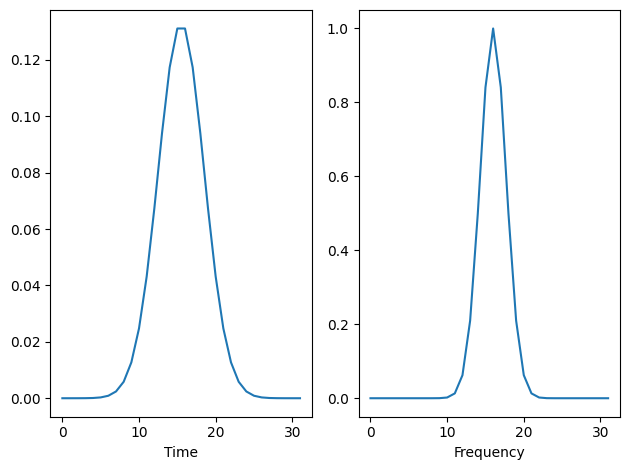

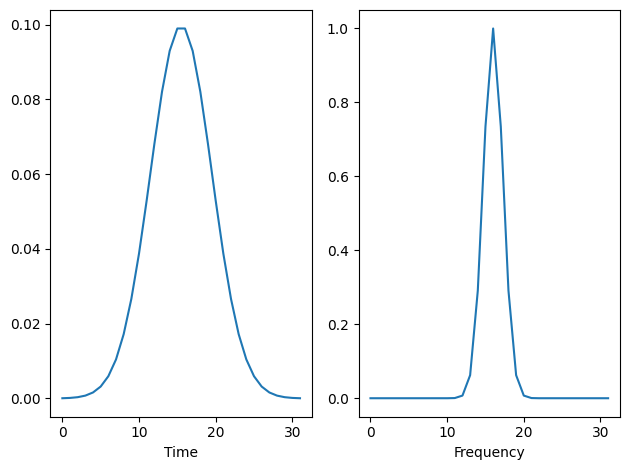

In [ ]:
for i in np.arange(1, 5, step=1):
    plot_gaussian(std=i)

Как мы видим, при увеличении `std` гауссовой прямой её версия после преобразования Фурье, напротив, становится уже. Это также следует из математиких преобразований. Гауссова прямая с математическим ожиданием, равным нулю и стандартным отклонением $1/𝑎$ выглядит следующим образом:

$𝑓(𝑥)=𝑒^(-ax^2)$

А его преобразование Фурье:

$𝐹(𝑘)=sqrt(𝜋/a)*e^((-𝜋^2k^2)/a)$

У этой Гауссовой прямой стандартное отклонение уже равно $𝑎/𝜋^2$. Следовательно, между этими функциями существует обратная зависимость, которую мы и наблюдаем при изменение параметра `std`.

## lab 8.3
___

**Задание**: В упражнениях к главе 3 изучалось влияние на утечки спектра окна Хэмминга и некоторых других, предоставляемых `NumPy`. Глубже понять эти окна можно, изучив их ДПФ. В дополнение к Гауссову окну, использованному в этой главе, необходимо создать окно Хемминга тех же размеров. Дополнить окно нулями и напечатать его ДПФ. Какое окно больше подходит для фильтра НЧ? Полезно напечатать ДПФ с логарифмическим масштабом по $y$. Поэкспериментировать с разными окнами и разными размерами этих окон.

Для начала создадим эти окна:

In [ ]:
gaussian = scipy.signal.windows.gaussian(M=M, std=std)
bartlett = np.bartlett(M)
blackman = np.blackman(M)
hamming = np.hamming(M)
hanning = np.hanning(M)

windows = [blackman, gaussian, hanning, hamming]
names = ['blackman', 'gaussian', 'hanning', 'hamming']

for window in windows:
    window /= sum(window)

Для гауссова окно было выбрано такое значение отклонения, чтоб гауссова кривая была похожа на остальные функции из списка.

Выведем получившиеся кривые на экран:

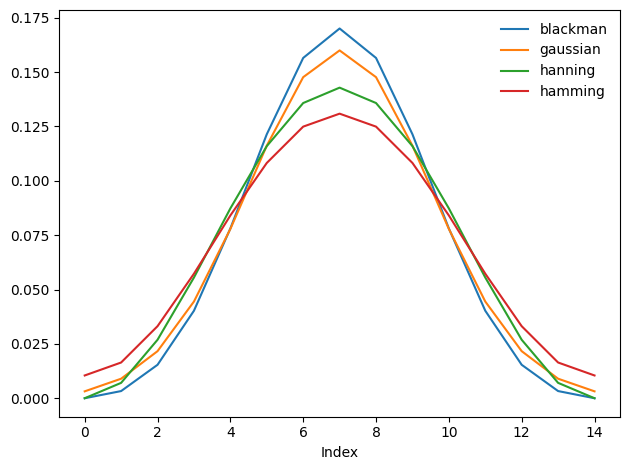

In [ ]:
for window, name in zip(windows, names):
    plt.plot(window, label=name)

decorate(xlabel='Index')

Теперь создадим функцию, которая добавит нули к концу оконной функции и распечатает получившееся ДПФ:

In [ ]:
def plot_window_dfts(windows, names):
    for window, name in zip(windows, names):
        padded =  zero_pad(window, 44100)
        dft_window = np.fft.rfft(padded)
        plt.plot(abs(dft_window), label=name)

Вызовем эту функцию:

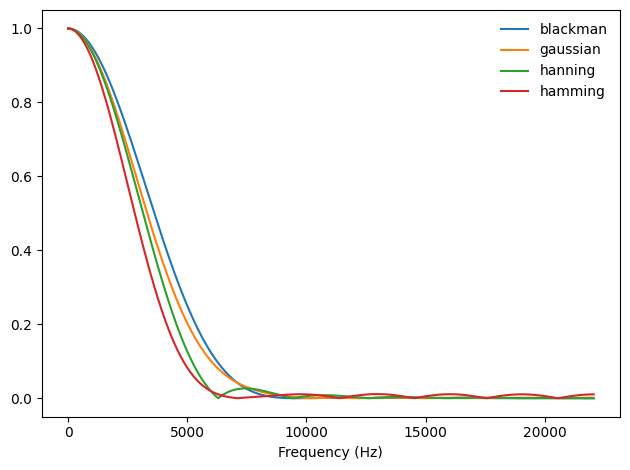

In [ ]:
plot_window_dfts(windows, names)
decorate(xlabel='Frequency (Hz)')

Как мы видим, быстрее всех спадает функция Хемминга, однако более точно можно будет сказать, если вывести этот график с логарифмической шкалой по $y$:

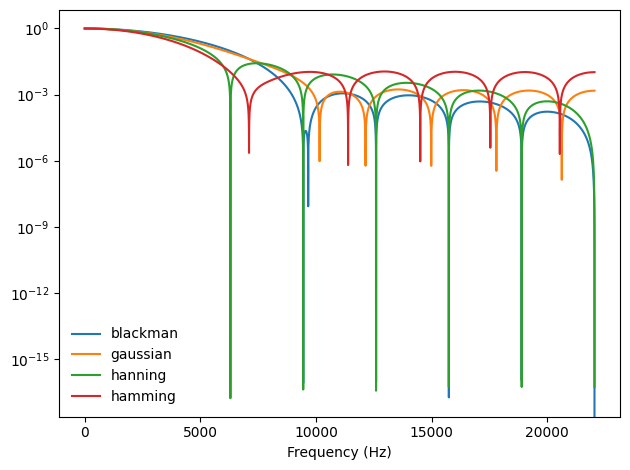

In [ ]:
plot_window_dfts(windows, names)
decorate(xlabel='Frequency (Hz)', yscale='log')

Так стало заметно, что функция Хеннинга спадает все же быстрее (хотя и не сильно), однако Хемминг тоже показывает хороший результат, в сравнении с функциями Гаусса и Блекмена. Также стоит отметить, что у окон Хемминга и Гаусса боковые лепестки более устойчивы и не проседают со временем.

Так можно сделать вывод, что функция Хеннинга является наилучшей, т.к. быстро спадает и имеет менее заметные лепестки.


#lab 9 - Дифференцирование и интегрирование
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from thinkdsp import CubicSignal, SawtoothSignal, TriangleSignal, decorate
import pandas as pd
import matplotlib.pyplot as plt
from thinkdsp import zero_pad
from thinkdsp import Wave, PI2

##lab 9.1
___

**Задание**: В разделе "Нарастающая сумма" на стр. 119 отмесено, что некоторые примеры не работают с апериодическими сигналами. Необходимо заменить периодический пилообразный сигнал на непереодические данные _Facebook_ и посмотреть, что пойдёт не так.

Для начала, как и требуется, подадим вместо пилообразного сигналаданные с биржи о компании Facebook:

In [ ]:
if not os.path.exists('FB_2.csv'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab9/FB_2.csv

In [ ]:
df = pd.read_csv('FB_2.csv', header=0, parse_dates=[0])
ys = df['Close']
if len(ys) % 2:
    ys = ys[:-1]
in_wave = Wave(ys, framerate=1)

Также посмотрим на спектр этой волны:

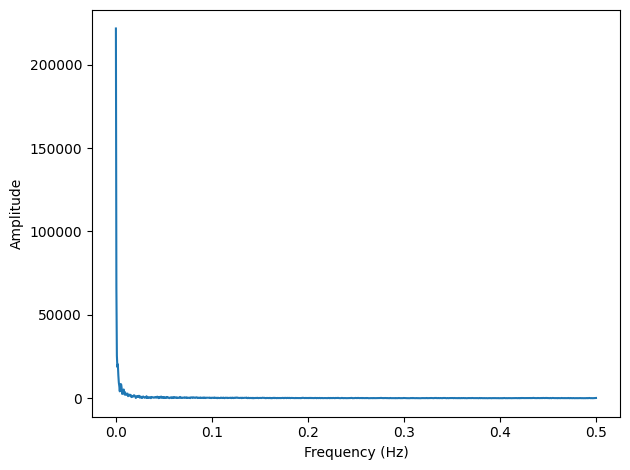

In [ ]:
in_spectrum = in_wave.make_spectrum()
in_spectrum.plot()
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

Теперь воспользуемся методом cumsum (аппроксимация к интегрированию):

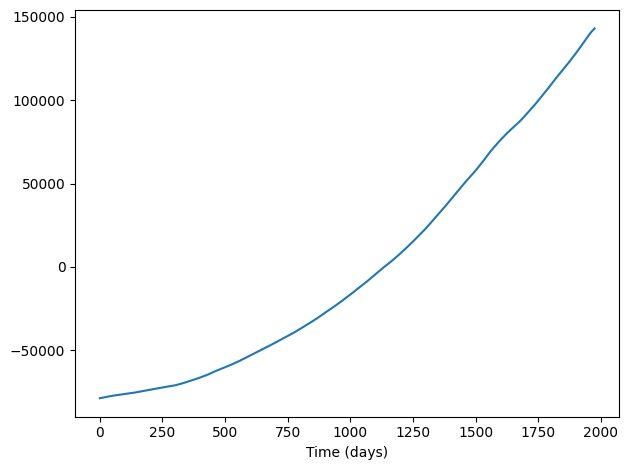

In [ ]:
out_wave = in_wave.cumsum()
out_wave.unbias()
out_wave.plot()
decorate(xlabel='Time (days)')

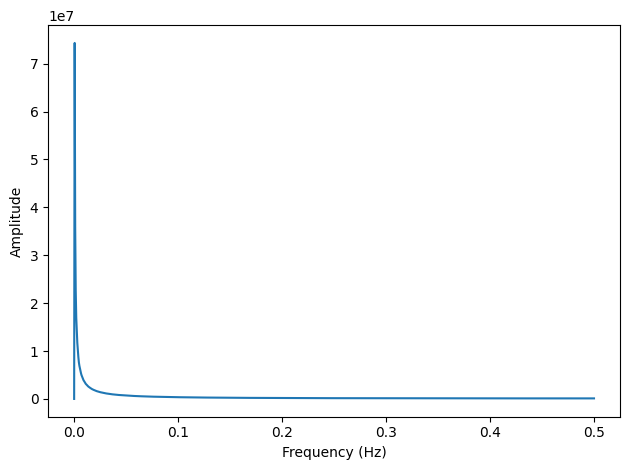

In [ ]:
out_spectrum = out_wave.make_spectrum()
out_spectrum.plot()
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

Сразу заметны различия с методическими материалами. Получившийся график – просто возрастающая линия, а не повторяющийся сигнал. Теперь посмотрим на разницу между спектром входной и выходной волны:


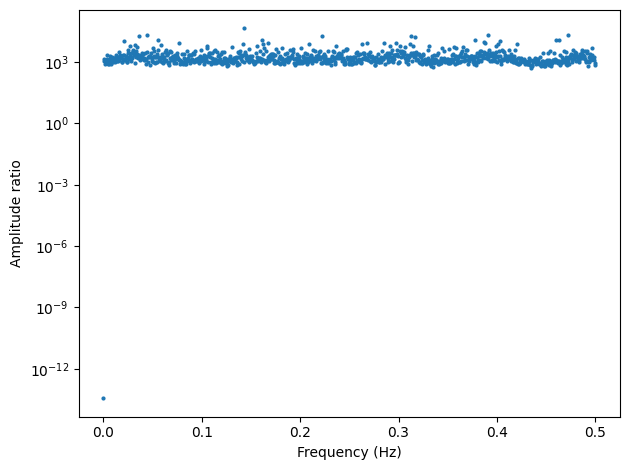

In [ ]:
ratio_spectrum = out_spectrum.ratio(in_spectrum, thresh=1)
ratio_spectrum.plot(marker='.', ms=4, ls='')

decorate(xlabel='Frequency (Hz)',
         ylabel='Amplitude ratio',
         yscale='log')

Как мы видим, вместо кривой линии с четкой зависимостью, мы получили какие-то случайные точки. Попробуем нормализовать исходную волну, тогда получим следующие графики:

##lab 9.2
___

**Задание**: В этом упражжнении изучается влияение `diff` и `differetiate` на сигнал. Создать треугольный сигнал и напечатать его. Применить `diff` к сигналу и напечатать результат. Вычислить спектр треугольного сигнала, применить `differentiate` и напечатать результат. Преобразоватьспектр обратно в сигнал и напечатать его. Определить, есть ли воздействия `deff` и `differentiate` на этот сигнал.

Далее посмотрим на особенность работы `diff` и `differentiate` методов. `Diff` – взятие производной, используя разность между соседними элементами – аппроксимация в временной области. `Differentiate` – взятие производной, используя соответствующую формулу, выведенную в методических материалах в частотной области. Создадим треугольный сигнал:

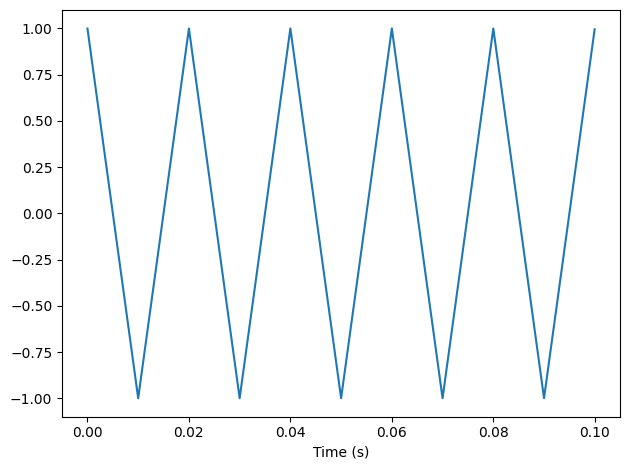

In [ ]:
in_wave = TriangleSignal(freq=50).make_wave(duration=0.1, framerate=44100)
in_wave.plot()
decorate(xlabel='Time (s)')

Поскольку сигнал сначала равномерно возрастает, а потом равномерно уменьшается при получении разницы мы будем получать одинаковые числа с разными знаками. Убедимся в этом:

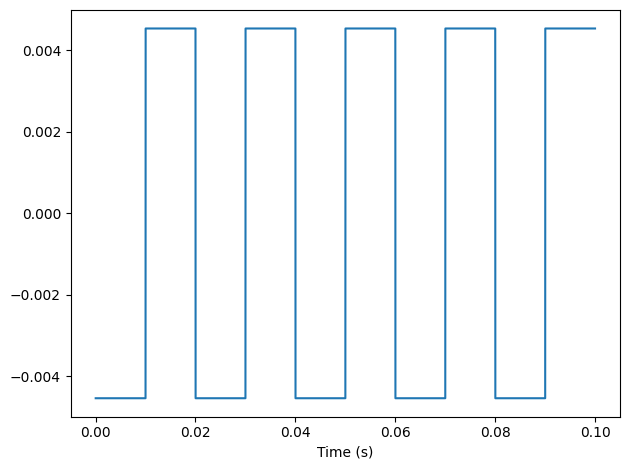

In [ ]:
out_wave = in_wave.diff()
out_wave.plot()
decorate(xlabel='Time (s)')

Теперь посмотрим, что будет если применить функцию `differentiate`:

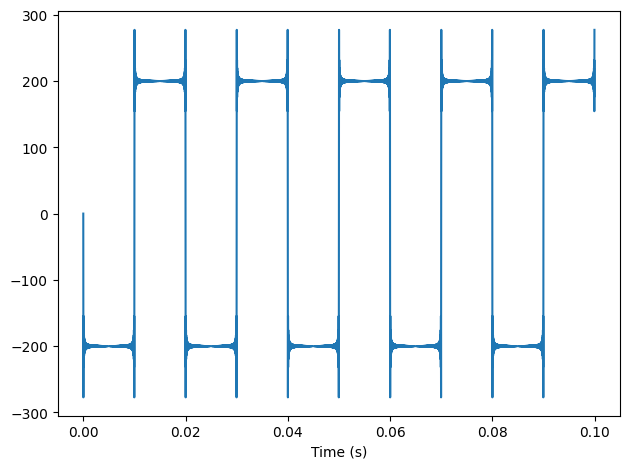

In [ ]:
out_wave2 = in_wave.make_spectrum().differentiate().make_wave()
out_wave2.plot()
decorate(xlabel='Time (s)')

Сигнал похож, однако мы видим «звон» вокруг мест, где на исходном графике был угол. Они возникают т.к. в этих точках нет производных.

##lab 9.3
___

**Задание**: В данном упражнении изучается влияние `cumsum` и `integrate` на сигнал. Создать прямоугольный сигнал и напечатать его. Применить `cumsum` и напечатать результат. Преобразовать спектр обратно в сигнал и напечатать его. Есть ли различия в воздействии `cumsum` и `integrate` на этот сигнал?

Теперь рассмотрим интегрирование и её аппроксимацию во временной области – `cumsum`. Создадим прямоугольный сигнал:


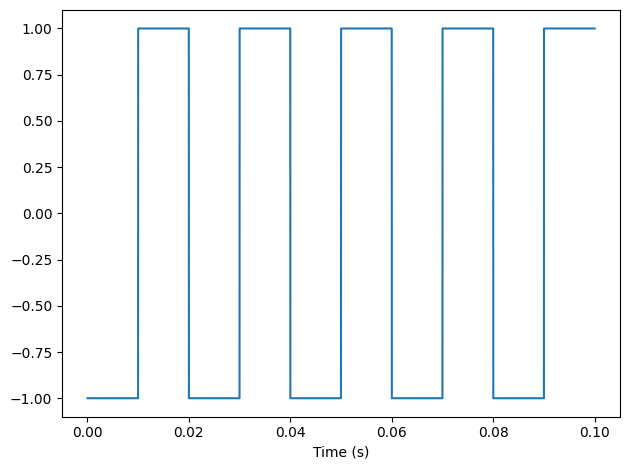

In [ ]:
in_wave = SquareSignal(freq=50).make_wave(duration=0.1, framerate=44100)
in_wave.plot()
decorate(xlabel='Time (s)')

В прошлом упражнении мы узнали, что производной треугольного сигнала будет  прямоугольный, значит обратная операция интегрирования должна дать нам треугольный сигнал. Проверим это во временной области:

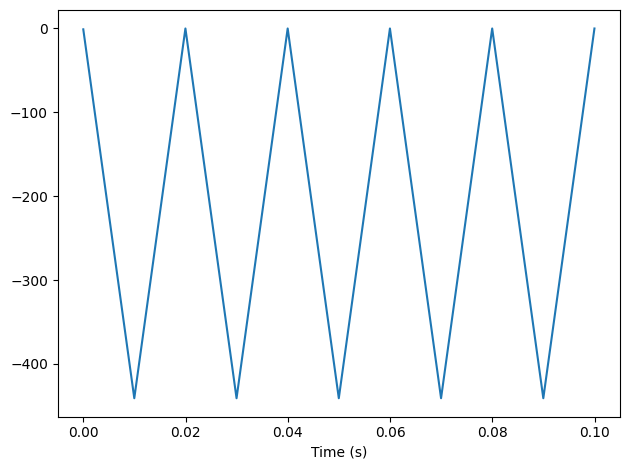

In [ ]:
out_wave = in_wave.cumsum()
out_wave.plot()
decorate(xlabel='Time (s)')

Теперь выполним интегрирование, используя `integrate` в частотной области:

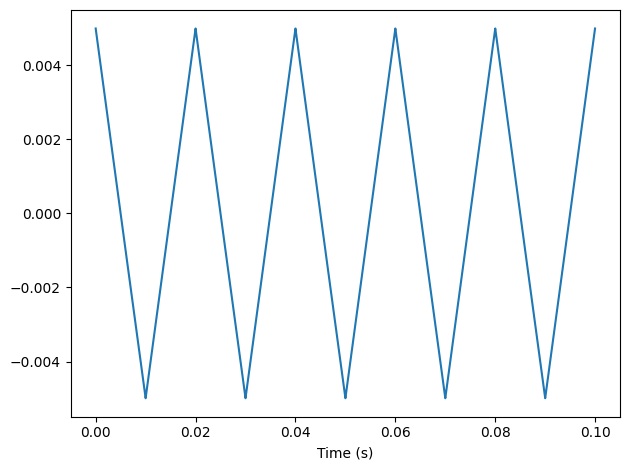

In [ ]:
spectrum = in_wave.make_spectrum().integrate()
spectrum.hs[0] = 0
out_wave2 = spectrum.make_wave()
out_wave2.plot()
decorate(xlabel='Time (s)')

Он совпадает по форме с предыдущим сигналом, полученным аппроксимацией на временной шкале. Нормируем их, выровняем и посмотрим, совпадают ли они:

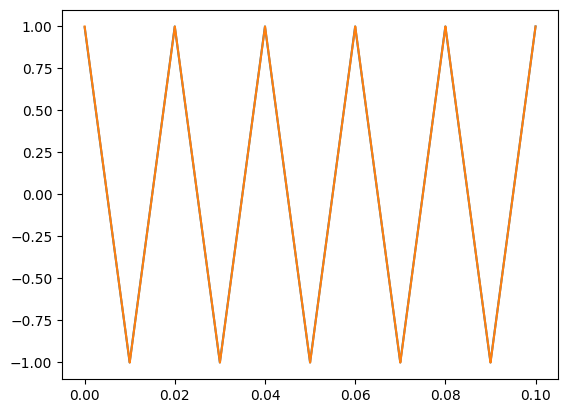

In [ ]:
out_wave.unbias()
out_wave.normalize()
out_wave2.normalize()
out_wave.plot()
out_wave2.plot()

Как мы видим эти графики совпадают с точностью до погрешности вычислений.

In [ ]:
out_wave.max_diff(out_wave2)

0.0045351473922902175

##lab 9.4
___

**Задание**: В данном упражнении изучается влияение двойного интегрирования. Необходимо создать пилообразный сигнал, вычислить его спектр, а затем дважды применить `integrate`. Напечатать результирующий сигнал и его спектр. Какова математическая форма сигнала? Почему он напоминает синусоиду?

Посмотрим на то, как меняется сигнал при двойном интегрировании. Создадим пилообразный сигнал:

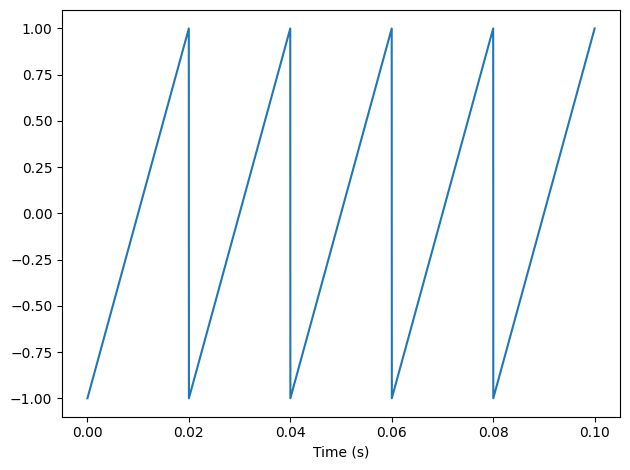

In [ ]:
in_wave = SawtoothSignal(freq=50).make_wave(duration=0.1, framerate=44100)
in_wave.plot()
decorate(xlabel='Time (s)')

Применим метод cumsum для интегрирования:

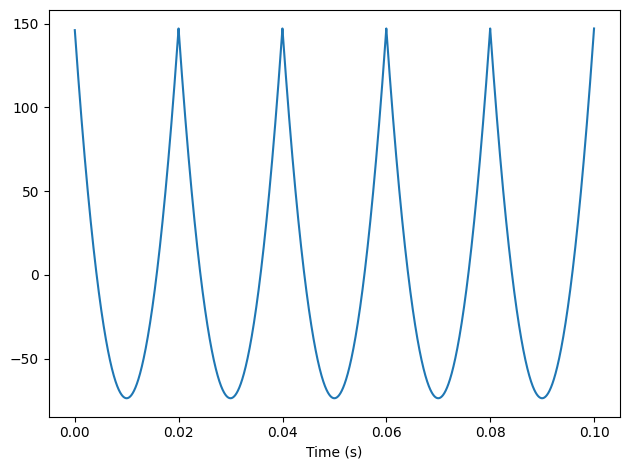

In [ ]:
out_wave = in_wave.cumsum()
out_wave.unbias()
out_wave.plot()
decorate(xlabel='Time (s)')

Теперь повторим и получим второй интеграл:

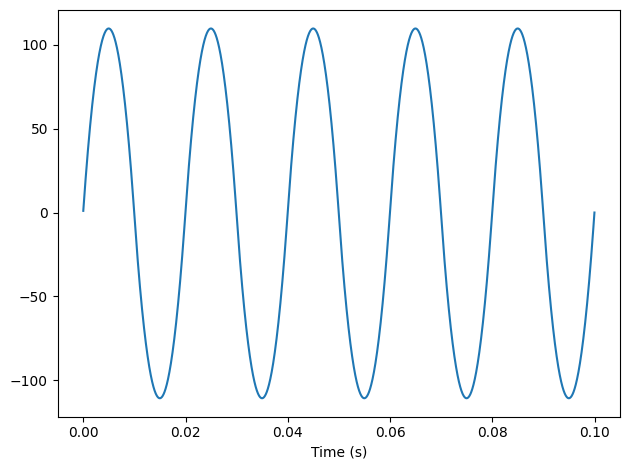

In [ ]:
out_wave = out_wave.cumsum()
out_wave.plot()
decorate(xlabel='Time (s)')

Проверим результат, используя integrate в частотной области:

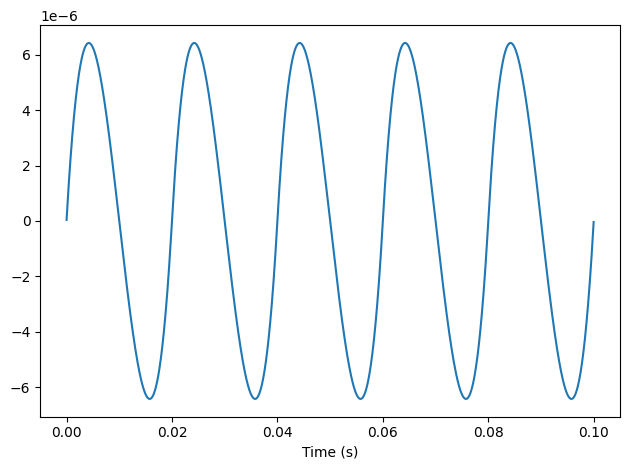

In [ ]:
spectrum = in_wave.make_spectrum().integrate().integrate()
spectrum.hs[0] = 0
out_wave2 = spectrum.make_wave()
out_wave2.plot()
decorate(xlabel='Time (s)')

Как мы видим, сигнал все ближе к синусойде. Чтоб разобраться почему так происходит взглянем на спектр этого сигнала:

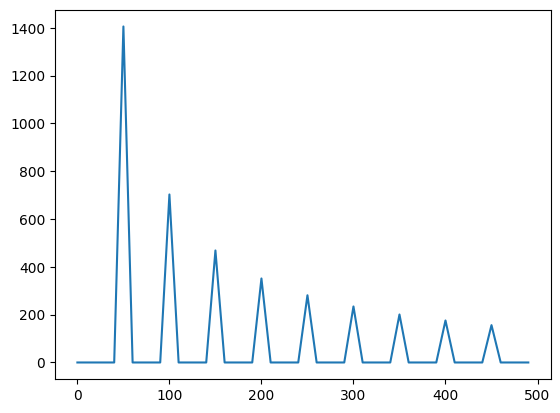

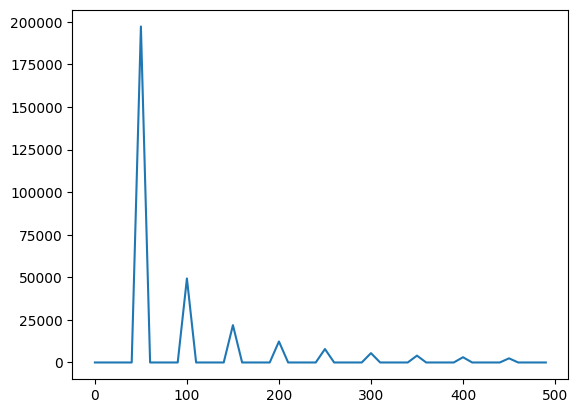

In [ ]:
in_wave.make_spectrum().plot(high=500)
plt.show()
out_wave.make_spectrum().plot(high=500)
plt.show()

Как мы видим, интегрирование схоже с `low pass` фильтром, из-за чего после двух
интегрирования у нас остался в основном только фундаментальный сигнал. Это значит, что наш сигнал в основном – синусоида с фундаментальной частотой.

##lab 9.5
___

**Задание**: В этом упражнении изучается влияние второй разности и второй производной. Создать `CubicSignal` , определённый в `thinkdsp`. Вычислить вторую производную, дважды применив `differentiate` к спектру. Определить, похожи ли результаты.

распечатать фильтры, соответствующие второй разнице и второй производной, и сравнить их. Подсказка: для того, чтобы получить фильтры в одном масштабе, испольщовать сигнал с частотой кадров = 1.

А теперь посмотрим на влияние второй разности и второй производной. Создадим `CubicSignal`:

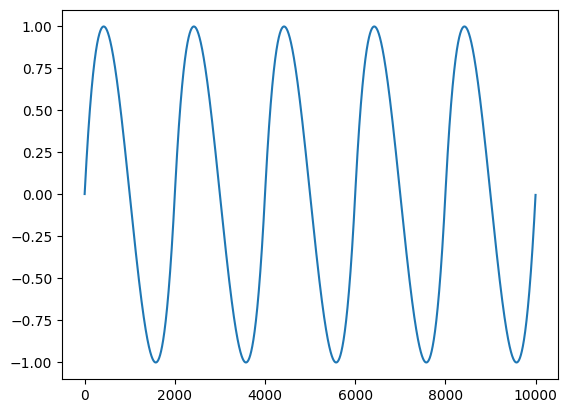

In [ ]:
in_wave = CubicSignal(freq=0.0005).make_wave(duration=10000, framerate=1)
in_wave.plot()

Возьмем первую и вторую разность:

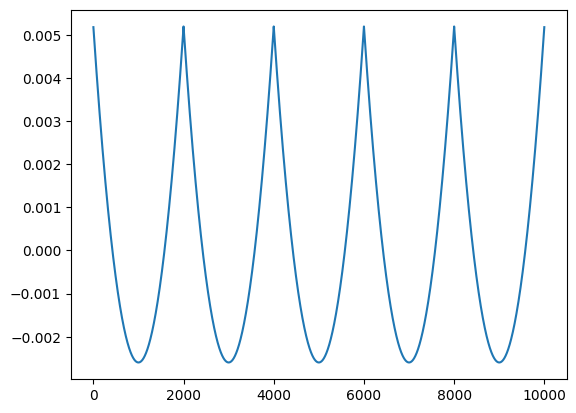

In [ ]:
out_wave = in_wave.diff()
out_wave.plot()

Ожидаемо мы получили пилообразный сигнал (в прошлом пункте мы, наоборот, получали из пилообразного `CubricSignal`). Также попробуем использовать `differentiate` и сравнить с полученным нами сигналом:

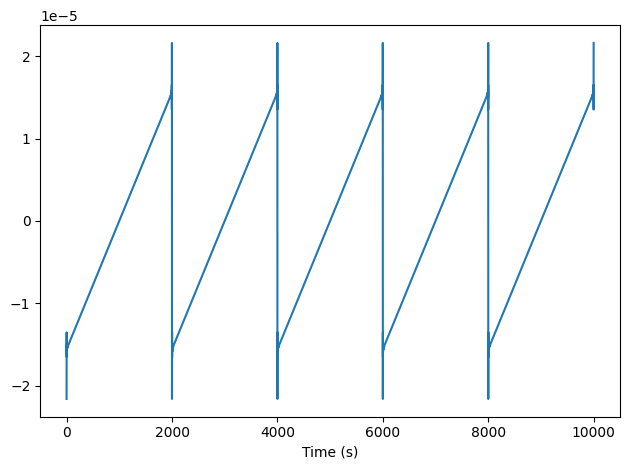

In [ ]:
spectrum = in_wave.make_spectrum().differentiate().differentiate()
out_wave2 = spectrum.make_wave()
out_wave2.plot()
decorate(xlabel='Time (s)')

Как мы видим, мы получили схожие графики с помаркой на неопределенность производной в точках перегиба. Теперь сравним фильтры второй производной и второй разности. Создадим фильтр второй разности:


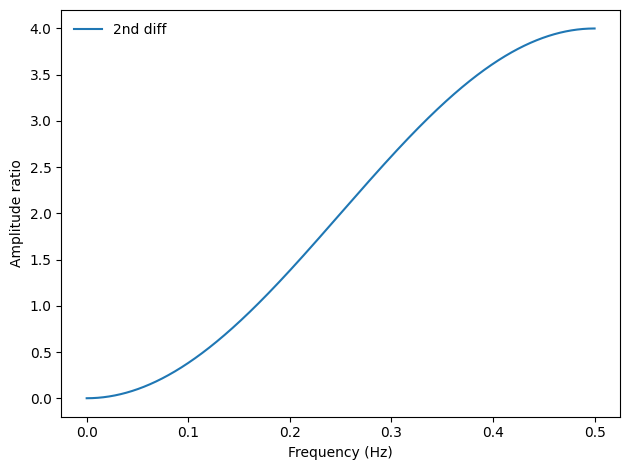

In [ ]:
diff_window = np.array([-1.0, 2.0, -1.0])
padded = zero_pad(diff_window, len(in_wave))
diff_wave = Wave(padded, framerate=in_wave.framerate)
diff_filter = diff_wave.make_spectrum()
diff_filter.plot(label='2nd diff')

decorate(xlabel='Frequency (Hz)',
                 ylabel='Amplitude ratio')

Также создадим график для второй производной:

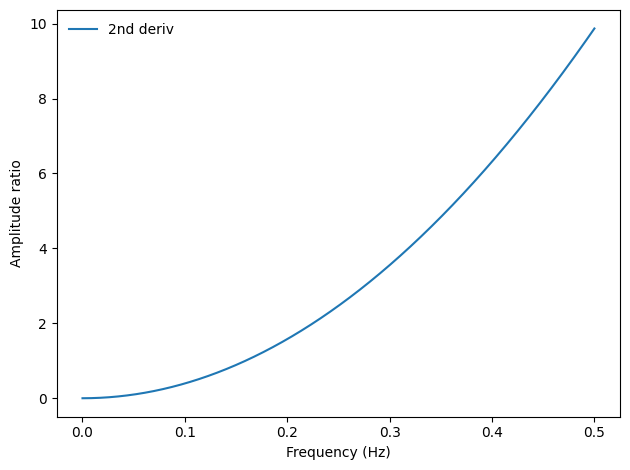

In [ ]:
deriv_filter = in_wave.make_spectrum()
deriv_filter.hs = (PI2 * 1j * deriv_filter.fs)**2
deriv_filter.plot(label='2nd deriv')

decorate(xlabel='Frequency (Hz)',
                 ylabel='Amplitude ratio')

Напечатаем эти графики на одном окне для удобства сравнения:

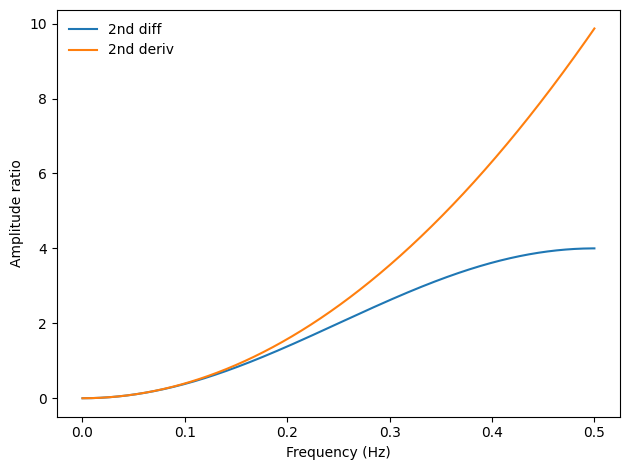

In [ ]:
diff_filter.plot(label='2nd diff')
deriv_filter.plot(label='2nd deriv')

decorate(xlabel='Frequency (Hz)',
                 ylabel='Amplitude ratio')

Оба фильтра являются `high pass` фильтрами. Вторая разность является хорошим приближением ко второй производной только на низких частотах, однако ближе к высоким она имеет значительные различия.

#lab 10 - Линейные стационарные системы

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py

In [ ]:
from thinkdsp import read_wave, decorate

##lab 10.1
___

**Задание**: В разделе "Системы и свёртка" на стр. 131 свёртка описана как сумма сдвинутых и масштабированных копий сигнала.

А в разделе Акустическая характеристика" на стр. 128 умножение ДПФ сигнала на передаточную функцию соответствует _кругойвой свёртке_, но в предположении периодичности сигнала. В результате можно заметиь, что на выходе, в начале фрагмента, слышна лишняя нота, "затекшая" из конца этого фрагмента.

К счастью, есть стандартное решение этой проблемы. Если перед вычислением ДПФ добавить достаточно нулей в конец сигнала, эффекта "заворота" можно избежать.

В методических материалах в разделе «Акустическая характеристика» при умножении ДПФ сигнала на передаточную функцию в начале результирующего фрагмента слышна лишняя нота. Этот эффект «заворота» появляется в связи с тем, что данная операция соответствует круговой свертке. Его можно избежать, добавив в конец сигнала перед DPF несколько нулей. Проверим это. Сначала откроем сигнал выстрела:

In [ ]:
if not os.path.exists('gunshot.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab10/gunshot.wav

--2024-05-18 21:06:10--  https://github.com/MatNepo/Telecom2024/raw/main/lab10/gunshot.wav
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/gunshot.wav [following]
--2024-05-18 21:06:10--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/gunshot.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 379256 (370K) [audio/wav]
Saving to: ‘gunshot.wav’

gunshot.wav         100%[===================>] 370.37K  --.-KB/s    in 0.04s   

2024-05-18 21:06:11 (8.80 MB/s) - ‘gunshot.wav’ saved [379256/379256]



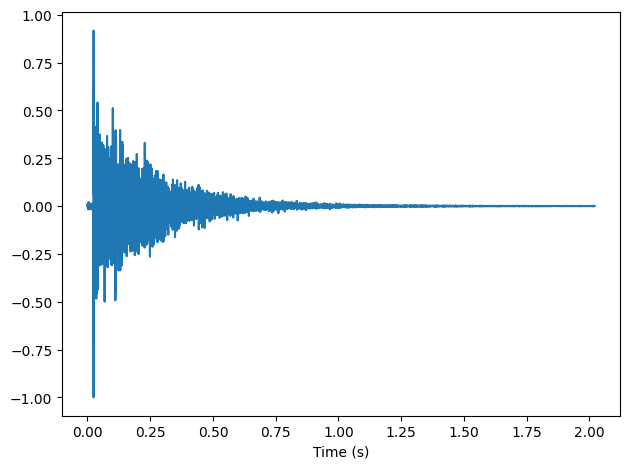

In [ ]:
response = read_wave('gunshot.wav')
start = 0.12
response = response.segment(start=start)
response.shift(-start)
response.normalize()
response.plot()
decorate(xlabel='Time (s)')

Также откроем звук скрипки (не забудем обрезать его, чтоб сегменты были одинаковой длинны)

In [ ]:
if not os.path.exists('violin.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab10/violin.wav

--2024-05-18 21:09:05--  https://github.com/MatNepo/Telecom2024/raw/main/lab10/violin.wav
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/violin.wav [following]
--2024-05-18 21:09:05--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/violin.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 441044 (431K) [audio/wav]
Saving to: ‘violin.wav’

violin.wav          100%[===================>] 430.71K  --.-KB/s    in 0.04s   

2024-05-18 21:09:05 (9.62 MB/s) - ‘violin.wav’ saved [441044/441044]



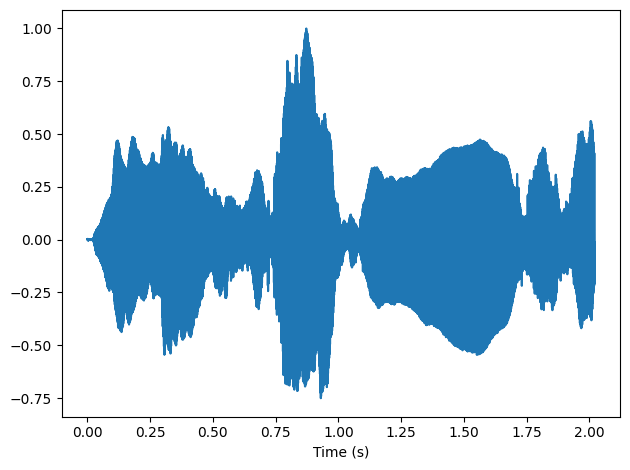

In [ ]:
# Open violin wave
violin = read_wave('violin.wav')
start = 0.11
violin = violin.segment(start=start)
violin.shift(-start)
violin.truncate(len(response))
violin.normalize()
violin.plot()
decorate(xlabel='Time (s)')

In [ ]:
violin.make_audio()

Повторим операцию из методических материалов:

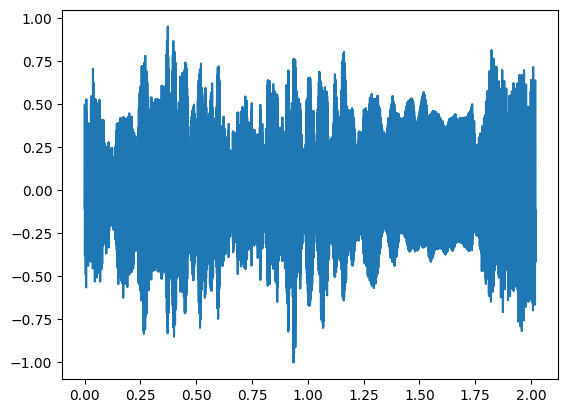

In [ ]:
transfer = response.make_spectrum()
spectrum = violin.make_spectrum()
output = (spectrum * transfer).make_wave()
output.normalize()
output.plot()
output.make_audio()

Здесь мы слышим эффект «заворота». Избавимся от него, добавим в конец этих аудио
фрагментов нули

In [ ]:
response.zero_pad(len(response) * 2)
violin.zero_pad(len(violin) * 2)

Повторим преобразование и получим следующие графики:

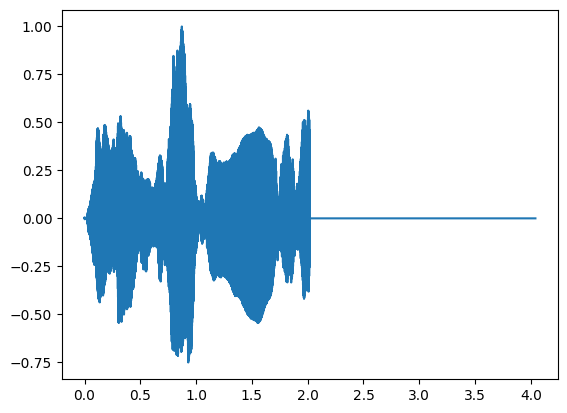

In [ ]:
violin.plot()

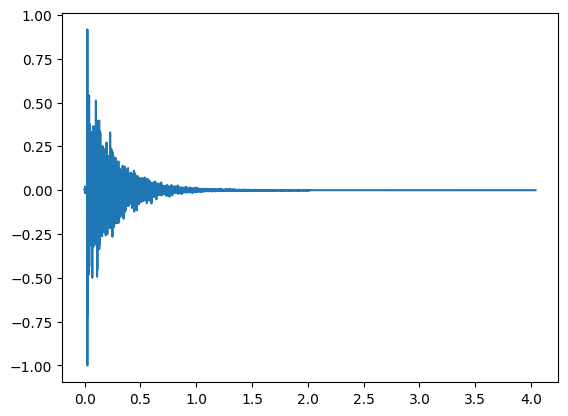

In [ ]:
response.plot()

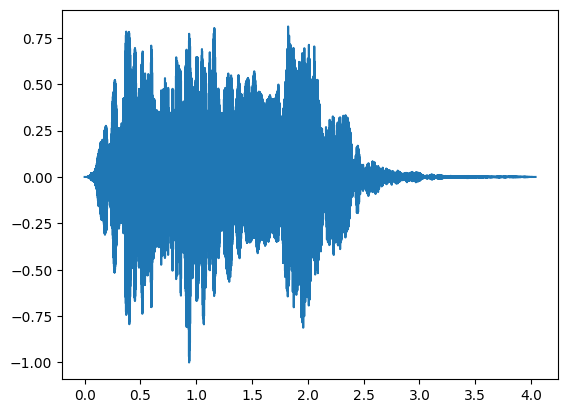

In [ ]:
transfer = response.make_spectrum()
spectrum = violin.make_spectrum()
output = (spectrum * transfer).make_wave()
output.normalize()
output.plot()
output.make_audio()

Как мы видим на последнем графике отсутствует всплеск в начале, который мы наблюдаем на первом графике. Следовательно, нам получилось избавиться от эффекта «заворота», что слышно при прослушивании записей с `zero_pad` и без него.


##lab 10.2
___

**Задание**: Библиотека OpenAIR (свободный эфир) - это "централизованный... онлайн-ресурс для тех, кто интересуется аурализацией и данными акустической испульсной характеристики" (http://www.openairlib.net). Просмотреть эту коллекцию импульсных характеристик и скачать то звучание, которое покажется интереснее. Найти короткие записи с той же частотой дискретизации, что и у скаченной импульсной характеристики.

Смоделировать двумя способами звучание записи в том пространстве, где была измерена импульсная характеристика, как сверткой самой записи с импульсной характеристикой, так и умножением ДПФ записи на вычисленный фильтр, соответствующий импульсной характеристике.

In [ ]:
if not os.path.exists('stalbans_a_mono.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab10/stalbans_a_mono.wav

--2024-05-18 21:30:37--  https://github.com/MatNepo/Telecom2024/raw/main/lab10/stalbans_a_mono.wav
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/stalbans_a_mono.wav [following]
--2024-05-18 21:30:37--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/stalbans_a_mono.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 793906 (775K) [audio/wav]
Saving to: ‘stalbans_a_mono.wav’

stalbans_a_mono.wav 100%[===================>] 775.30K  --.-KB/s    in 0.05s   

2024-05-18 21:30:37 (14.3 MB/s) - ‘stalbans_a_mono.wav’ saved [793906/793906]



Выполним моделирование звучание записи в каком-то другом пространстве. Откроем звук, который будет описывать наше пространство:

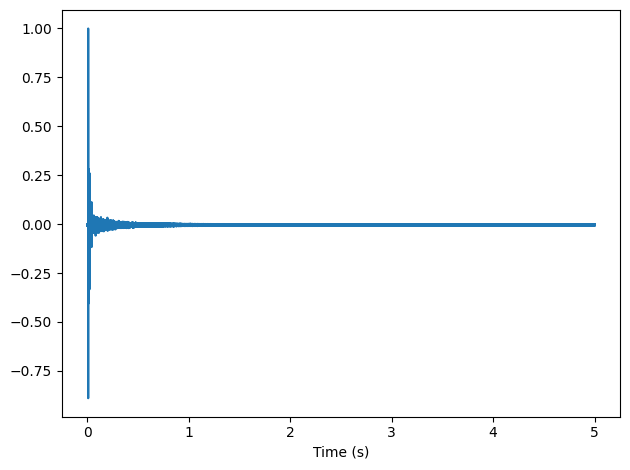

In [ ]:
response = read_wave('stalbans_a_mono.wav')
duration = 5
response = response.segment(duration=duration)
response.normalize()
response.plot()
decorate(xlabel='Time (s)')

In [ ]:
response.make_audio()

Этот звук звучит как хлопок с последующим эхом. Создадим спектр этого звука:

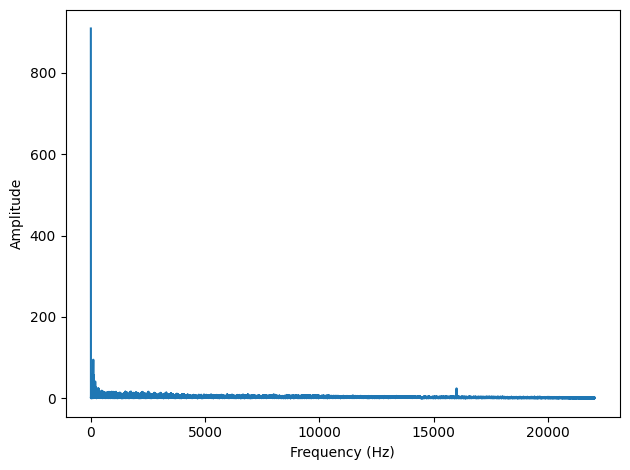

In [ ]:
transfer = response.make_spectrum()
transfer.plot()
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

In [ ]:
if not os.path.exists('trumpet.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab10/trumpet.wav

--2024-05-18 21:33:08--  https://github.com/MatNepo/Telecom2024/raw/main/lab10/trumpet.wav
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/trumpet.wav [following]
--2024-05-18 21:33:08--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab10/trumpet.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1540668 (1.5M) [audio/wav]
Saving to: ‘trumpet.wav’

trumpet.wav         100%[===================>]   1.47M  --.-KB/s    in 0.07s   

2024-05-18 21:33:08 (22.1 MB/s) - ‘trumpet.wav’ saved [1540668/1540668]



Теперь откроем запись трубы и обрежем её таким образом, чтоб она соответствовала длине звука хлопка:

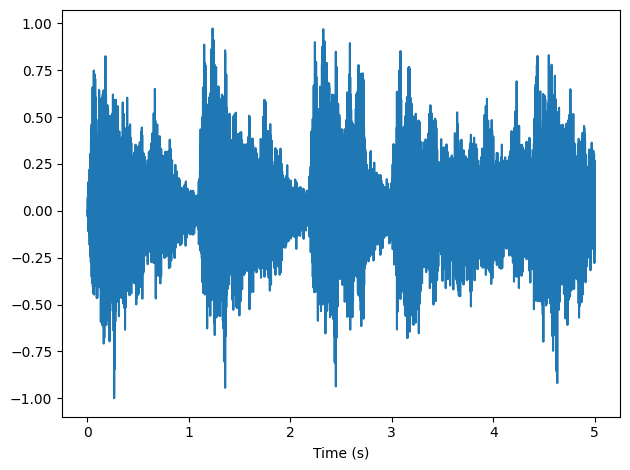

In [ ]:
wave = read_wave('trumpet.wav')
wave.truncate(len(response))
wave.normalize()
wave.plot()
decorate(xlabel='Time (s)')

In [ ]:
wave.make_audio()

Преобразуем этот звук в спектр:

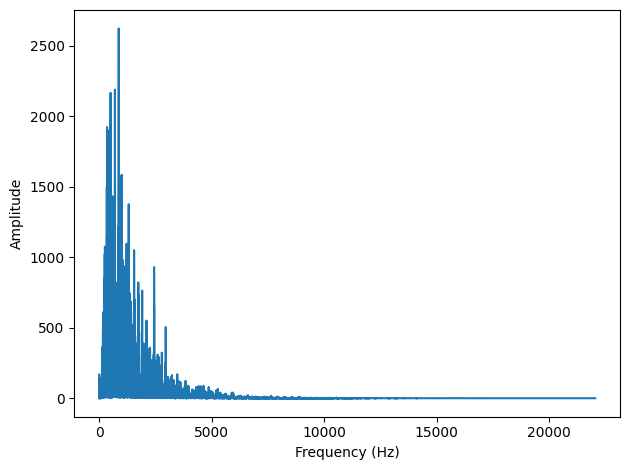

In [ ]:
spectrum = wave.make_spectrum()
spectrum.plot()
decorate(xlabel='Frequency (Hz)', ylabel='Amplitude')

Теперь мы можем получить звук трубы в пространстве хлопка используя умножение:

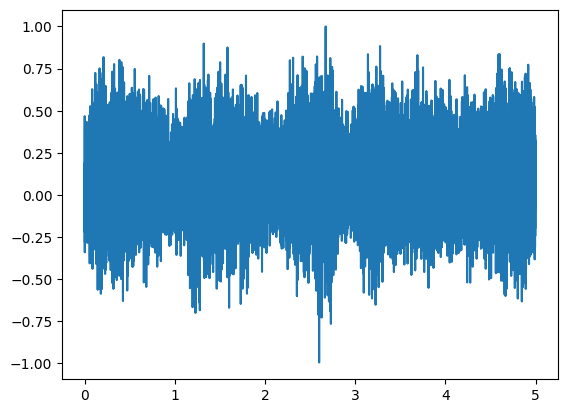

In [ ]:
output = (spectrum * transfer).make_wave()
output.normalize()
output.plot()

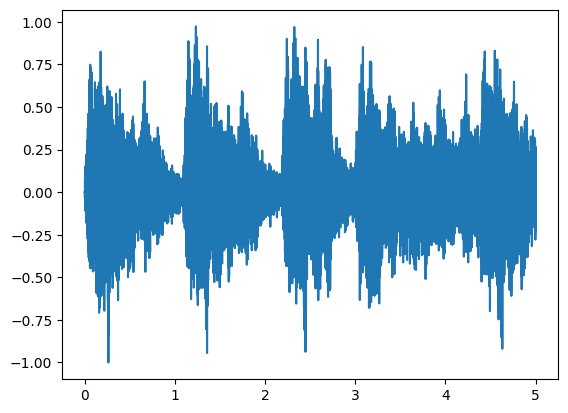

In [ ]:
wave.plot()

In [ ]:
output.make_audio()

Как было показано в прошлом пункте упражнений этот звук не совсем корректный из-за эффекта «заворота», однако конкретно в этом примере его не слышно.

Второй способ получить звучание записи трубы в комнате с хлопком – метод `convolve`:

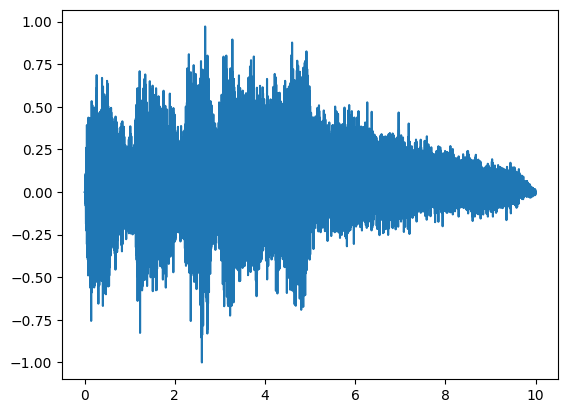

In [ ]:
convolved2 = wave.convolve(response)
convolved2.normalize()
convolved2.plot()
convolved2.make_audio()

Из полученных графиков видно, что оба метода возвращают волну, которая соответствует звуку в пространстве другого, однако метод `convolve` разработан специально для этого, поэтому не требует дополнительных манипуляций для получения корректного результата.

#lab 11 - Модуляция и выборка (квантование)
___

In [ ]:
# Get thinkdsp.py

import os

if not os.path.exists('thinkdsp.py'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab5/thinkdsp.py

##lab 11.3
___

**Задание**: При взятии выборок из сигнала при слишком низкой частоте кадров составляющие, большие частоты заворота дадут биения. В таком случае эти компоненты не отфильтруешь, поскольку они неотличимы от более низких частот.

Полезно отфильтровать эти частоты до выборки; фильтр НЧ, используемый для этой цели, называется _фильтр сглаживания_.

Вернуться к примеру "Соло на барабане", применить фильтр НЧ до выборки, а затем, опять же с помощью фильтра НЧ, удалить спектральные копии, вызванные выборкой. Результат должен бытьидентичен отфильтрованному сигналу.

In [ ]:
if not os.path.exists('drums.wav'):
    !wget https://github.com/MatNepo/Telecom2024/raw/main/lab11/drums.wav

--2024-05-18 21:47:26--  https://github.com/MatNepo/Telecom2024/raw/main/lab11/drums.wav
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab11/drums.wav [following]
--2024-05-18 21:47:26--  https://raw.githubusercontent.com/MatNepo/Telecom2024/main/lab11/drums.wav
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1058544 (1.0M) [audio/wav]
Saving to: ‘drums.wav’

drums.wav           100%[===================>]   1.01M  --.-KB/s    in 0.06s   

2024-05-18 21:47:27 (17.4 MB/s) - ‘drums.wav’ saved [1058544/1058544]



Для начала откроем только что скаченный звук барабанов:

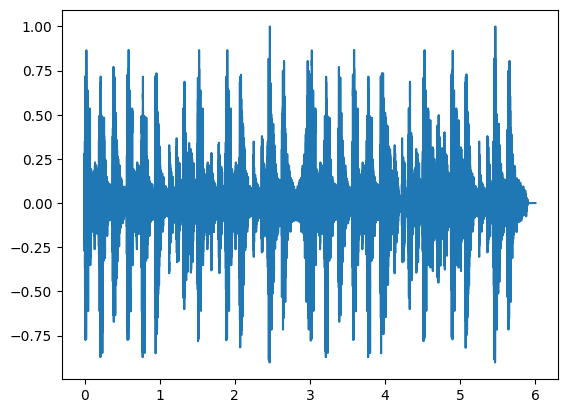

In [ ]:
wave = read_wave('drums.wav')
wave.normalize()
wave.plot()
wave.make_audio()

Создадим его спектр:

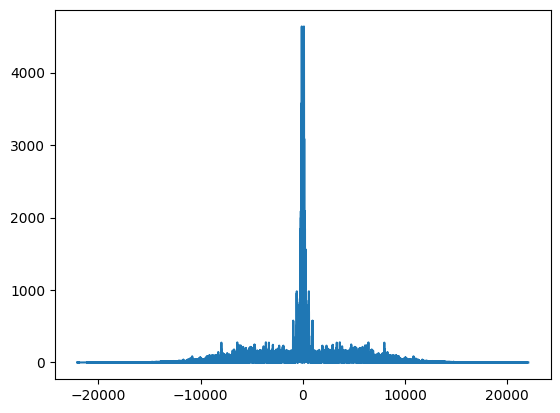

In [ ]:
spectrum = wave.make_spectrum(full=True)
spectrum.plot()

Видно , что спектр этого сигнала « расплывается » и имеет з аметную амплитуда даже на 10 МГц Из за этог о при взятии выборок этог о сигнала эти «края» будут накладываться друг на друга и создавать помехи И сп равим это , применив в это т момент фильтр низких частот частот:

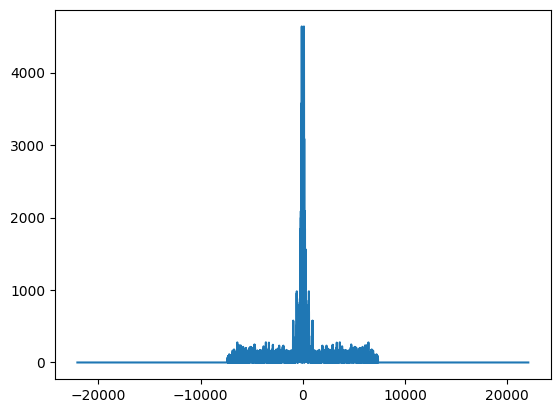

In [ ]:
factor = 3
framerate = wave.framerate / factor
cutoff = framerate / 2 - 1
spectrum.low_pass(cutoff)
spectrum.plot()

`cutoff` фильтр с каким значением применить к с пектру , рассчитывается авто матически, основыв аясь на частоте кадров и количестве выборок.

После фильтра НЧ получаем следующий спектр:

In [ ]:
filtered = spectrum.make_wave()
filtered.make_audio()

Звук практически не поменялся. Далее пойдем по методическим материалам и возьмем выборку:

In [ ]:
def sample(wave, factor):
    ys = np.zeros(len(wave))
    ys[::factor] = np.real(wave.ys[::factor])
    return Wave(ys, framerate=wave.framerate)
sampled = sample(filtered, factor)
sampled.make_audio()

В ходе прослушивания слышно постор онние высо кочастотные звуки, убедимся в этом , посмотрим на спектр сигнала

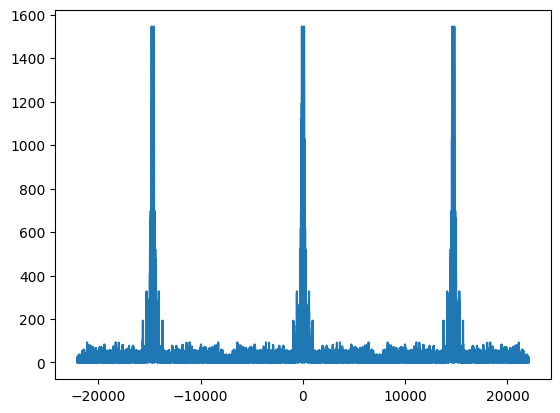

In [ ]:
sampled_spectrum = sampled.make_spectrum(full=True)
sampled_spectrum.plot()

На графике можно увидеть дополнительные копии спектра в районе высоких частот, однако благодаря тому, что мы применили фильтр они не наложились друг на друга, и мы можем избавиться от лишнего спектра применив повторно фильтр НЧ:

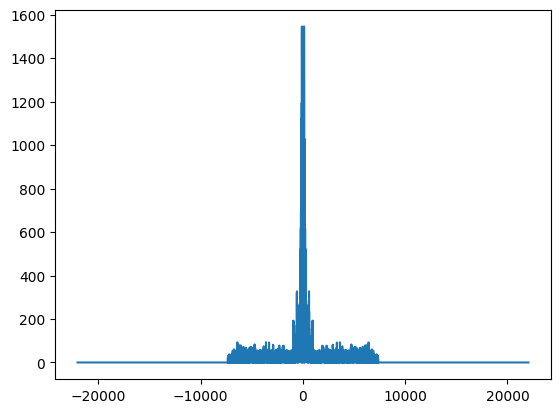

In [ ]:
sampled_spectrum.low_pass(cutoff)
sampled_spectrum.plot()

Как мы видим, данный спектр по форме очень напоминает исходный за исключением амплитуды, которая уменьшилась в 3 (`factor`) раза

Умножим получившийся спектр на `factor` и сравним исходный сигнал после фильтра низких частот и получившийся после выборки:

In [ ]:
sampled_spectrum.scale(factor)
display(spectrum.max_diff(sampled_spectrum))
interpolated = sampled_spectrum.make_wave()
display(filtered.max_diff(interpolated))
interpolated.make_audio()

1.8189894035458565e-12

5.56290642113787e-16

* Первое число - максимальная разница между спектрами
*Второе число максимальная

Разница между волнами. Как мы можем заметить, эти отличия находятся на уровне
погреш ности. Также это слышно и при во спроизведении звукового фра гмента